---
pagetitle: "ML-3-proj | VG"
title: "Lending Club Data Analysis"
subtitle:  "Data Analysis Project"
author:    "Vilmantas Gėgžna"
date: 2023-11-30
date-modified: today
date-format: iso
language:
  title-block-modified: "Updated"
fig-align: center
jupyter: python3
format:
  html:
    embed-resources: true
    crossrefs-hover: true
    toc: true
    toc_float: true
    toc-location: left
    toc-depth: 4
    number-sections: true
    number-depth: 3
    code-tools: true
    code-fold: show # possible options: false, true, show
    code-line-numbers: true
    html-math-method: mathjax
    link-external-icon: true
    link-external-newwindow: true
    link-external-filter: "(?ds-project|--proj)"
    page-layout: full
crossref:
  chapters: true
  fig-title: 'Fig.'    # (default is "Figure")
  tbl-title: Table     # (default is "Table")
  title-delim: .       # (default is ":")
editor: # VS Code
  render-on-save: false
---


::: {.content-hidden when-format="html"}

<br><br><br><br><br>

<center>

> **IMPORTANT**
>   
> This Jupyter notebook contains the `source code` of the analysis.  
> The analysis is intended to be studied from its rendered HTML document.   
> Please, **open the HTML** file, which is available at:  
>  
> ►►► <https://gegznav.github.io/ds-projects/lending-club> ◄◄◄
> &nbsp;  &nbsp;   
>
> ```
> •▲•  
> ```

</center>
<br><br><br><br><br><br><br>

:::

<style>
#title-block-header.quarto-title-block.default .quarto-title-meta {
  display: grid;
  grid-template-columns: repeat(3, 1fr);
}

div.sourceCode {
  margin: 0;
}

/* R code indicator */
pre.sourceCode .r {
  border-left: 5px solid #7b97ea;
  border-radius: 0
}
.r .fu {font-weight: bold;}

/* Python code indicator */
pre.sourceCode .python {
  border-left: 5px solid #CFB53B;
  border-radius: 0
}
.python .kw {font-style: italic;}

/* Bash code indicator */
pre.sourceCode .bash {
  border-left: 5px solid #bbb;
  border-radius: 0
}

/* Details sections */
details[open].with-border {
  padding: 1px 5px 1px 5px;
  border-style: solid;
  border-color: grey;
  border-width: 3px;
  border-radius: 5px;
}

/* Tables */
caption, .table-caption {
  text-align: left;
  color: #5a6570;
};

table .dataframe .table-striped thead th {
  text-align: left !important;
}


</style>

::: {.content-hidden when-format="html"}

This cell contains `CSS` code.   

:::

<center>

![Lending Club project logo. Originally generated with [Leonardo.Ai](https://leonardo.ai/).](./img/logo%20(LeonardoAI).jpg){max-width=100%, width=400px}

</center>

# Annotation {.unnumbered}

In this project, a comprehensive analysis of **Lending Club** loan data was conducted. Changing over-time trends were identified thus to ensure relevance of the modeling phase, data from the most recent year, 2018, was exclusively utilized. The modeling process included two major **tasks**: **predicting loan application status** (accepted/rejected) and **forecasting key attributes of accepted loans**, including grade, sub-grade, and interest rate.

The development of four distinct models was executed with a thorough approach, addressing challenges such as group imbalance and data size. Rigorous procedures were employed to refine and optimize each model. Subsequently, the most effective models were selected for **deployment** on the **Google Cloud Platform** (GCP).

While the models have been successfully deployed and are currently accessible through an API, ongoing efforts for refinement and enhancement are acknowledged. Continuous improvement remains a priority to ensure the models' accuracy and effectiveness over time.

# Data

## Explore Data Files

The dataset comes in two files: one for the accepted loans and one for the rejected ones.
The dimensions and size of the data are as follows:

- 2.3M rows, 151 columns, and 1.6 GB of accepted loans' data.
- 27.6M rows, 9 columns, and 1.7 GB of rejected loans' data.

Regarding the size of data, some optimizations will be used to reduce the memory footprint (e.g., more efficient data types and only necessary columns will be used).

The data spans from 2007 to 2018.

As in different files the number of variables is different and variable names do not match, it seems that the best-matching variables are those, listed in @tbl-matching-vars.


table: The names of matching variables in the datasets of accepted and rejected loans. {#tbl-matching-vars}

----------------------------------------------------------------------------
Variable                Name in "Accepted"       Name in "Rejected"
----------------------  -----------------------  ---------------------------
Loan Amount             `loan_amnt`              `Amount Requested`  

Application Date        `issue_d`                `Application Date`  

Loan Title              `title`                  `Loan Title`        

Risk Score              `fico_range_low` and     `Risk_Score`        
                        `fico_range_high`                       

Debt-To-Income Ratio    `dti`                    `Debt-To-Income Ratio` 

Zip Code                `zip_code`               `Zip Code`          

State                   `addr_state`             `State`             

Employment Length       `emp_length`             `Employment Length` 

Policy Code             `policy_code`            `Policy Code`      
----------------------------------------------------------------------------

Details:

In [1]:
!echo Data file names:
!ls data/raw/

Data file names:
accepted_2007_to_2018Q4.csv
rejected_2007_to_2018Q4.csv


In [2]:
!echo File sizes:
!cd data/raw/ &&\
    du -m accepted_2007_to_2018Q4.csv rejected_2007_to_2018Q4.csv |\
    sed 's/\([0-9]\+\)/\1 MB /'

File sizes:
1598 MB 	accepted_2007_to_2018Q4.csv
1700 MB 	rejected_2007_to_2018Q4.csv


In [3]:
# NOTE: header line is also included here
!echo Number of lines per file:
!cd data/raw/ &&\
    wc --lines accepted_2007_to_2018Q4.csv rejected_2007_to_2018Q4.csv

Number of lines per file:
   2260702 accepted_2007_to_2018Q4.csv
  27648742 rejected_2007_to_2018Q4.csv
  29909444 total


In [4]:
!echo Number of columns per file:

!cd data/raw/ &&\
    (csvcut -n accepted_2007_to_2018Q4.csv | wc -l | xargs printf "%5d\n" &&\
          echo accepted_2007_to_2018Q4.csv) |\
    paste -s -d ' '

!cd data/raw/ &&\
    (csvcut -n rejected_2007_to_2018Q4.csv | wc -l | xargs printf "%5d\n" &&\
          echo rejected_2007_to_2018Q4.csv) |\
    paste -s -d ' '

Number of columns per file:
  151 accepted_2007_to_2018Q4.csv 
    9 rejected_2007_to_2018Q4.csv 


A few top rows (formatted as table) of each file:

In [5]:
!cd data/raw/ &&\
    head -n 5 accepted_2007_to_2018Q4.csv | csvlook

|         id | member_id | loan_amnt | funded_amnt | funded_amnt_inv |       term | int_rate | installment | grade | sub_grade | emp_title                   | emp_length | home_ownership | annual_inc | verification_status | issue_d  | loan_status | pymnt_plan | url                                                               | desc | purpose            | title              | zip_code | addr_state |   dti | delinq_2yrs | earliest_cr_line | fico_range_low | fico_range_high | inq_last_6mths | mths_since_last_delinq | mths_since_last_record | open_acc | pub_rec | revol_bal | revol_util | total_acc | initial_list_status | out_prncp | out_prncp_inv | total_pymnt | total_pymnt_inv | total_rec_prncp | total_rec_int | total_rec_late_fee | recoveries | collection_recovery_fee | last_pymnt_d | last_pymnt_amnt | next_pymnt_d | last_credit_pull_d | last_fico_range_high | last_fico_range_low | collections_12_mths_ex_med | mths_since_last_major_derog | policy_code | application_type | annual_inc_joi

In [6]:
!cd data/raw/ &&\
    head -n 5 rejected_2007_to_2018Q4.csv | csvlook

| Amount Requested | Application Date | Loan Title                       | Risk_Score | Debt-To-Income Ratio | Zip Code | State | Employment Length | Policy Code |
| ---------------- | ---------------- | -------------------------------- | ---------- | -------------------- | -------- | ----- | ----------------- | ----------- |
|            1,000 |       2007-05-26 | Wedding Covered but No Honeymoon |        693 |                10.00 | 481xx    | NM    | 4 years           |           0 |
|            1,000 |       2007-05-26 | Consolidating Debt               |        703 |                10.00 | 010xx    | MA    | < 1 year          |           0 |
|           11,000 |       2007-05-27 | Want to consolidate my debt      |        715 |                10.00 | 212xx    | MD    | 1 year            |           0 |
|            6,000 |       2007-05-27 | waksman                          |        698 |                38.64 | 017xx    | MA    | < 1 year          |           0 |


Only the matching variables (@tbl-matching-vars) from the dataset of accepted loans:

In [7]:
!cd data/raw/ &&\
    head -n 5 accepted_2007_to_2018Q4.csv |\
    csvcut -c loan_amnt,issue_d,title,fico_range_low,fico_range_high,dti,zip_code,addr_state,emp_length,policy_code |\
    csvlook

| loan_amnt | issue_d  | title              | fico_range_low | fico_range_high |   dti | zip_code | addr_state | emp_length | policy_code |
| --------- | -------- | ------------------ | -------------- | --------------- | ----- | -------- | ---------- | ---------- | ----------- |
|     3,600 | Dec-2015 | Debt consolidation |            675 |             679 |  5.91 | 190xx    | PA         | 10+ years  |           1 |
|    24,700 | Dec-2015 | Business           |            715 |             719 | 16.06 | 577xx    | SD         | 10+ years  |           1 |
|    20,000 | Dec-2015 |                    |            695 |             699 | 10.78 | 605xx    | IL         | 10+ years  |           1 |
|    35,000 | Dec-2015 | Debt consolidation |            785 |             789 | 17.06 | 076xx    | NJ         | 10+ years  |           1 |


## Variable Description

The description of abbreviated variable names can be found at <https://figshare.com/articles/dataset/Lending_club_dataset_description/20016077> (last checked 2023-11-26).

Variables, such as ZIP code, will be explained below.

### ZIP Codes {#sec-zip-codes}

In USA, postal codes are called ZIP (stands for "zone improvement plan") codes.
The meaning of the first 5 digits of the ZIP code are illustrated below.

![The meaning of USA ZIP (postal) code digits ([source](https://www.smarty.com/articles/zip-4-code))](img/2023-10-10--11-49-54.png){#zip-code-digits}

The illustration of what the first digit means is shown below.

![The USA national ares defined by the 1st digit in ZIP code ([source](https://www.youtube.com/watch?v=PHo-JQlORNo)).](img/2023-10-10--11-54-30.png){#zip-code-areas}

# Python Packages and Functions

The next cells contain the main Python packages and functions, which will be used in the analysis.

In [80]:
# | code-summary: "Code: **The main Python setup**"
# | code-fold: false

# Automatically reload certain modules
%reload_ext autoreload
%autoreload 1

# Plotting
%matplotlib inline

# Packages and modules -------------------------------
# Utilities
import os
import re
import warnings
import numpy as np

# Dataframes
import pandas as pd

# EDA and plotting
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter

import sweetviz
import klib

# Data wrangling, maths, feature engineering
import numpy as np

# Patch sklearn with Intel's version
from sklearnex import patch_sklearn

patch_sklearn()  # Run this code before importing from sklearn

# Machine learning
import lightgbm as lgb
from sklearn import set_config

from sklearn.base import clone
from sklearn.pipeline import Pipeline
from sklearn.compose import (
    ColumnTransformer,
    make_column_selector,
)
from sklearn.preprocessing import (StandardScaler, OneHotEncoder)
from sklearn.impute import SimpleImputer

from sklearn.model_selection import train_test_split

# ML: classification models
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import VotingClassifier, RandomForestRegressor
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier, SGDRegressor
from lightgbm import LGBMClassifier, LGBMRegressor

# ML: feature selection
from feature_engine.selection import DropFeatures

from feature_engine.creation import CyclicalFeatures

# ML: explainability
import shap

# Display
from IPython.display import display

# Custom functions
import functions.fun_utils as my
import functions.fun_analysis as an
import functions.fun_ml as ml
import functions.utils as utils
from functions.utils import (
    ColumnSelector,
    PreprocessorForGrades,
    PreprocessorForSubgrades,
    PreprocessorForInterestRates,
)

%aimport functions.fun_utils
%aimport functions.fun_analysis
%aimport functions.fun_ml
%aimport functions.utils

# Settings --------------------------------------------
# Default plot options
plt.rc("figure", titleweight="bold")
plt.rc("axes", labelweight="bold", titleweight="bold")
plt.rc("font", weight="normal", size=10)
plt.rc("figure", figsize=(10, 3))

# Pandas options
pd.set_option("display.max_rows", 1000)
pd.set_option("display.max_columns", 300)
pd.set_option("display.max_colwidth", 50)  # Possible option: None
pd.set_option("display.float_format", lambda x: f"{x:.2f}")
pd.set_option("styler.format.thousands", ",")

# Turn off the scientific notation for floating point numbers.
np.set_printoptions(suppress=True)

# Scikit-learn options
set_config(transform_output="pandas")

# Analysis parameters: use Sweetviz for eda?
do_eda = True

# For caching results ---------------------------------
dir_interim = "data/interim/"
os.mkdir(dir_interim) if not os.path.exists(dir_interim) else None

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


Many **custom functions** are defined in separate files and are imported as modules. Some functions specific to this project are defined in the next cell. There will be even more *ad-hoc* convenience functions defined in the analysis (as it seemed a more appropriate place to define them there).

In [2]:
# | label: label-custom-functions
# | code-summary: Code of custom functions
# | code-fold: false


def axis_formatter(format="M", precision=0):
    """Return a function for formatting axis labels.

    Args:
        format (str): The format to use. Either 'M', 'k', or ''.
        precision (int): The number of decimal places to use.

    """
    if format == "M":
        power = 1e-6
    elif format == "k":
        power = 1e-3
    elif format == "":
        power = 1
    else:
        raise ValueError("format must be either 'M', 'k', or ''.")

    def formatter(x, pos):
        return f"{x * power:1.{precision}f}{format}"

    return FuncFormatter(formatter)


def create_column_selector_pattern(column_names):
    """Creates a regex pattern that selects columns matching the column names.

    Given a list of column names, creates a regex pattern that selects columns
    matching the column names.

    Args:
    - column_names: list of str, names of columns to select

    Returns:
    - pattern: str, regex pattern that selects columns matching the column names

    Example:
    >>> column_names = ['age', 'gender', 'income']
    >>> pattern = create_column_selector_pattern(column_names)
    # pattern will be '^(?:age|gender|income)$'
    # This pattern can be used as the value of `pattern` argument of
        ScikitLearn's `make_column_selector()`.
    """
    if isinstance(column_names, str):
        column_names = [column_names]

    if not isinstance(column_names, list):
        raise TypeError("column_names must be either a list or a string.")

    pattern = "|".join(column_names)
    pattern = "^(?:" + pattern + ")$"
    return pattern


def str_to_list(x):
    """Convert a docstring to a list of words."""
    return re.findall(r"\w+", x)

***

# Task 1: Predicting Loan Status

In this part, the focus is on predicting whether a loan will be accepted or rejected. 

## Import and Inspect Data

First, a subset of columns from the dataset of *accepted loans* will be imported as `ds_accepted`. This subset will contain the columns that match the rejected loans' data (see @tbl-matching-vars) with an additional column on income information to perform verification related to the debt-to-income ratio column.
Next, the dataset of *rejected loans* will be imported as `ds_rejected`. 
For both datasets, column data types will be pre-selected according to the preliminary investigation of data files. Non-matching data types for matching columns will be fixed after further inspection.

In [10]:
# | code-summary: Code to import `accepted_2007_to_2018Q4.csv`
# | code-fold: false

# fmt: off
# Columns for "Accepted" Dataset
columns_in_accepted_ds = [
    'loan_amnt',           # Loan Amount
    'issue_d',             # Application Date
    'title',               # Loan Title
    'fico_range_low',      # Risk Score (Low End)
    'fico_range_high',     # Risk Score (High End)
    'dti',                 # Debt-To-Income Ratio
    'zip_code',            # Zip Code
    'addr_state',          # State
    'emp_length',          # Employment Length
    'policy_code',         # Policy Code
    'annual_inc'           # Annual Income
]

# Define the data types for the selected columns
column_data_types_accepted_ds = {
    'loan_amnt': "float32",
    'issue_d': str,
    'title': str,
    'fico_range_low': "Int16",
    'fico_range_high': "Int16",
    'dti': "float32",
    'zip_code': "category",
    'addr_state': "category",
    'emp_length': "category",
    'policy_code': "Int8"
}

# Define a dictionary for column renaming
column_rename_dict = {
    'loan_amnt': 'loan_amount',
    'issue_d': 'date',
    'title': 'loan_title',
    'fico_range_low': 'risk_score_low',
    'fico_range_high': 'risk_score_high',
    'dti': 'debt_to_income_ratio',
    'zip_code': 'zip_code',
    'addr_state': 'state',
    'emp_length': 'employment_length',
    'policy_code': 'policy_code'
}
# fmt: on

# Read "accepted" dataset, reorder and rename columns
ds_accepted = pd.read_csv(
    "data/raw/accepted_2007_to_2018Q4.csv",
    usecols=columns_in_accepted_ds,
    dtype=column_data_types_accepted_ds,
)[columns_in_accepted_ds].rename(columns=column_rename_dict)


del columns_in_accepted_ds, column_data_types_accepted_ds, column_rename_dict

In [11]:
# | code-summary: Code to import `rejected_2007_to_2018Q4.csv`
# | code-fold: false

# Define the data types for the selected columns
column_data_types_rejected_ds = {
    "Amount Requested": "float32",
    "Application Date": str,
    "Loan Title": str,
    "Risk_Score": "Int16",
    "Debt-To-Income Ratio": str,
    "Zip Code": "category",
    "State": "category",
    "Employment Length": "category",
    "Policy Code": "Int8",
}

# Define a dictionary for column renaming
column_rename_dict = {
    "Amount Requested": "loan_amount",
    "Application Date": "date",
    "Loan Title": "loan_title",
    "Risk_Score": "risk_score",
    "Debt-To-Income Ratio": "debt_to_income_ratio",
    "Zip Code": "zip_code",
    "State": "state",
    "Employment Length": "employment_length",
    "Policy Code": "policy_code",
}

# Read the "rejected" dataset with data type conversion and column renaming
ds_rejected = pd.read_csv(
    "data/raw/rejected_2007_to_2018Q4.csv",
    dtype=column_data_types_rejected_ds,
).rename(columns=column_rename_dict)

del column_data_types_rejected_ds, column_rename_dict

The dataset of accepted loans currently has more columns as they are needed to do some calculations and verifications. The columns that are not needed will be dropped later.

In [12]:
ds_accepted.shape

(2260701, 11)

In [13]:
ds_rejected.shape

(27648741, 9)

Both datasets have duplicates:

In [14]:
ds_accepted.duplicated().sum()

32

In [15]:
ds_rejected.duplicated().sum()

157954

Currently, dataset of accepted loans takes approximately 95 MB while dataset of rejected loans takes 976 MB of memory (~ 10x more). The columns with string data are the largest ones. 

In [16]:
ds_accepted.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2260701 entries, 0 to 2260700
Columns: 11 entries, loan_amount to annual_inc
dtypes: Int16(2), Int8(1), category(3), float32(2), float64(1), object(2)
memory usage: 94.9+ MB


In [17]:
ds_rejected.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27648741 entries, 0 to 27648740
Columns: 9 entries, loan_amount to policy_code
dtypes: Int16(1), Int8(1), category(3), float32(1), object(3)
memory usage: 975.7+ MB


In both datasets, it is seen that `policy_code` is either a constant or almost constant variable.

In `ds_accepted`, the variable with the largest number of missing values is `employment_length` (6.5%), and in `ds_rejected`, `risk_score` has 66.9% of missing values.

In [18]:
an.col_info(ds_accepted, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_amount,float32,9.0 MB,"1,572",0.1%,33,<0.1%,"187,236",8.3%,8.3%,10000.0
2,date,object,146.9 MB,139,<0.1%,33,<0.1%,"61,992",2.7%,2.7%,Mar-2016
3,loan_title,object,167.9 MB,"63,154",2.8%,"23,359",1.0%,"1,153,293",51.0%,51.5%,Debt consolidation
4,risk_score_low,Int16,6.8 MB,48,<0.1%,33,<0.1%,"186,580",8.3%,8.3%,660
5,risk_score_high,Int16,6.8 MB,48,<0.1%,33,<0.1%,"186,580",8.3%,8.3%,664
6,debt_to_income_ratio,float32,9.0 MB,"10,845",0.5%,"1,744",0.1%,"1,732",0.1%,0.1%,0.0
7,zip_code,category,4.6 MB,956,<0.1%,34,<0.1%,"23,908",1.1%,1.1%,112xx
8,state,category,2.3 MB,51,<0.1%,33,<0.1%,"314,533",13.9%,13.9%,CA
9,employment_length,category,2.3 MB,11,<0.1%,"146,940",6.5%,"748,005",33.1%,35.4%,10+ years
10,policy_code,Int8,4.5 MB,1,<0.1%,33,<0.1%,"2,260,668",>99.9%,100.0%,1


In [19]:
an.col_info(ds_rejected, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_amount,float32,110.6 MB,"3,640",<0.1%,0,0%,"3,920,004",14.2%,14.2%,10000.0
2,date,object,1.9 GB,"4,238",<0.1%,0,0%,"42,112",0.2%,0.2%,2018-12-04
3,loan_title,object,2.0 GB,"73,927",0.3%,"1,305",<0.1%,"6,418,016",23.2%,23.2%,Debt consolidation
4,risk_score,Int16,82.9 MB,692,<0.1%,"18,497,630",66.9%,"178,456",0.6%,2.0%,501
5,debt_to_income_ratio,object,1.7 GB,"126,145",0.5%,0,0%,"1,362,556",4.9%,4.9%,100%
6,zip_code,category,55.4 MB,"1,001",<0.1%,293,<0.1%,"267,102",1.0%,1.0%,112xx
7,state,category,27.7 MB,51,<0.1%,22,<0.1%,"3,242,169",11.7%,11.7%,CA
8,employment_length,category,27.6 MB,11,<0.1%,"951,355",3.4%,"22,994,315",83.2%,86.1%,< 1 year
9,policy_code,Int8,55.3 MB,2,<0.1%,918,<0.1%,"27,559,694",99.7%,99.7%,0


In [20]:
ds_accepted.head()

,loan_amount,date,loan_title,risk_score_low,risk_score_high,debt_to_income_ratio,zip_code,state,employment_length,policy_code,annual_inc
0,3600.00,Dec-2015,Debt consolidation,675,679,5.91,190xx,PA,10+ years,1,55000.00
1,24700.00,Dec-2015,Business,715,719,16.06,577xx,SD,10+ years,1,65000.00
2,20000.00,Dec-2015,NaN,695,699,10.78,605xx,IL,10+ years,1,63000.00
3,35000.00,Dec-2015,Debt consolidation,785,789,17.06,076xx,NJ,10+ years,1,110000.00
4,10400.00,Dec-2015,Major purchase,695,699,25.37,174xx,PA,3 years,1,104433.00


In [21]:
ds_rejected.head()

,loan_amount,date,loan_title,risk_score,debt_to_income_ratio,zip_code,state,employment_length,policy_code
0,1000.00,2007-05-26,Wedding Covered but No Honeymoon,693,10%,481xx,NM,4 years,0
1,1000.00,2007-05-26,Consolidating Debt,703,10%,010xx,MA,< 1 year,0
2,11000.00,2007-05-27,Want to consolidate my debt,715,10%,212xx,MD,1 year,0
3,6000.00,2007-05-27,waksman,698,38.64%,017xx,MA,< 1 year,0
4,1500.00,2007-05-27,mdrigo,509,9.43%,209xx,MD,< 1 year,0


**Dates** in the *accepted* loans dataset are in the format of `MMM-YYYY` (e.g., Mar-2016) format, and in the *rejected* loans dataset are in `YYYY-MM-DD` (e.g., 2018-12-04). This should be unified.

In [22]:
ds_accepted.date.unique()[:10]

array(['Dec-2015', 'Nov-2015', 'Oct-2015', 'Sep-2015', 'Aug-2015',
       'Jul-2015', 'Jun-2015', 'May-2015', 'Apr-2015', 'Mar-2015'],
      dtype=object)

In [23]:
ds_rejected.date.unique()[:10]

array(['2007-05-26', '2007-05-27', '2007-05-28', '2007-05-29',
       '2007-05-30', '2007-05-31', '2007-06-01', '2007-06-02',
       '2007-06-03', '2007-06-04'], dtype=object)

In the dataset of *accepted* loans, relevant **FICO (risk) score** values range from 610 to 850.
The difference between the lower and upper boundaries of this score in most cases is 4 points and just in rare cases it is 5. 
To express the score not as an interval but as a single value, an average of lower and upper boundaries will be used.
In the *rejected* loans dataset, the risk score is expressed as a single value, ranging from 0 to 990.

::: {.content-hidden when-format="html"}

---

Start of the collapsible section 
`<details>`

:::

<details class="with-border">
<summary>Details: Risk score </summary>

In [24]:
ds_accepted[["risk_score_low", "risk_score_high"]].describe()

,risk_score_low,risk_score_high
count,2260668.00,2260668.00
mean,698.59,702.59
std,33.01,33.01
min,610.00,614.00
25%,675.00,679.00
50%,690.00,694.00
75%,715.00,719.00
max,845.00,850.00


In [25]:
risk_score_diff = ds_accepted.risk_score_high - ds_accepted.risk_score_low
display(risk_score_diff.describe())
an.summarize_discrete(pd.DataFrame({"risk_score_diff": risk_score_diff}))

count   2260668.00
mean          4.00
std           0.01
min           4.00
25%           4.00
50%           4.00
75%           4.00
max           5.00
dtype: Float64

risk_score_diff,n,percent
4,"2,260,227",>99.9%
5,441,<0.1%


In [26]:
ds_rejected.risk_score.describe()

count   9151111.00
mean        628.17
std          89.94
min           0.00
25%         591.00
50%         637.00
75%         675.00
max         990.00
Name: risk_score, dtype: Float64

</details>


::: {.content-hidden when-format="html"}

`</details>` 
End of the collapsible section

---

:::

In the accepted loans dataset, **debt-to-income ratio** units of measurement are not present.
However, it seems that the debt-to-income ratio is *in percent* as values are comparable to percentage values of the loan-to-income ratio (the debt-to-income ratio is a more complex indicator so exact values do not match):

In [27]:
# | code-summary: Code
# | code-fold: false

ds_accepted_10 = ds_accepted.head(n=10)
display(
    pd.DataFrame({
        "loan_to_income_ratio": ds_accepted_10.loan_amount
        / ds_accepted_10.annual_inc
        * 100,
        "debt_to_income_ratio": ds_accepted_10.debt_to_income_ratio,
    })
)
del ds_accepted_10

,loan_to_income_ratio,debt_to_income_ratio
0,6.55,5.91
1,38.00,16.06
2,31.75,10.78
3,31.82,17.06
4,9.96,25.37
5,35.15,10.20
6,11.11,14.67
7,23.53,17.61
8,11.76,13.07
9,19.05,34.80


It seems, that in `ds_rejected`, it is enough to remove the `%` sign from `debt_to_income_ratio` and convert it to numeric values.

What is more, some values are negative (`-1%`) which may mean that it is missing value indicator. This will be accounted for in the further analysis.

In [28]:
ds_rejected.debt_to_income_ratio.value_counts()

debt_to_income_ratio
100%         1362556
-1%          1203063
0%           1045102
9999%          76984
1.2%           32659
              ...   
983.82%            1
1352.48%           1
3544.74%           1
5452.96%           1
21215.75%          1
Name: count, Length: 126145, dtype: int64

In [29]:
ds_accepted.debt_to_income_ratio.value_counts()

debt_to_income_ratio
0.00      1732
18.00     1584
14.40     1577
16.80     1576
19.20     1566
          ... 
261.54       1
74.98        1
111.40       1
180.90       1
250.72       1
Name: count, Length: 10845, dtype: int64

The **employment length** categories are the same but in incorrect order.

In [30]:
ds_accepted.employment_length.cat.categories

Index(['1 year', '10+ years', '2 years', '3 years', '4 years', '5 years',
       '6 years', '7 years', '8 years', '9 years', '< 1 year'],
      dtype='object')

In [31]:
ds_rejected.employment_length.cat.categories

Index(['1 year', '10+ years', '2 years', '3 years', '4 years', '5 years',
       '6 years', '7 years', '8 years', '9 years', '< 1 year'],
      dtype='object')

The abbreviations of the **states** are the same in both datasets, but the order is different. "Rejected" also has missing values represented as empty strings.
These should be accounted for.

In [32]:
states_accepted = ds_accepted.state.cat.categories
print("n categories =", len(states_accepted))
states_accepted

n categories = 51


Index(['AK', 'AL', 'AR', 'AZ', 'CA', 'CO', 'CT', 'DC', 'DE', 'FL', 'GA', 'HI',
       'IL', 'IN', 'KS', 'KY', 'LA', 'MA', 'MD', 'ME', 'MI', 'MN', 'MO', 'MS',
       'MT', 'NC', 'ND', 'NE', 'NH', 'NJ', 'NM', 'NV', 'NY', 'OH', 'OK', 'OR',
       'PA', 'RI', 'SC', 'SD', 'TN', 'TX', 'UT', 'VA', 'VT', 'WA', 'WI', 'WV',
       'WY', 'ID', 'IA'],
      dtype='object')

In [33]:
states_rejected = ds_rejected.state.cat.categories
print("n categories =", len(states_rejected))
states_rejected

n categories = 51


Index(['AK', 'AL', 'AR', 'AZ', 'CA', 'CO', 'CT', 'DC', 'DE', 'FL', 'GA', 'HI',
       'IA', 'ID', 'IL', 'IN', 'KS', 'KY', 'LA', 'MA', 'MD', 'ME', 'MI', 'MN',
       'MO', 'MS', 'MT', 'NC', 'ND', 'NE', 'NH', 'NJ', 'NM', 'NV', 'NY', 'OH',
       'OK', 'OR', 'PA', 'RI', 'SC', 'SD', 'TN', 'TX', 'UT', 'VA', 'VT', 'WA',
       'WI', 'WV', 'WY'],
      dtype='object')

**ZIP codes** are represented as 3-digit numbers. The meaning of these digits is illustrated in @sec-zip-codes.

In [34]:
zip_accepted = ds_accepted.zip_code.cat.categories
print("n categories =", len(zip_accepted))
zip_accepted

n categories = 956


Index(['010xx', '011xx', '012xx', '013xx', '014xx', '015xx', '016xx', '017xx',
       '018xx', '019xx',
       ...
       '733xx', '964xx', '375xx', '514xx', '698xx', '643xx', '202xx', '552xx',
       '055xx', '896xx'],
      dtype='object', length=956)

ZIP codes with less than 3 digits present indicate possible issues.

In [35]:
# Number of ZIP codes with less than 3 digits:
(ds_rejected.zip_code.str.count(r"[0-9]") < 3).sum()

1

In [36]:
zip_rejected = ds_rejected.zip_code.cat.categories
print("n categories =", len(zip_rejected))
zip_rejected

n categories = 1001


Index(['000xx', '002xx', '006xx', '007xx', '008xx', '009xx', '010xx', '011xx',
       '012xx', '013xx',
       ...
       '839xx', '695xx', '818xx', '866xx', '849xx', '694xx', '579xx', '518xx',
       '004xx', '699xx'],
      dtype='object', length=1001)

There are 1001 unique values while 1000 is expected. This means that there are mistakes in the data. Manual inspection showed that `09O` (with the letter "O") instead of `090` was present in the data. This will be fixed.

## Pre-Process Data

First, datasets will be pre-processed to make them *mergeable*. Then, they will be merged and further pre-processing will be done.

### Pre-Process and Merge

Prepare data types for categorical variables.

In [37]:
# Work length categories are  "< 1 year", "1 year", ..., "9 years", "10+ years"
work_dtype = pd.CategoricalDtype(utils.work_categories, ordered=True)

# State abbreviation categories
state_dtype = pd.CategoricalDtype(
    sorted(ds_accepted.state.cat.categories), ordered=False
)

Apply pre-processing steps to both datasets. The names of pre-processed datasets will be suffixed with `_2`.

In [38]:
ds_accepted_2 = (
    # fmt: off
    ds_accepted
    .dropna(subset=['loan_amount'])
    .drop_duplicates()
    .assign(
        date=lambda x: pd.to_datetime(x.date, format="%b-%Y").dt.floor("d"),
        risk_score=lambda x: (
            ((x.risk_score_high + x.risk_score_low) / 2).astype("float16")
        ),
        state=lambda x: x.state.astype(state_dtype),
        zip_area=lambda x: x.zip_code.str[0].astype("Int16"),
        zip_code=lambda x: x.zip_code.str[:3].astype("Int16"),
        employment_length=lambda x: x.employment_length.astype(work_dtype),
        loan_status=1,
    )
    # fmt: on
    .astype({"loan_status": "Int8"}).drop(
        columns=["risk_score_high", "risk_score_low", "annual_inc"]
    )
)
an.col_info(ds_accepted_2, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_amount,float32,9.0 MB,"1,572",0.1%,0,0%,"187,236",8.3%,8.3%,10000.0
2,date,datetime64[ns],18.1 MB,139,<0.1%,0,0%,"61,992",2.7%,2.7%,2016-03-01 00:00:00
3,loan_title,object,167.9 MB,"63,154",2.8%,"23,326",1.0%,"1,153,293",51.0%,51.5%,Debt consolidation
4,debt_to_income_ratio,float32,9.0 MB,"10,845",0.5%,"1,711",0.1%,"1,732",0.1%,0.1%,0.0
5,zip_code,Int16,6.8 MB,956,<0.1%,1,<0.1%,"23,908",1.1%,1.1%,112
6,state,category,2.3 MB,51,<0.1%,0,0%,"314,533",13.9%,13.9%,CA
7,employment_length,category,2.3 MB,11,<0.1%,"146,907",6.5%,"748,005",33.1%,35.4%,10+ years
8,policy_code,Int8,4.5 MB,1,<0.1%,0,0%,"2,260,668",100.0%,100.0%,1
9,risk_score,float16,4.5 MB,48,<0.1%,0,0%,"186,580",8.3%,8.3%,662.0
10,zip_area,Int16,6.8 MB,10,<0.1%,1,<0.1%,"404,303",17.9%,17.9%,9


In [39]:
ds_rejected_2 = (
    # fmt: off
    ds_rejected
    .dropna(subset=['loan_amount'])
    .drop_duplicates()
    .assign(
        date=lambda x: pd.to_datetime(x.date, format="%Y-%m-%d").dt.floor("d"),
        debt_to_income_ratio=lambda x: (
            x.debt_to_income_ratio.str.rstrip("%").astype("float32")
        ),
        state=lambda x: x.state.astype(state_dtype),
        zip_area=lambda x: x.zip_code.str[0].astype("Int16"),
        zip_code=lambda x: (
            x.zip_code.str[:3].str.replace("O|o", "0", regex=True).astype("Int16")
        ),
        employment_length=lambda x: x.employment_length.astype(work_dtype),
        loan_status=0,
    )
    # fmt: on
    .astype({"loan_status": "Int8", "risk_score": "float16"})
)[ds_accepted_2.columns]

an.col_info(ds_rejected_2, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_amount,float32,110.0 MB,"3,640",<0.1%,0,0%,"3,889,772",14.1%,14.1%,10000.0
2,date,datetime64[ns],219.9 MB,"4,238",<0.1%,0,0%,"41,696",0.2%,0.2%,2018-12-04 00:00:00
3,loan_title,object,2.0 GB,"73,927",0.3%,"1,285",<0.1%,"6,362,745",23.1%,23.1%,Debt consolidation
4,debt_to_income_ratio,float32,110.0 MB,"126,145",0.5%,0,0%,"1,311,209",4.8%,4.8%,100.0
5,zip_code,Int16,82.5 MB,"1,000",<0.1%,292,<0.1%,"262,986",1.0%,1.0%,112
6,state,category,27.5 MB,51,<0.1%,22,<0.1%,"3,218,415",11.7%,11.7%,CA
7,employment_length,category,27.5 MB,11,<0.1%,"949,702",3.5%,"22,841,895",83.1%,86.1%,< 1 year
8,policy_code,Int8,55.0 MB,2,<0.1%,918,<0.1%,"27,401,835",99.7%,99.7%,0
9,risk_score,float16,55.0 MB,692,<0.1%,"18,359,858",66.8%,"178,272",0.6%,2.0%,501.0
10,zip_area,Int16,82.5 MB,10,<0.1%,292,<0.1%,"4,568,853",16.6%,16.6%,3


Merge datasets by binding rows. Call the resulting dataset `loans` and save it into a feather file as an intermediate result.

In [40]:
# Bind rows
loans = pd.concat([ds_accepted_2, ds_rejected_2])

In [41]:
# Save intermediate results
loans = loans.reset_index(drop=True)
loans.to_feather(dir_interim + "task-1-1_merged.feather")
del ds_accepted, ds_rejected, ds_accepted_2, ds_rejected_2

In [42]:
loans.shape

(29751455, 11)

In [43]:
an.col_info(loans, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_amount,float32,119.0 MB,"3,640",<0.1%,0,0%,"4,077,008",13.7%,13.7%,10000.0
2,date,datetime64[ns],238.0 MB,"4,238",<0.1%,0,0%,"83,503",0.3%,0.3%,2018-10-01 00:00:00
3,loan_title,object,2.1 GB,"127,125",0.4%,"24,611",0.1%,"7,516,038",25.3%,25.3%,Debt consolidation
4,debt_to_income_ratio,float32,119.0 MB,"126,161",0.4%,"1,711",<0.1%,"1,311,215",4.4%,4.4%,100.0
5,zip_code,Int16,89.3 MB,"1,000",<0.1%,293,<0.1%,"286,894",1.0%,1.0%,112
6,state,category,29.8 MB,51,<0.1%,22,<0.1%,"3,532,948",11.9%,11.9%,CA
7,employment_length,category,29.8 MB,11,<0.1%,"1,096,609",3.7%,"23,031,883",77.4%,80.4%,< 1 year
8,policy_code,Int8,59.5 MB,3,<0.1%,918,<0.1%,"27,401,835",92.1%,92.1%,0
9,risk_score,float16,59.5 MB,693,<0.1%,"18,359,858",61.7%,"243,521",0.8%,2.1%,662.0
10,zip_area,Int16,89.3 MB,10,<0.1%,293,<0.1%,"4,880,433",16.4%,16.4%,3


---

### Pre-Process Merged Data

Next, the merged dataset will be pre-processed further. Intermediate results will be saved into feather files as calculations are time-consuming.

::: {.callout-note}
Pre-processing and EDA were iterative procedures: some pre-processing steps were invented after EDA on the training set. In this report, some of the steps are presented in a sequential (no cyclic) order.
:::

In [44]:
loans = pd.read_feather(dir_interim + "task-1-1_merged.feather")

Extract parts of dates and convert them to numeric values.

In [45]:
# | code-summary: Code to extract date parts
# | code-fold: false

file = dir_interim + "task-1-2_preprocess_1_date_elements.feather"

if os.path.exists(file):
    loans = pd.read_feather(file)
else:
    loans = loans.assign(
        year=lambda df: df["date"].dt.year,
        month=lambda df: df["date"].dt.month,
    )

    loans.to_feather(file)

del file

Extract various technical features of titles like length, number of words, and number of certain characters.

In [46]:
# | code-summary: Code to extract title characteristics
# | code-fold: false
file = dir_interim + "task-1-2_preprocess_2_title_stats.feather"

if os.path.exists(file):
    loans = pd.read_feather(file)
else:
    word_pattern = r"\w+((-\w)*\w)*"
    loans = loans.assign(
        title_len=lambda df: df["loan_title"].str.len(),
        title_n_capital_letters=lambda df: df["loan_title"].str.count(r"[A-Z]"),
        title_n_non_capital_letters=lambda df: df["loan_title"].str.count(r"[a-z]"),
        title_n_letters=lambda df: df.title_n_capital_letters
        + df.title_n_non_capital_letters,
        title_n_digits=lambda df: df["loan_title"].str.count(r"[0-9]"),
        title_n_punctuation=lambda df: df["loan_title"].str.count(r"[^\w\s]"),
        title_n_spaces=lambda df: df["loan_title"].str.count(r"[ ]"),
        title_n_words=lambda df: df["loan_title"].str.count(word_pattern),
        title_in_title_case=lambda df: df["loan_title"].str.istitle(),
        title_in_upper_case=lambda df: df["loan_title"].str.isupper(),
        title_in_lower_case=lambda df: df["loan_title"].str.islower(),
        title_is_missing_or_empty=lambda df: df["loan_title"].isna()
        | df["loan_title"].str.strip().eq(""),
    )

    loans.to_feather(file)

del file

The titles were manually inspected and it was noticed that some information was presented inconsistently (e.g., presence of abbreviations, inconsistent abbreviations, spelling mistakes). So the next step was to create a bit more unified version of titles for further pre-processing.

In [47]:
# | code-summary: Code to clean up title
# | code-fold: false
file = dir_interim + "task-1-2_preprocess_3_cleaner_title.feather"

if os.path.exists(file):
    loans = pd.read_feather(file)
else:
    loans = loans.assign(
        loan_title_unified=lambda df: (
            df["loan_title"]
            .str.lower()
            .str.replace(r"[-\t_.!/ ]+", " ", regex=True)
            .str.replace(r"for", "")
            .str.replace(r"(card|loan)s?", r" \1 ", regex=True)
            .str.replace(r"pay( )*off?s?", " payoff ", regex=True)
            .str.replace(r"(cc|creditcard|^c c )", " credit card ", regex=True)
            .str.replace(r"(de[bp]i?t)|(deb( |$))s?", " debt ", regex=True)
            .str.replace(r"debt( )*cons?( |$)", "debt consolidation", regex=True)
            .str.replace(r"re fi", "refi")
            .str.replace(
                r"consolidat(e|ing|ions|or)|"  # various endings
                r"conso(l(id)?(atio)?)?( |$)|"  # various abbreviations
                r"con[sc][oia]?l?[iao]?[dt]?a?[tc]ion",  # various misspellings
                "consolidation",
                regex=True,
            )
            .str.replace(r"[ ]+", " ", regex=True)
            .str.strip()
            .replace("", pd.NA)
            .replace(np.nan, pd.NA)
        )
    )

    loans.to_feather(file)

del file

Extract the presence/absence of certain words in the titles. These words were subjectively chosen based on the manual inspection of titles.

In [48]:
# | code-summary: Code to extract title features
# | code-fold: false
file = dir_interim + "task-1-2_preprocess_4_extract_title_features.feather"

if os.path.exists(file):
    loans = pd.read_feather(file)
else:
    # Extract features from the loan title
    loans = loans.assign(
        credit=lambda df: df["loan_title_unified"].str.contains(r"credit"),
        card=lambda df: df["loan_title_unified"].str.contains(r"card"),
        refinancing=lambda df: df["loan_title_unified"].str.contains(r"refi"),
        consolidation=lambda df: df["loan_title_unified"].str.contains(r"consolidat"),
        debt_related=lambda df: df["loan_title_unified"].str.contains(r"debt"),
        bills_taxes=lambda df: df["loan_title_unified"].str.contains(r"bill|tax|rent"),
        payoff=lambda df: df["loan_title_unified"].str.contains(r"payoff|payitoff"),
        home_upgrade=lambda df: df["loan_title_unified"].str.contains(
            r"home i[nm]p|home re[np]|home upgrade|renovation|"
            r"roof|furniture|kitchen|bathroom|pool|windows"
        ),
        home_related=lambda df: df["loan_title_unified"].str.contains(
            r"home|house|apartment|flat"
        ),
        home_buying=lambda df: df["loan_title_unified"].str.contains(
            r"home buying|new home|buy house|new house|my house"
        ),
        fixing=lambda df: df["loan_title_unified"].str.contains(
            r"fix|i[nm]prov|imp$|repair|upgrade|renovat"
        ),
        major_purchase_unspecified=lambda df: df["loan_title_unified"].str.contains(
            r"major purchase"
        ),
        relocation=lambda df: df["loan_title_unified"].str.contains(
            r"moving|move|relocate|relocation(?! forward)"
        ),
        weddings=lambda df: df["loan_title_unified"].str.contains(
            r"wedding|engagement|marr[iy]"
        ),
        car=lambda df: df["loan_title_unified"].str.contains(r"car|auto|jeep"),
        motorcycle=lambda df: df["loan_title_unified"].str.contains(
            r"motorcycle|harley"
        ),
        vehicle_unspecified_or_other=lambda df: df["loan_title_unified"].str.contains(
            r"truck|atv|boat|camper|vehicle"
        ),
        medical_expenses=lambda df: df["loan_title_unified"].str.contains(
            r"med|health|surgery|dental"
        ),
        education=lambda df: df["loan_title_unified"].str.contains(
            r"student|college|school|educat|learn"
        ),
        investment=lambda df: df["loan_title_unified"].str.contains(r"invest"),
        vocation=lambda df: df["loan_title_unified"].str.contains(
            r"vacation|travel|holiday|spa"
        ),
        renewable_energy=lambda df: df["loan_title_unified"].str.contains(
            r"renewable energy|green"
        ),
    )

    # Change data types
    data_types_dict = {
        "loan_status": "Int8",
        "year": "Int16",
        "month": "Int8",
        "risk_score": "float32",
        "policy_code": "Int8",
        "zip_area": "Int16",
        "zip_code": "Int16",
        "title_len": "float32",
        "title_n_capital_letters": "float32",
        "title_n_non_capital_letters": "float32",
        "title_n_letters": "float32",
        "title_n_digits": "float32",
        "title_n_punctuation": "float32",
        "title_n_spaces": "float32",
        "title_n_words": "float32",
        "title_in_title_case": "Int8",
        "title_in_upper_case": "Int8",
        "title_in_lower_case": "Int8",
        "title_is_missing_or_empty": "Int8",
        "credit": "Int8",
        "card": "Int8",
        "refinancing": "Int8",
        "consolidation": "Int8",
        "debt_related": "Int8",
        "bills_taxes": "Int8",
        "payoff": "Int8",
        "home_upgrade": "Int8",
        "home_related": "Int8",
        "home_buying": "Int8",
        "fixing": "Int8",
        "major_purchase_unspecified": "Int8",
        "relocation": "Int8",
        "weddings": "Int8",
        "car": "Int8",
        "motorcycle": "Int8",
        "vehicle_unspecified_or_other": "Int8",
        "medical_expenses": "Int8",
        "education": "Int8",
        "investment": "Int8",
        "vocation": "Int8",
        "renewable_energy": "Int8",
    }
    loans = loans.astype(data_types_dict)

    # Save
    loans.to_feather(file)

del file

The following variables are created after the first round of EDA on training data (the subset dedicated to EDA):

In [46]:
# | code-summary: Code to add missing value indicators, cap extreme values, etc.
# | code-fold: false
file = dir_interim + "task-1-2_preprocess_5_add_more_features.feather"

if os.path.exists(file):
    loans = pd.read_feather(file)
else:
    # Add more features
    loans = loans.assign(
        loan_amount_above_40k=lambda df: (df.loan_amount > 40000).astype("Int8"),
        loan_amount_log=lambda df: np.log1p(df.loan_amount),
        loan_amount_cap_40k=lambda df: df.loan_amount.clip(upper=40000),
        # Leave the original values as they are for EDA
        debt_to_income_ratio_original=lambda df: df.debt_to_income_ratio,
        debt_to_income_ratio_orig_cap_100=lambda df: df.debt_to_income_ratio.clip(
            upper=100
        ),
        debt_to_income_ratio_is_na_original=lambda df: df.debt_to_income_ratio_original.isna().astype(
            "Int8"
        ),
        # Replace -1 with NA
        debt_to_income_ratio=lambda df: df.debt_to_income_ratio.replace(
            -1, np.nan
        ).astype("float32"),
        debt_to_income_ratio_cap_100=lambda df: df.debt_to_income_ratio.clip(upper=100),
        employment_length_num=lambda df: df.employment_length.replace(
            dict(zip(utils.work_categories, range(len(utils.work_categories))))
        ).astype("Int8"),
        employment_length_is_na=lambda df: df.employment_length.isna().astype("Int8"),
        debt_to_income_ratio_is_na=lambda df: (
            df.debt_to_income_ratio.isna().astype("Int8")
        ),
        zip_code_is_na=lambda df: df.zip_code.isna().astype("Int8"),
        risk_score_is_na=lambda df: df.risk_score.isna().astype("Int8"),
    )

    # Sin/Cos transformation for months
    loans = (
        CyclicalFeatures("month", {"month": 12})
        .fit_transform(loans)
        .astype({"month_sin": "float32", "month_cos": "float32"})
    )

    # Re-order columns
    new_column_order = [
        "loan_status",
        "policy_code",
        "date",
        "year",
        "month",
        "month_sin",
        "month_cos",
        "loan_amount",
        "loan_amount_log",
        "loan_amount_cap_40k",
        "loan_amount_above_40k",
        "debt_to_income_ratio",
        "debt_to_income_ratio_cap_100",
        "debt_to_income_ratio_is_na",
        "debt_to_income_ratio_original",
        "debt_to_income_ratio_orig_cap_100",
        "debt_to_income_ratio_is_na_original",
        "risk_score",
        "risk_score_is_na",
        "employment_length",
        "employment_length_num",
        "employment_length_is_na",
        "state",
        "zip_area",
        "zip_code",
        "zip_code_is_na",
        "loan_title",
        "loan_title_unified",
        "title_is_missing_or_empty",
        "title_len",
        "title_n_letters",
        "title_n_capital_letters",
        "title_n_non_capital_letters",
        "title_n_digits",
        "title_n_punctuation",
        "title_n_spaces",
        "title_n_words",
        "title_in_title_case",
        "title_in_upper_case",
        "title_in_lower_case",
        "credit",
        "card",
        "refinancing",
        "consolidation",
        "debt_related",
        "bills_taxes",
        "payoff",
        "home_upgrade",
        "home_related",
        "home_buying",
        "fixing",
        "major_purchase_unspecified",
        "relocation",
        "weddings",
        "car",
        "motorcycle",
        "vehicle_unspecified_or_other",
        "medical_expenses",
        "education",
        "investment",
        "vocation",
        "renewable_energy",
    ]
    loans = loans[new_column_order]
    # Save intermediate results
    loans.to_feather(file)

del file
# Time: 1m 39.1s

### Inspect After Pre-Processing

In this section, the dataset will be inspected for the most obvious issues before spiting it into training and testing subsets and performing EDA.

In [47]:
loans.shape

(29751455, 62)

In [51]:
loans.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29751455 entries, 0 to 29751454
Columns: 62 entries, loan_status to renewable_energy
dtypes: Int16(3), Int8(36), category(2), datetime64[ns](1), float32(18), object(2)
memory usage: 5.0+ GB


In [52]:
an.col_info(loans, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_status,Int8,59.5 MB,2,<0.1%,0,0%,"27,490,787",92.4%,92.4%,0
2,policy_code,Int8,59.5 MB,3,<0.1%,918,<0.1%,"27,401,835",92.1%,92.1%,0
3,date,datetime64[ns],238.0 MB,"4,238",<0.1%,0,0%,"83,503",0.3%,0.3%,2018-10-01 00:00:00
4,year,Int16,89.3 MB,12,<0.1%,0,0%,"9,910,336",33.3%,33.3%,2018
5,month,Int8,59.5 MB,12,<0.1%,0,0%,"2,928,639",9.8%,9.8%,10
6,month_sin,float32,119.0 MB,8,<0.1%,0,0%,"5,715,577",19.2%,19.2%,-0.8660254
7,month_cos,float32,119.0 MB,8,<0.1%,0,0%,"5,189,861",17.4%,17.4%,-0.8660254
8,loan_amount,float32,119.0 MB,"3,640",<0.1%,0,0%,"4,077,008",13.7%,13.7%,10000.0
9,loan_amount_log,float32,119.0 MB,"3,640",<0.1%,0,0%,"4,077,008",13.7%,13.7%,9.210441
10,loan_amount_cap_40k,float32,119.0 MB,"2,074",<0.1%,0,0%,"4,077,008",13.7%,13.7%,10000.0


In [53]:
loans.describe().T

,count,mean,min,25%,50%,75%,max,std
loan_status,29751455.00,0.08,0.00,0.00,0.00,0.00,1.00,0.26
policy_code,29750537.00,0.08,0.00,0.00,0.00,0.00,2.00,0.28
date,29751455,2016-12-17 10:41:14.614325760,2007-05-26 00:00:00,2016-01-23 00:00:00,2017-05-28 00:00:00,2018-04-20 00:00:00,2018-12-31 00:00:00,NaN
year,29751455.00,2016.43,2007.00,2016.00,2017.00,2018.00,2018.00,1.68
month,29751455.00,6.93,1.00,4.00,7.00,10.00,12.00,3.37
month_sin,29751455.00,-0.08,-1.00,-0.87,-0.00,0.50,1.00,0.69
month_cos,29751455.00,-0.01,-1.00,-0.87,-0.00,0.87,1.00,0.73
loan_amount,29751455.00,13251.77,0.00,5000.00,10000.00,20000.00,1400000.00,13716.20
loan_amount_log,29751455.00,9.04,0.00,8.52,9.21,9.90,14.15,0.98
loan_amount_cap_40k,29751455.00,12805.58,0.00,5000.00,10000.00,20000.00,40000.00,10199.33


### Split Data into Train, Validation, and Test Sets

In [48]:
# If the analysis is restored from this point, load the data
if "loans" not in locals():
    loans = pd.read_feather(
        dir_interim + "task-1-2_preprocess_5_add_more_features.feather"
    )

Remove columns that are not needed for the analysis and consume a lot of memory.

In [49]:
loans = loans.drop(columns=["loan_title", "loan_title_unified"])

- Split data into **training**, **validation**, and **test sets** (70%:15%:15%).
- **Stratification** by loan status is used to ensure that the proportion of accepted and rejected loans is the same in all sets.

In [50]:
# Train, validation, test split (stratified by loan status): 70%:15%:15%

path_train = dir_interim + "task-1-loans_train.feather"
path_validation = dir_interim + "task-1-loans_validation.feather"
path_test = dir_interim + "task-1-loans_test.feather"

if (
    os.path.exists(path_train)
    and os.path.exists(path_validation)
    and os.path.exists(path_test)
):
    # Load saved results, if they exist
    loans_train = pd.read_feather(path_train)
    loans_validation = pd.read_feather(path_validation)
    loans_test = pd.read_feather(path_test)
else:
    # Split data
    loans_train, loans_validation = train_test_split(
        loans, test_size=0.3, random_state=42, stratify=loans.loan_status
    )

    loans_validation, loans_test = train_test_split(
        loans_validation,
        test_size=0.5,
        random_state=42,
        stratify=loans_validation.loan_status,
    )

    # Save as feather files
    loans_train.to_feather(path_train)
    loans_validation.to_feather(path_validation)
    loans_test.to_feather(path_test)

In [51]:
if "loans" in locals():
    del loans

## EDA of All Years

To make EDA faster, only **10% of the training data** will be used for EDA (which is 2.1 million cases).

Various trends seem to be different comparing years. E.g.:

- The number of applications grows each year with the maximum in 2018 (the most recent year; see @fig-num-loan-applications).
- The **percentage of accepted loan** applications *differs significantly* between years (chi-squared test, p-value < 0.001) with a maximum of 14.9% of accepted loans in 2013 and a **minimum of 5.0% in 2018** (see @tbl-num-loan-applications). 
- The category "Employment length of 5 years" seems to be over-represented in 2014, 2015, and especially in 2016 and 2017 while in 2018 this over-representation is less obvious (if present at all).
- Refinancing (@fig-refinancing) and home buying (@fig-home-buying) purposes show an increase in the year 2018 compared to previous years.
- In the year 2018, no missing titles (@fig-title-is-missing-or-empty), no lower-case titles (@fig-title-in-lower-case), and some other title properties suggest that there was some standardization in data collection procedures at Lending Club.


These findings may indicate that **analyzing previous years may be less relevant** for predicting future trends.

Find more EDA results below.


In [53]:
file_path = dir_interim + "task-1-loans_eda.feather"

if os.path.exists(file_path):
    # Load from file, if present.
    loans_eda = pd.read_feather(file_path)
else:
    # Do calculations.
    loans_eda = loans_train.sample(frac=0.1, random_state=20)
    loans_eda.to_feather(file_path)

In [54]:
print(f"{loans_train.shape[0]/1e6:.1f}M rows in training set.")
print(f"{loans_eda.shape[0]/1e6: .1f}M rows in EDA sub-set (from training set).")

20.8M rows in training set.
 2.1M rows in EDA sub-set (from training set).


::: {.content-hidden when-format="html"}

---

Start of the collapsible section 
`<details>`

:::

<details class="with-border">
<summary>Column info</summary>

In [60]:
an.col_info(loans_eda, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_status,Int8,4.2 MB,2,<0.1%,0,0%,"1,924,091",92.4%,92.4%,0
2,policy_code,Int8,4.2 MB,3,<0.1%,70,<0.1%,"1,917,868",92.1%,92.1%,0
3,date,datetime64[ns],16.7 MB,"4,155",0.2%,0,0%,"5,781",0.3%,0.3%,2018-10-01 00:00:00
4,year,Int16,6.2 MB,12,<0.1%,0,0%,"694,223",33.3%,33.3%,2018
5,month,Int8,4.2 MB,12,<0.1%,0,0%,"204,881",9.8%,9.8%,10
6,month_sin,float32,8.3 MB,8,<0.1%,0,0%,"399,619",19.2%,19.2%,-0.8660254
7,month_cos,float32,8.3 MB,8,<0.1%,0,0%,"363,560",17.5%,17.5%,-0.8660254
8,loan_amount,float32,8.3 MB,"2,095",0.1%,0,0%,"285,145",13.7%,13.7%,10000.0
9,loan_amount_log,float32,8.3 MB,"2,095",0.1%,0,0%,"285,145",13.7%,13.7%,9.210441
10,loan_amount_cap_40k,float32,8.3 MB,"1,600",0.1%,0,0%,"285,145",13.7%,13.7%,10000.0


</details>


::: {.content-hidden when-format="html"}

`</details>` 
End of the collapsible section

---

:::

::: {.content-hidden when-format="html"}

---

Start of the collapsible section 
`<details>`

:::

<details class="with-border">
<summary>EDA: Sweetviz report </summary>

                                             |          | [  0%]   00:00 -> (? left)


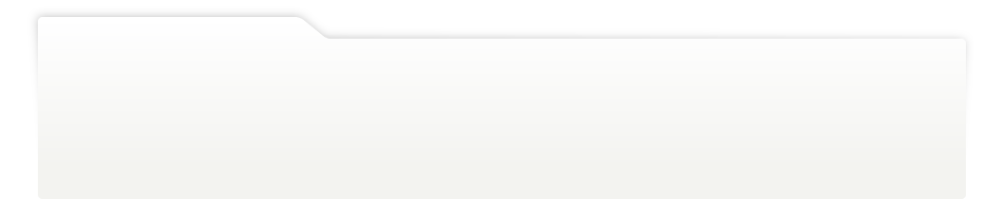
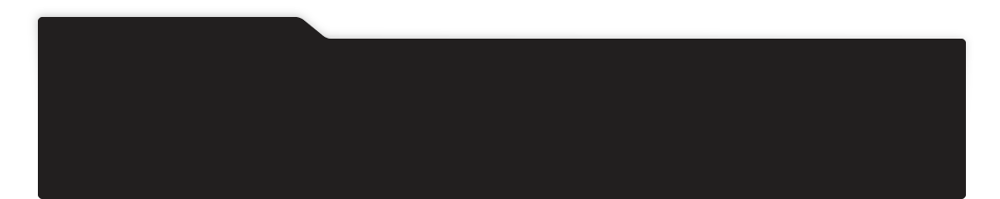
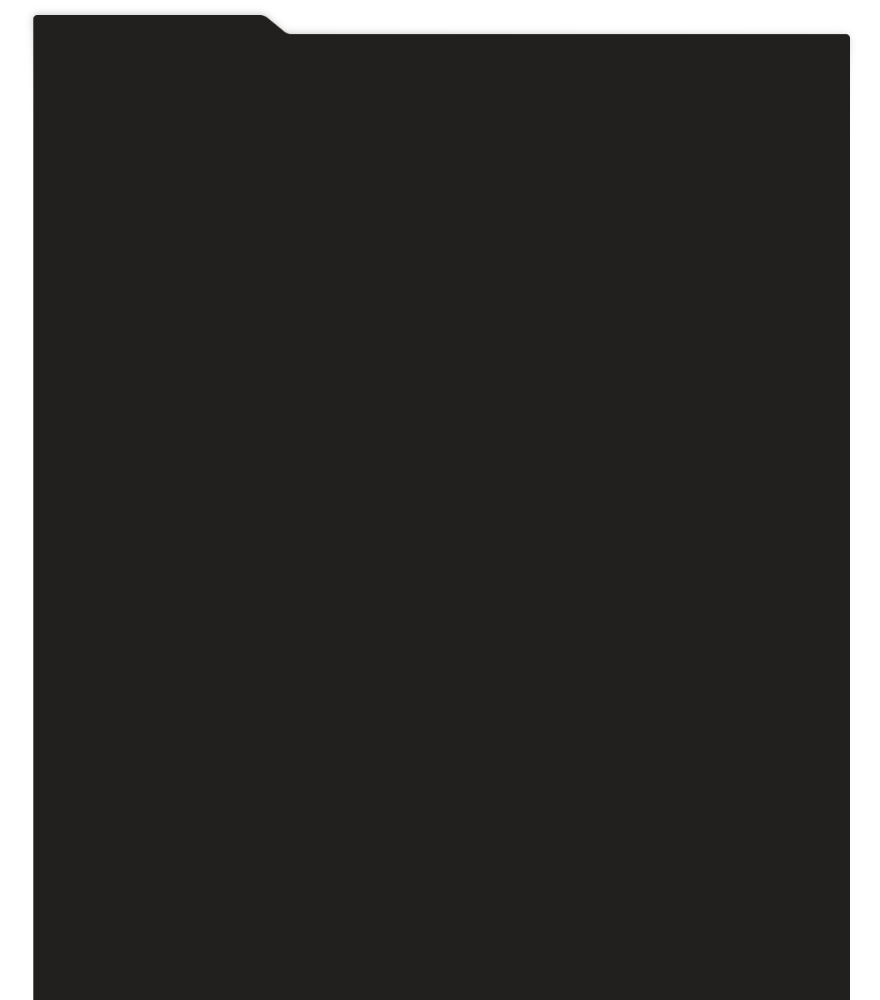
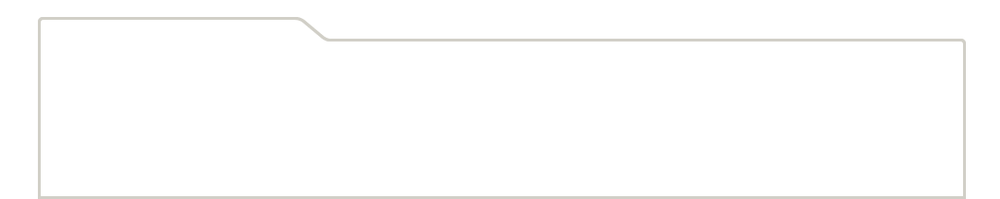
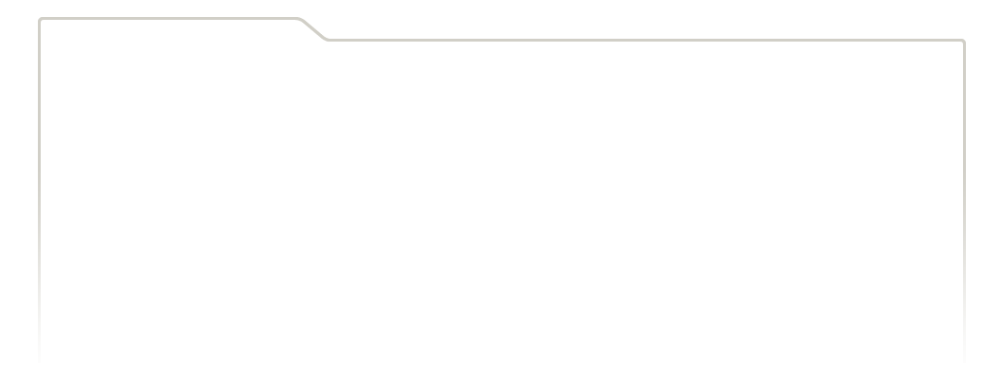
...
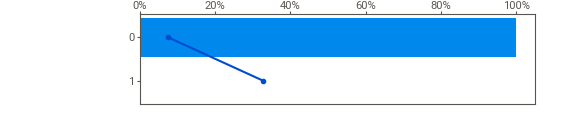
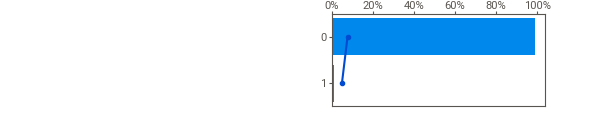
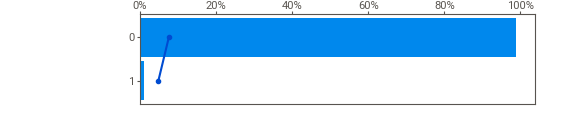
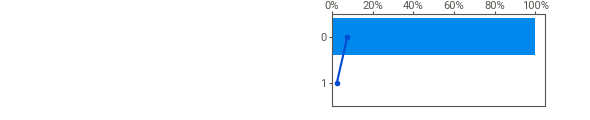
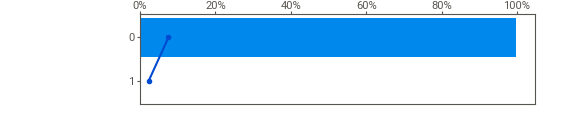

In [61]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_training_1 = sweetviz.analyze(
            [loans_eda, "Training data"],
            target_feat="loan_status",
            pairwise_analysis="off",
        )
        report_training_1.show_notebook()

</details>


::: {.content-hidden when-format="html"}

`</details>` 
End of the collapsible section

---

:::

In [62]:
# | label: tbl-num-loan-applications
# | tbl-cap: 'Percentage of accepted loans by year.'
# | code-summary: Code of the table
# | code-fold: false

crosstab_status_by_year = an.CrossTab("year", "loan_status", data=loans_eda)
crosstab_status_by_year().assign(
    percent_accepted=lambda df: df[1] / (df[1] + df[0]) * 100
)

loan_status,0,1,percent_accepted
year,,,
2007,401,46,10.29
2008,1833,189,9.35
2009,3954,351,8.15
2010,7859,876,10.03
2011,15226,1491,8.92
2012,23612,3722,13.62
2013,52973,9283,14.91
2014,134360,16686,11.05
2015,199956,29476,12.85


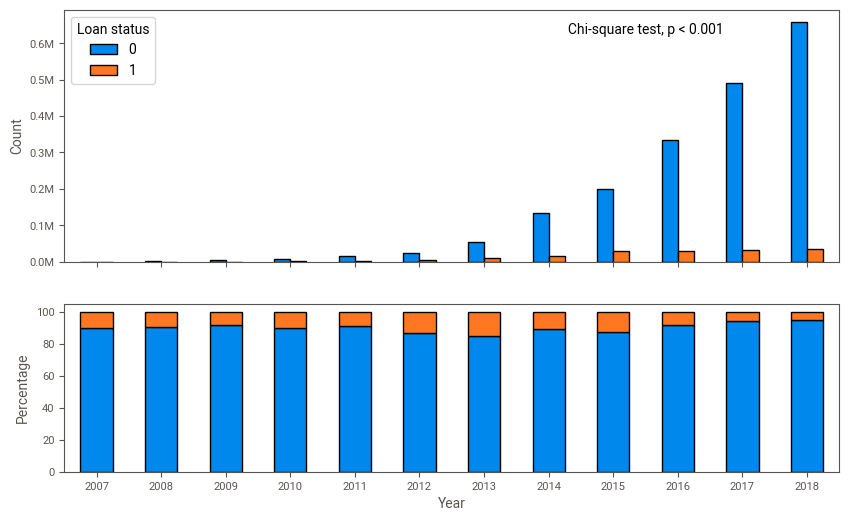

In [63]:
# | label: fig-num-loan-applications
# | fig-cap: 'Number of loan applications by year.'
# | code-summary: Code of the figure
# | code-fold: false

fig, ax = plt.subplots(
    2, 1, figsize=(10, 6), sharex=True, gridspec_kw={"height_ratios": [3, 2]}
)

crosstab_status_by_year.barplot(ax=ax[0])
crosstab_status_by_year.barplot(normalize="rows", stacked=True, xlabel="Year", ax=ax[1])

# Get the limits of the x-axis and y-axis
xlim = ax[0].get_xlim()
ylim = ax[0].get_ylim()
# Set the position of the annotation
x_pos = xlim[1] - 0.25 * (xlim[1] - xlim[0])  # 25% offset from the right edge
y_pos = ylim[1] - 0.05 * (ylim[1] - ylim[0])  # 5% offset from the top edge

chi_sq_res_1 = crosstab_status_by_year.chisq_test("short")

ax[0].annotate(
    chi_sq_res_1.capitalize(),
    xy=(x_pos, y_pos),
    xycoords="data",
    ha="center",
    va="top",
)
ax[0].yaxis.set_major_formatter(axis_formatter("M", precision=1))
ax[0].get_legend().set_title("Loan status")
ax[1].get_legend().remove()

The next EDA plots and tables will be used to compare distributions of variables over the years. In a few cases, monthly trends will also be explored.

::: {.content-hidden when-format="html"}

---

Start of the collapsible section 
`<details>`

:::

<details class="with-border">
<summary>EDA: Financial, Risk-Related and Other Indicators </summary>

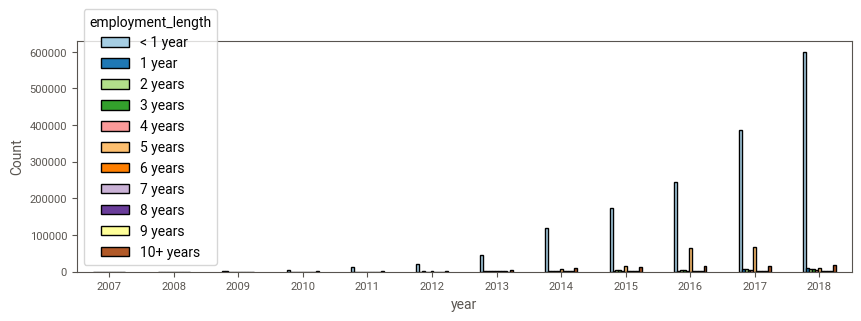

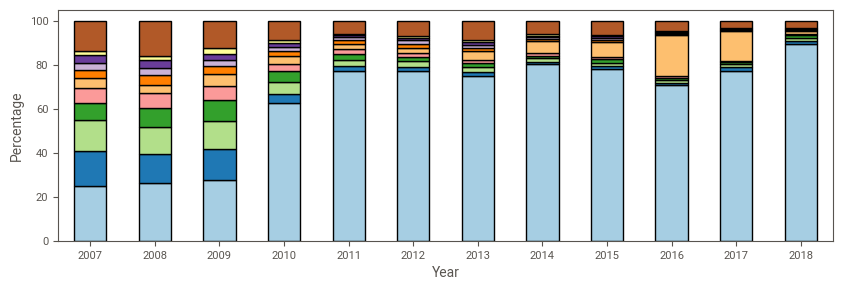

In [64]:
# | code-summary: Code
# | code-fold: false

ct = an.CrossTab("year", "employment_length", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

With "< 1 year" group removed:

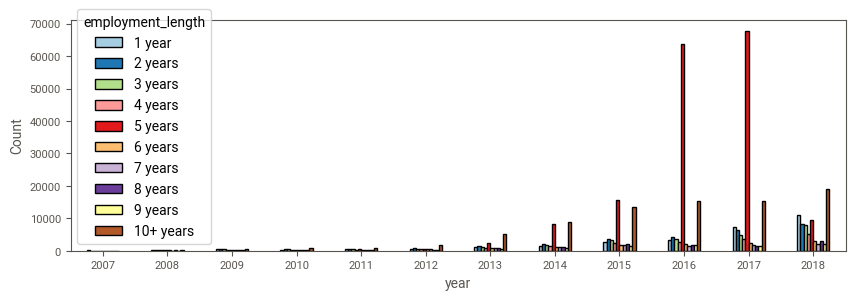

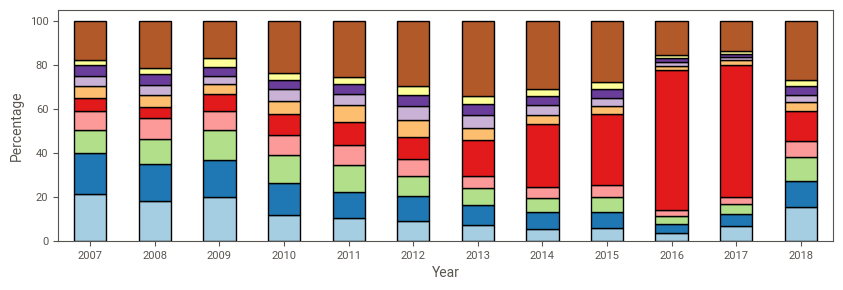

In [65]:
# | label: fig-employment-length-by-year
# | fig-cap: 'Employment length by year.'
# | fig-subcap:
# | - Counts
# | - Percentages
# | code-summary: Code of the figure
# | code-fold: false

ct = an.CrossTab(
    "year", "employment_length", data=loans_eda.query("employment_length != '< 1 year'")
)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

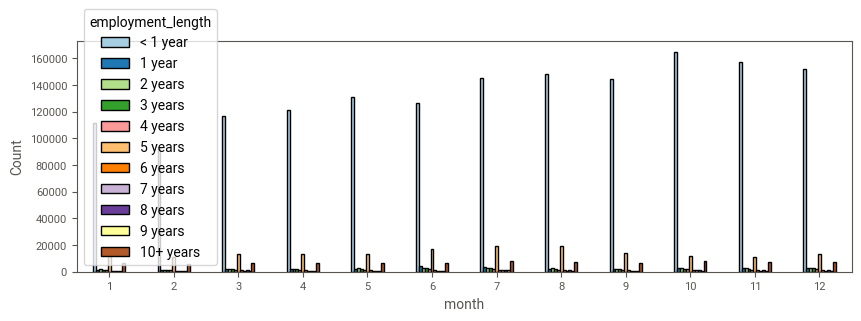

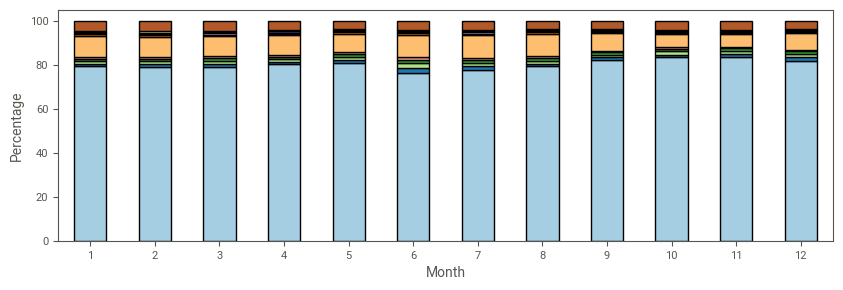

In [66]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("month", "employment_length", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Month", legend=False, colormap="Paired"
)

del ct

With "< 1 year" group removed:

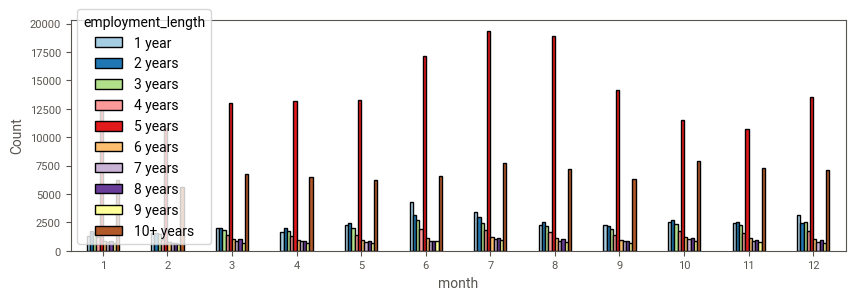

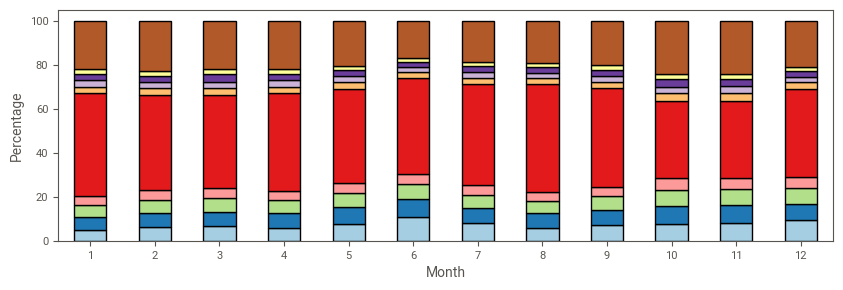

In [67]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab(
    "month",
    "employment_length",
    data=loans_eda.query("employment_length != '< 1 year'"),
)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Month", legend=False, colormap="Paired"
)

del ct

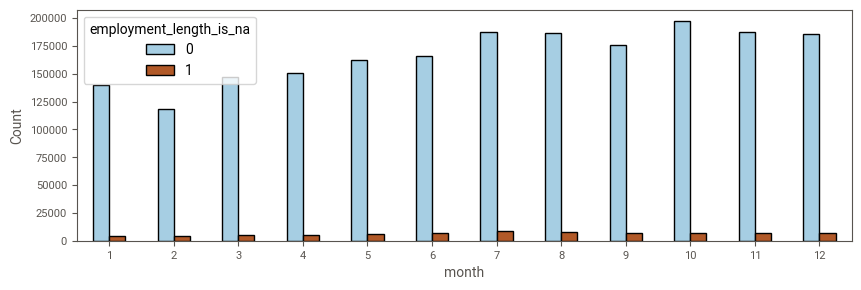

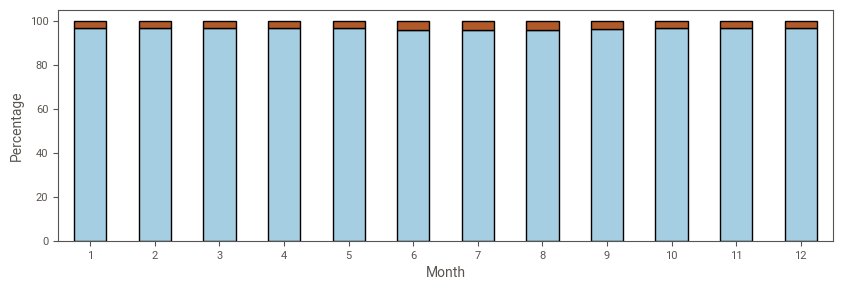

In [68]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("month", "employment_length_is_na", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Month", legend=False, colormap="Paired"
)
del ct

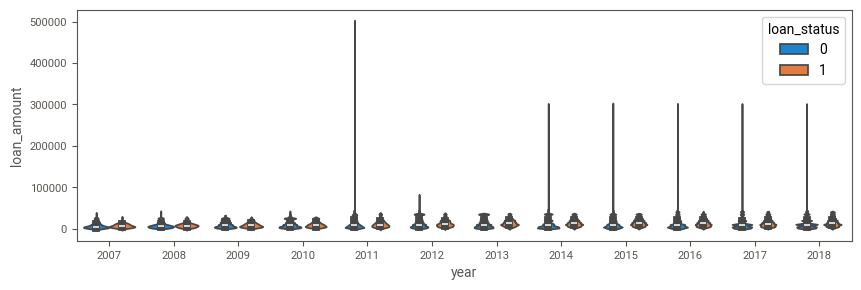

In [69]:
# | code-summary: Code
# | code-fold: false
sns.violinplot(x="year", y="loan_amount", hue="loan_status", data=loans_eda);

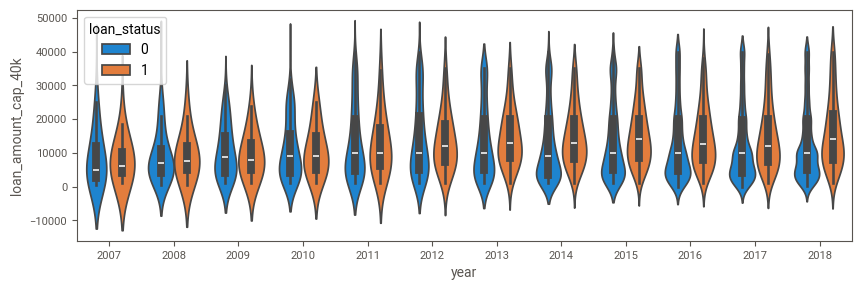

In [70]:
# | code-summary: Code
# | code-fold: false
sns.violinplot(
    x="year", y="loan_amount_cap_40k", hue="loan_status", data=loans_eda, bw_adjust=3
);

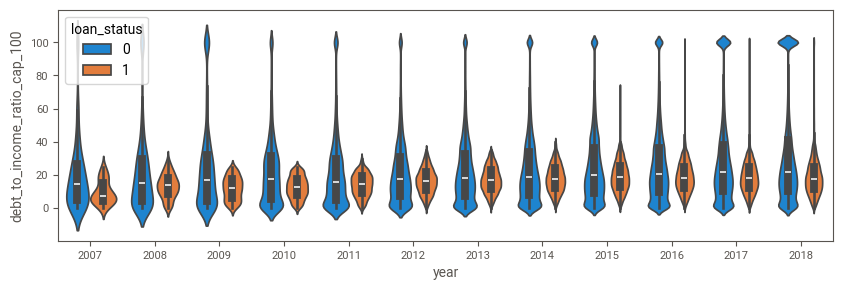

In [71]:
# | code-summary: Code
# | code-fold: false
sns.violinplot(
    x="year", y="debt_to_income_ratio_cap_100", hue="loan_status", data=loans_eda
);

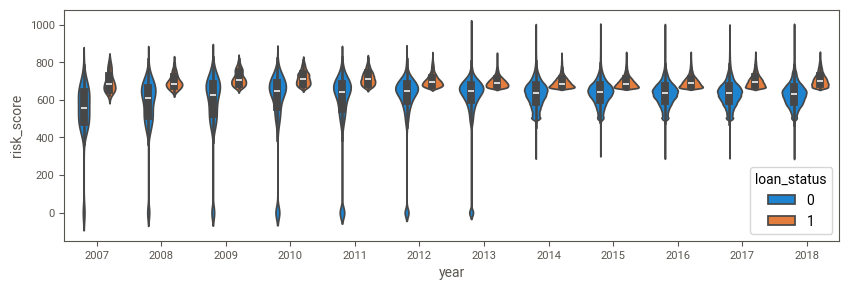

In [72]:
# | code-summary: Code
# | code-fold: false
sns.violinplot(x="year", y="risk_score", hue="loan_status", data=loans_eda);

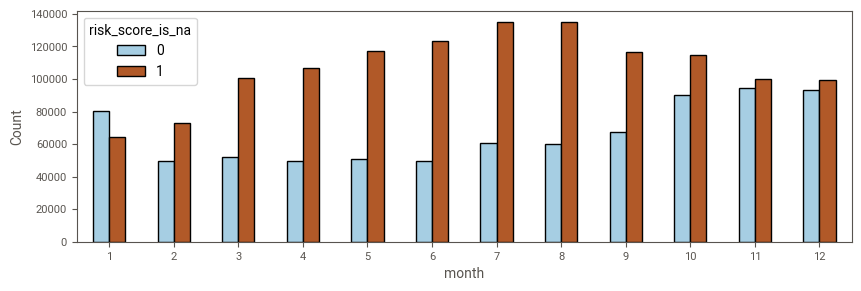

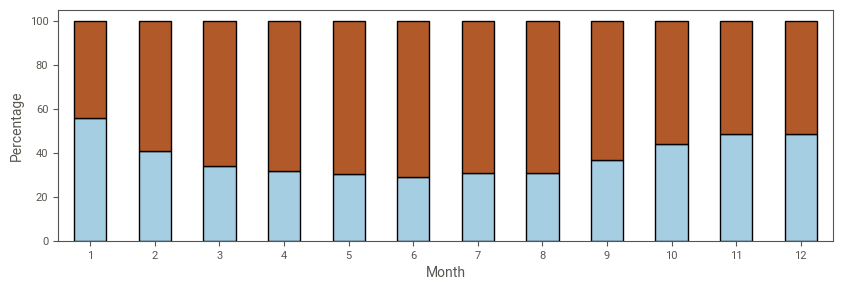

In [73]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("month", "risk_score_is_na", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Month", legend=False, colormap="Paired"
)
del ct

</details>


::: {.content-hidden when-format="html"}

`</details>` 
End of the collapsible section

---

:::

::: {.content-hidden when-format="html"}

---

Start of the collapsible section 
`<details>`

:::

<details class="with-border">
<summary>EDA: Title Properties</summary>

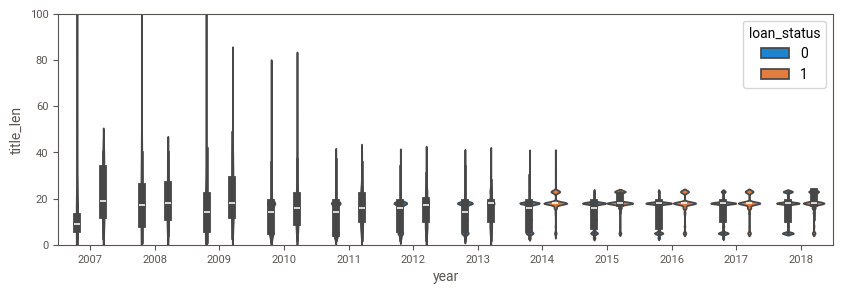

In [74]:
# | code-summary: Code
# | code-fold: false
x = "year"
y = "title_len"
hue = "loan_status"

data = loans_eda[[x, y, hue]].dropna()
sns.violinplot(x=x, y=y, hue=hue, data=data)
plt.gca().set_ylim(0, 100)

del x, y, hue, data

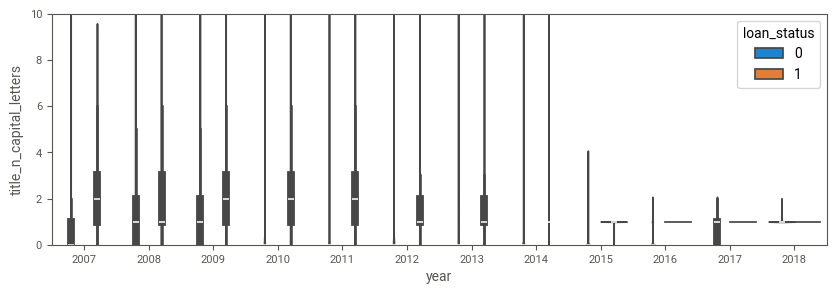

In [75]:
# | code-summary: Code
# | code-fold: false
x = "year"
y = "title_n_capital_letters"
hue = "loan_status"

data = loans_eda[[x, y, hue]].dropna()
sns.violinplot(x=x, y=y, hue=hue, data=data)
plt.gca().set_ylim(0, 10)

del x, y, hue, data

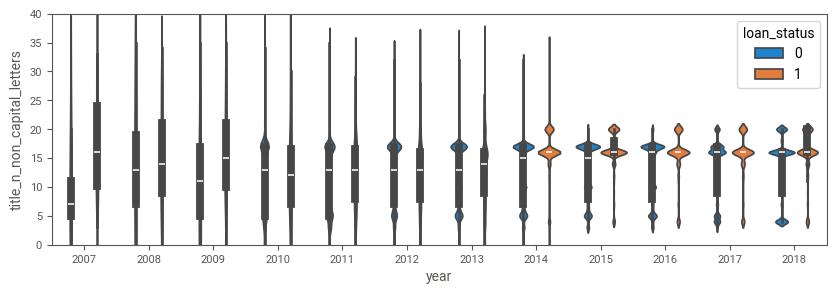

In [76]:
# | code-summary: Code
# | code-fold: false
x = "year"
y = "title_n_non_capital_letters"
hue = "loan_status"

data = loans_eda[[x, y, hue]].dropna()
sns.violinplot(x=x, y=y, hue=hue, data=data)
plt.gca().set_ylim(0, 40)

del x, y, hue, data

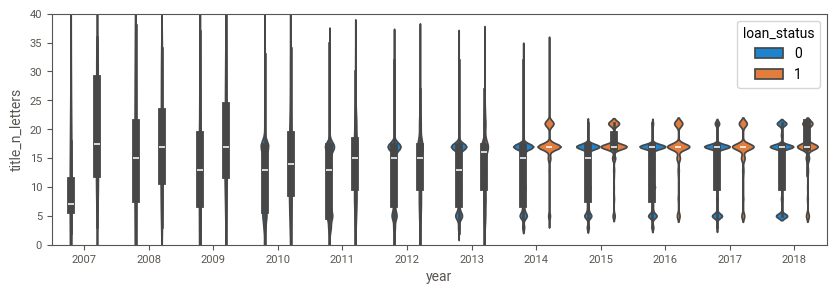

In [77]:
# | code-summary: Code
# | code-fold: false
x = "year"
y = "title_n_letters"
hue = "loan_status"

data = loans_eda[[x, y, hue]].dropna()
sns.violinplot(x=x, y=y, hue=hue, data=data)
plt.gca().set_ylim(0, 40)

del x, y, hue, data

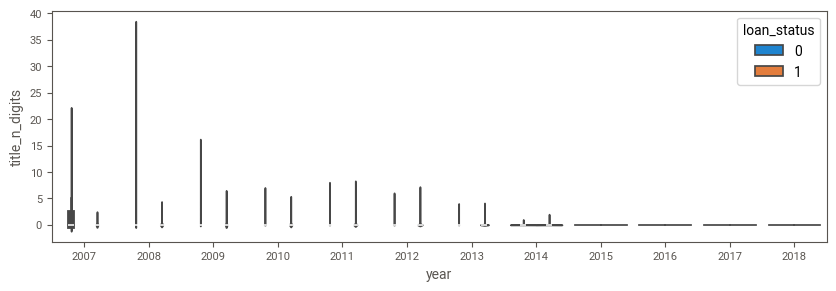

In [78]:
# | code-summary: Code
# | code-fold: false
x = "year"
y = "title_n_digits"
hue = "loan_status"

data = loans_eda[[x, y, hue]].dropna()
sns.violinplot(x=x, y=y, hue=hue, data=data)

del x, y, hue, data

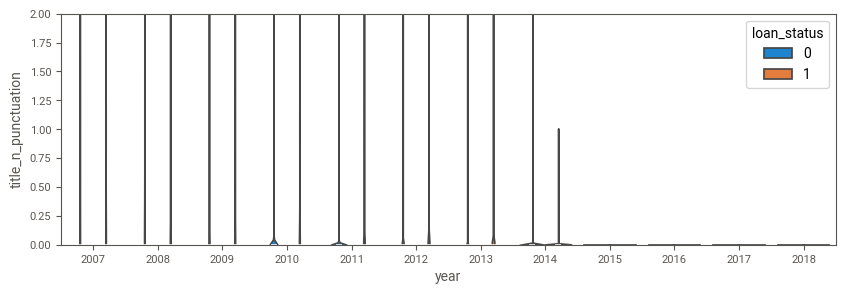

In [79]:
# | code-summary: Code
# | code-fold: false
x = "year"
y = "title_n_punctuation"
hue = "loan_status"

data = loans_eda[[x, y, hue]].dropna()
sns.violinplot(x=x, y=y, hue=hue, data=data)
plt.gca().set_ylim(0, 2)

del x, y, hue, data

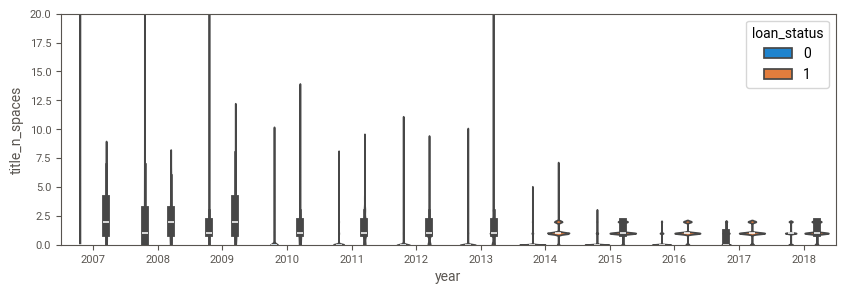

In [80]:
# | code-summary: Code
# | code-fold: false
x = "year"
y = "title_n_spaces"
hue = "loan_status"

data = loans_eda[[x, y, hue]].dropna()
sns.violinplot(x=x, y=y, hue=hue, data=data)
plt.gca().set_ylim(0, 20)

del x, y, hue, data

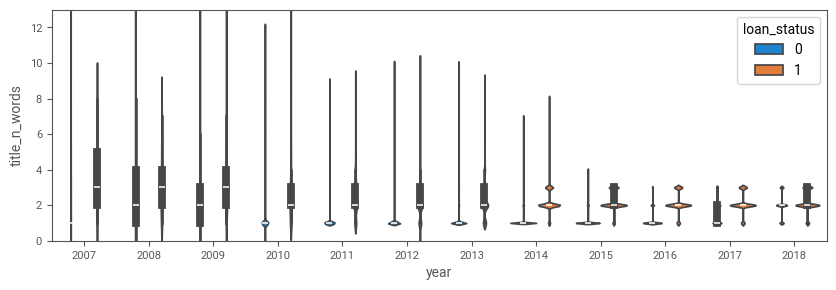

In [81]:
# | code-summary: Code
# | code-fold: false
x = "year"
y = "title_n_words"
hue = "loan_status"

data = loans_eda[[x, y, hue]].dropna()
sns.violinplot(x=x, y=y, hue=hue, data=data)
plt.gca().set_ylim(0, 13)

del x, y, hue, data

It seems that loan title got standardized in 2018, as all-lower-case titles are not present in 2018:

year,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
title_in_lower_case,,,,,,,,,,,,
0,156,1378,3031,1368,2055,4141,10775,26229,48439,92373,319514,694223
1,291,644,1273,7366,14662,23193,51481,124817,180984,269479,202926,0


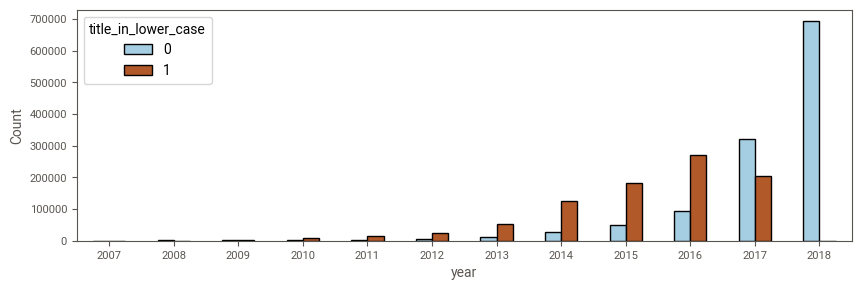

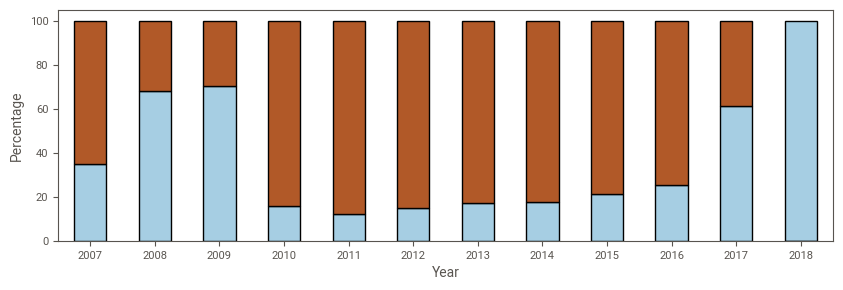

In [82]:
# | label: fig-title-in-lower-case
# | tbl-cap: 'Number of loan titles in lower case by year.'
# | fig-cap: 'Number of loan titles in lower case by year.'
# | fig-subcap:
# | - As table (↑)
# | - Counts
# | - Percentages
# | code-summary: Code of the figure
# | code-fold: false
ct = an.CrossTab("year", "title_in_lower_case", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
display(ct.counts.T)
del ct

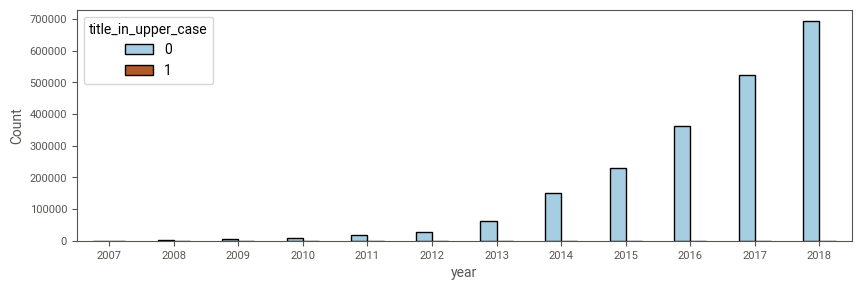

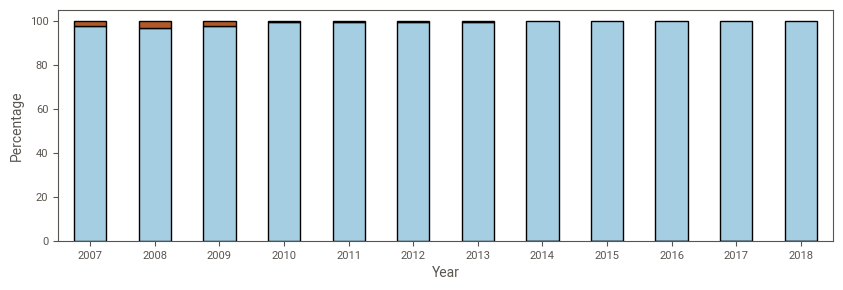

In [83]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "title_in_upper_case", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

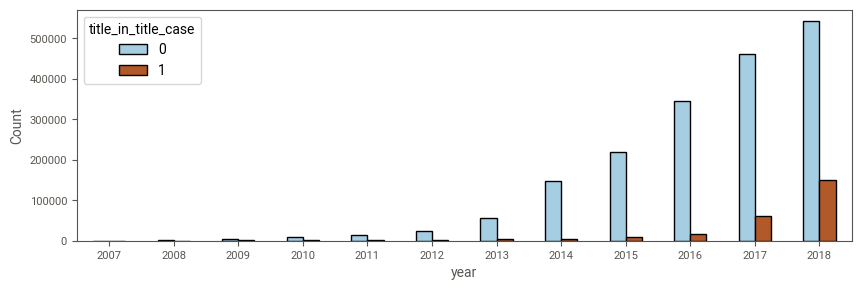

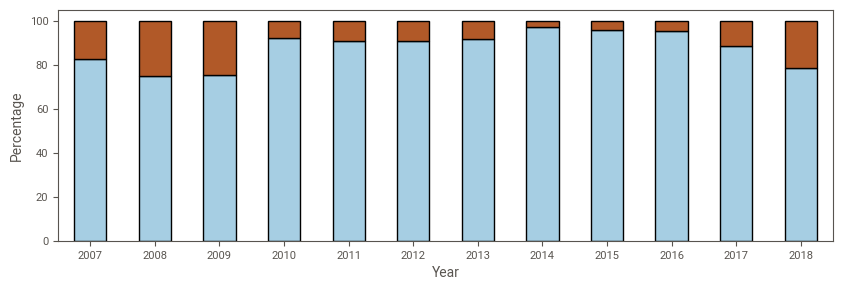

In [84]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "title_in_title_case", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

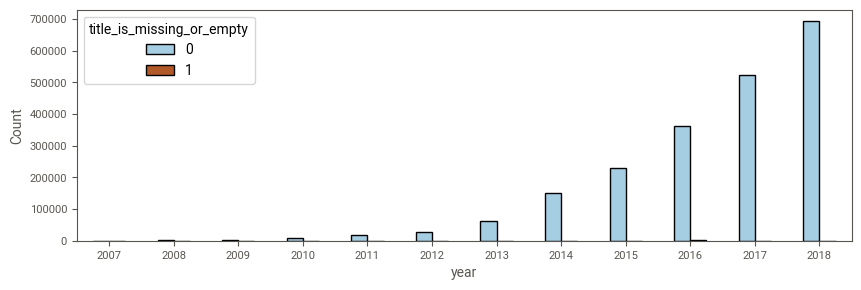

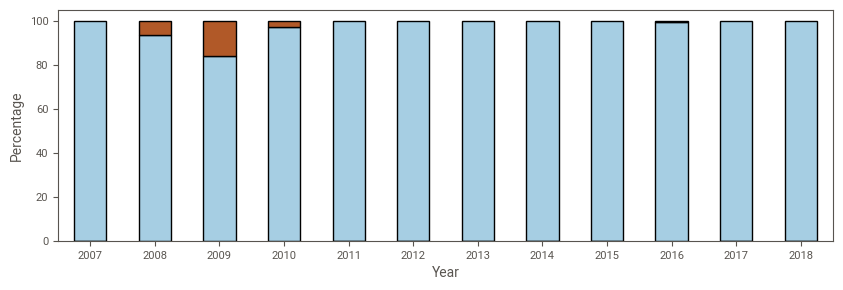

In [85]:
# | label: fig-title-is-missing-or-empty
# | tbl-cap: 'Missing or empty loan titles by year.'
# | fig-cap: 'Missing or empty loan titles by year.'
# | fig-subcap:
# | - As table (↑)
# | - Counts
# | - Percentages
# | code-summary: Code of the figure
# | code-fold: false

ct = an.CrossTab("year", "title_is_missing_or_empty", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
ct.counts.assign(percent_missing_or_empty=lambda df: df[1] / (df[1] + df[0]) * 100)
del ct

</details>


::: {.content-hidden when-format="html"}

`</details>` 
End of the collapsible section

---

:::

::: {.content-hidden when-format="html"}

---

Start of the collapsible section 
`<details>`

:::

<details class="with-border">
<summary>EDA: Title Contents (Loan Purpose) </summary>

Here, the presence of certain words, phrases, or abbreviations in the titles will be compared over the years explored.

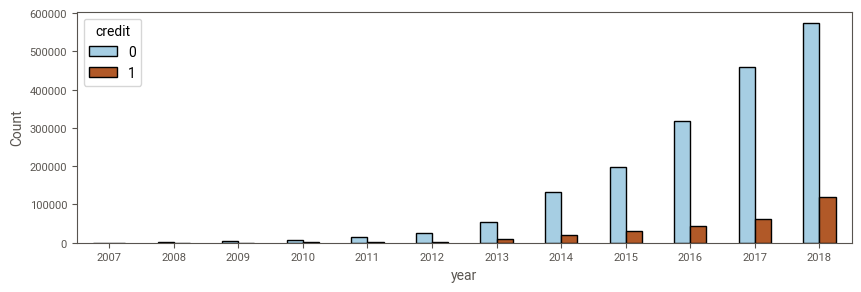

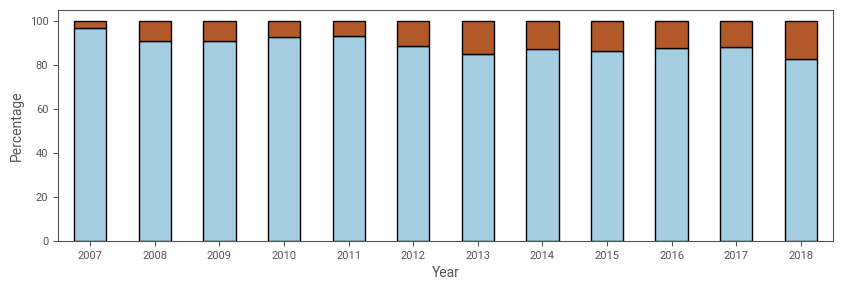

In [86]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "credit", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

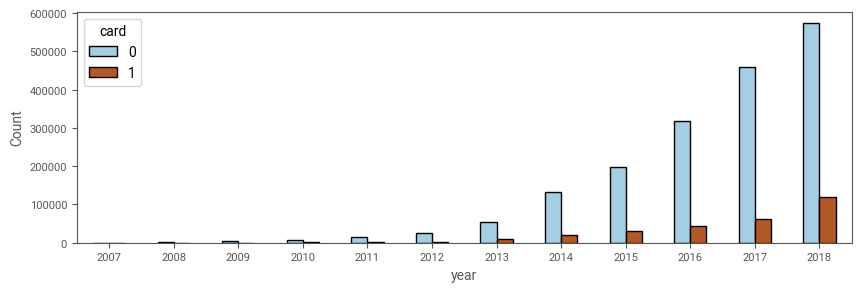

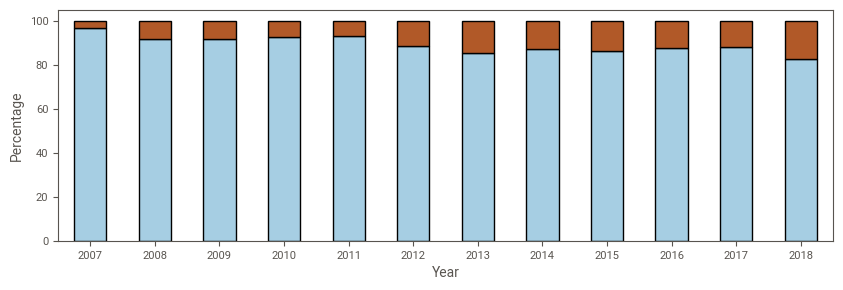

In [87]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "card", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

Refinancing cases seem to increase in 2018.

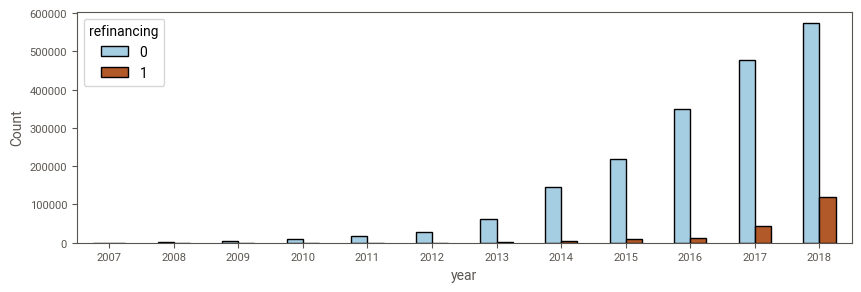

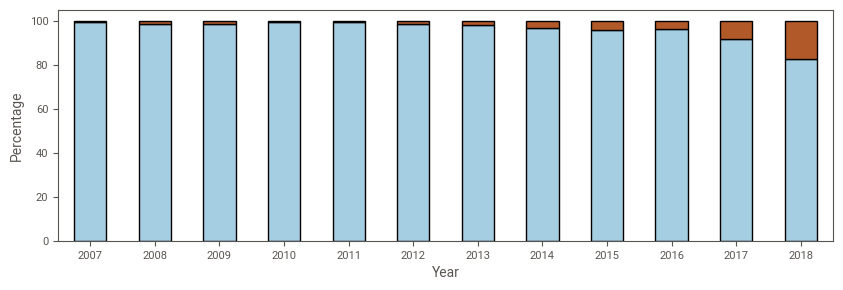

In [88]:
# | label: fig-refinancing
# | fig-cap: 'Number of loan titles related to refinancing by year.'
# | fig-subcap:
# | - Counts
# | - Percentages
# | code-summary: Code of the figure
# | code-fold: false

ct = an.CrossTab("year", "refinancing", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

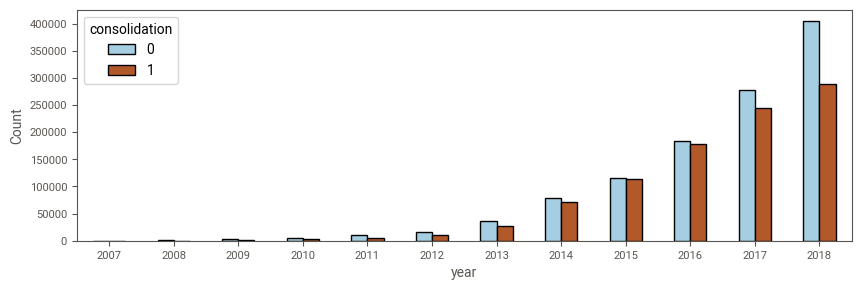

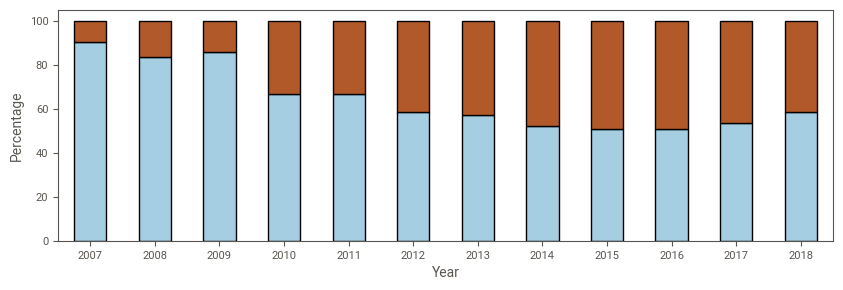

In [89]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "consolidation", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

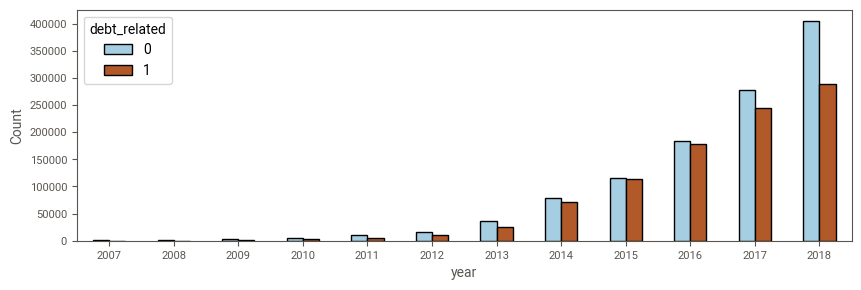

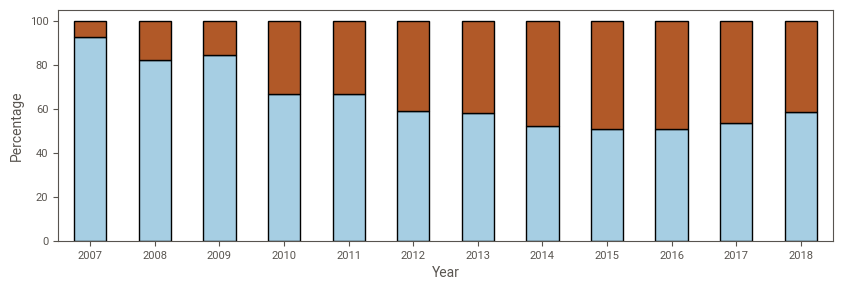

In [90]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "debt_related", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

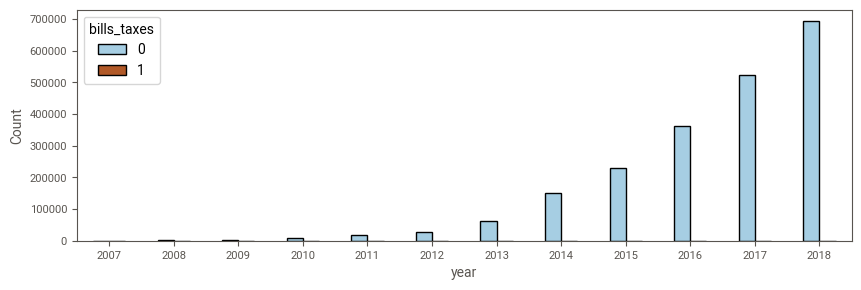

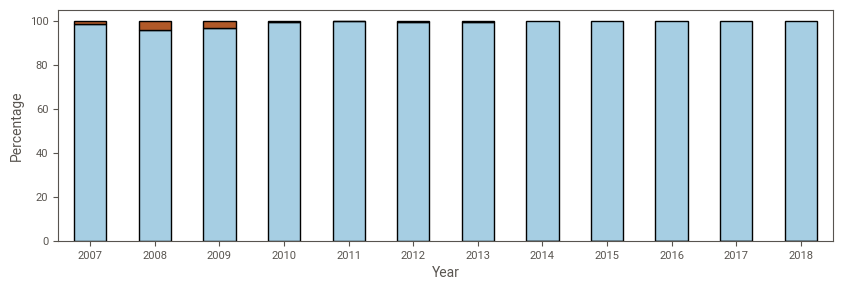

In [91]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "bills_taxes", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

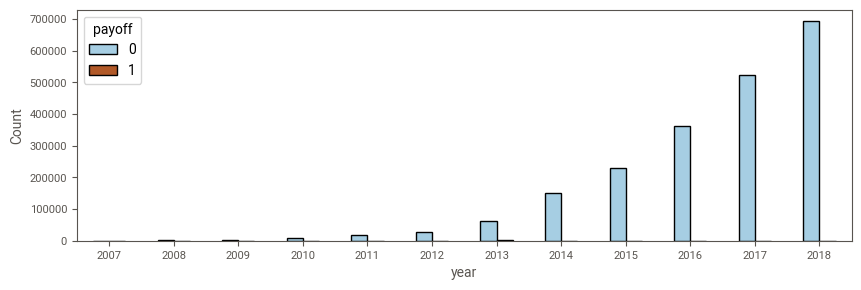

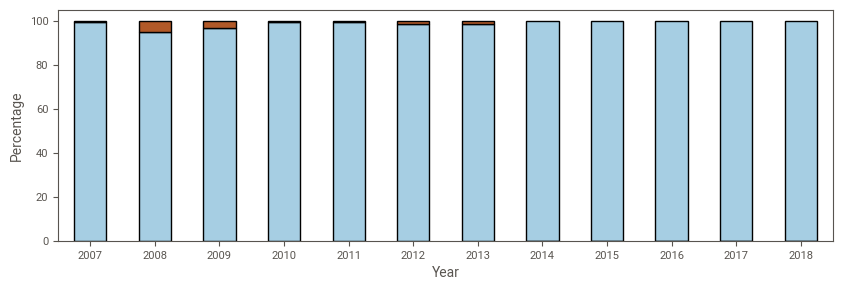

In [92]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "payoff", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

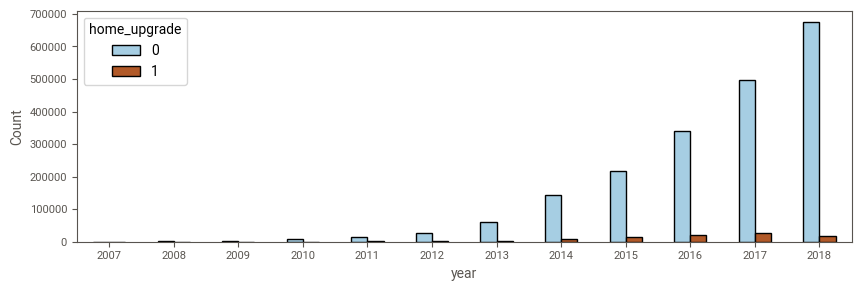

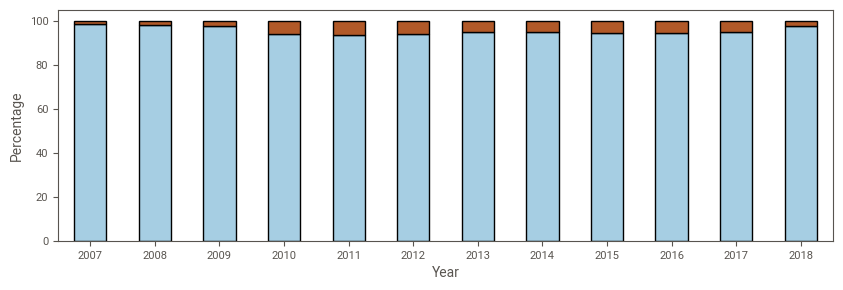

In [93]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "home_upgrade", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

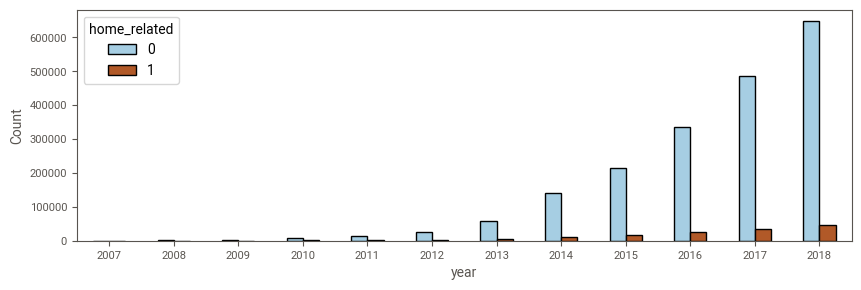

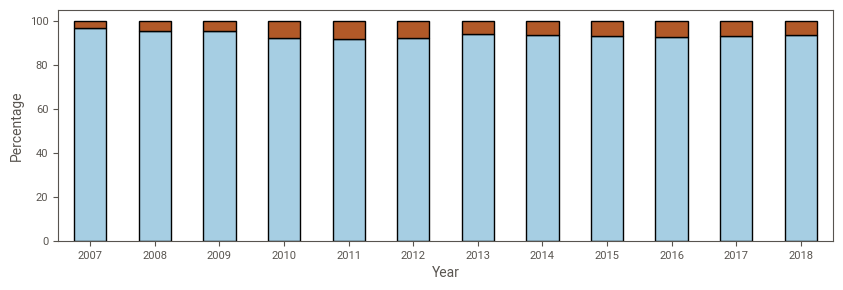

In [94]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "home_related", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

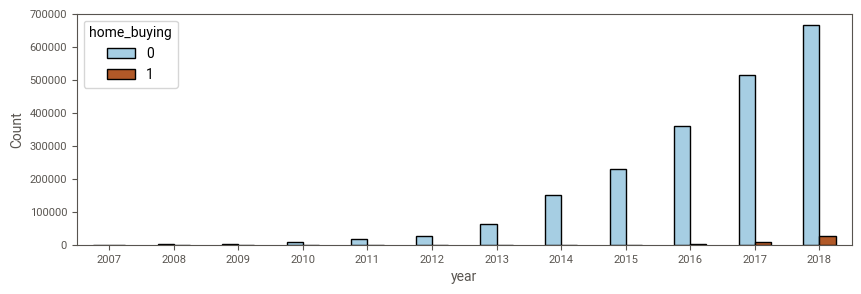

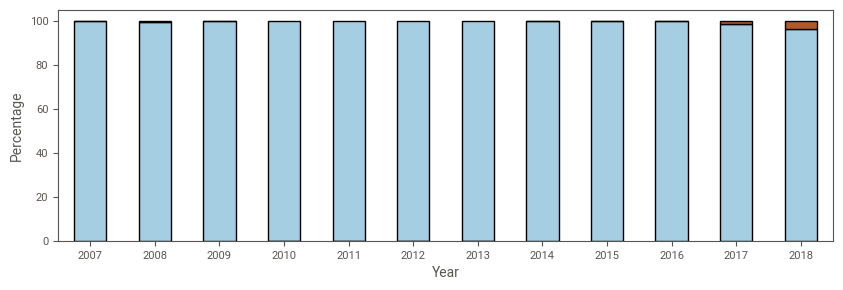

In [95]:
# | label: fig-home-buying
# | fig-cap: 'Number of loan titles related to home buying by year.'
# | fig-subcap:
# | - Counts
# | - Percentages
# | code-summary: Code of the figure
# | code-fold: false

ct = an.CrossTab("year", "home_buying", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

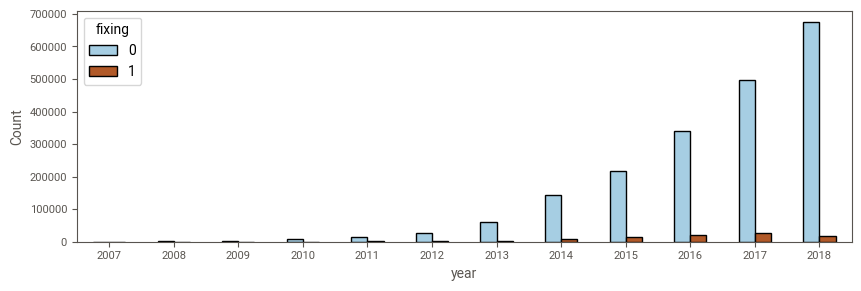

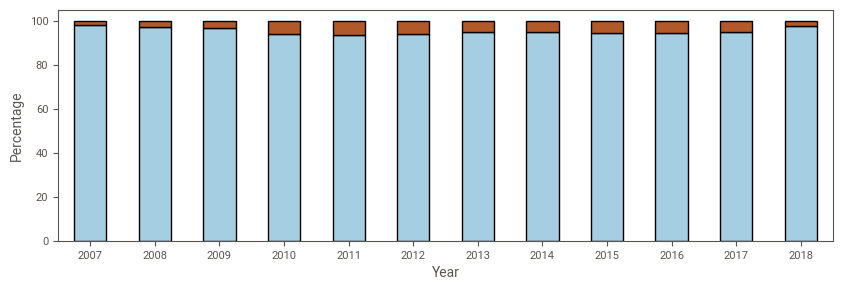

In [96]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "fixing", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

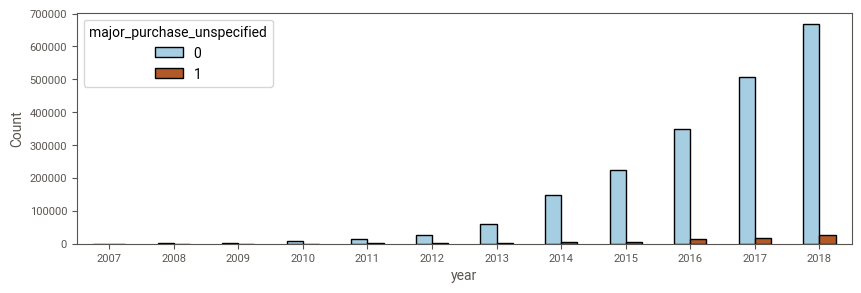

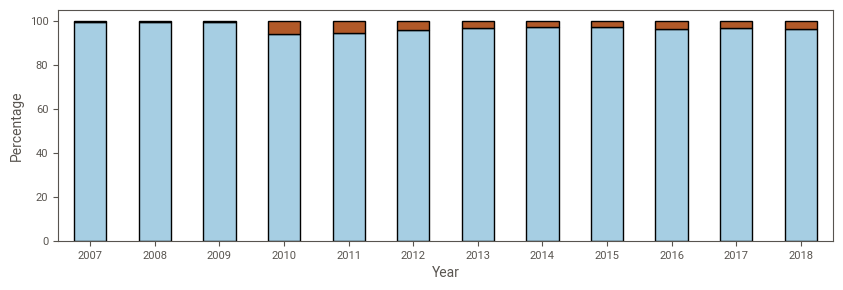

In [97]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "major_purchase_unspecified", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

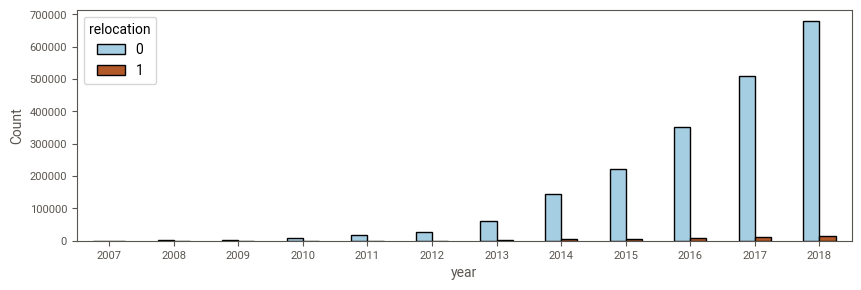

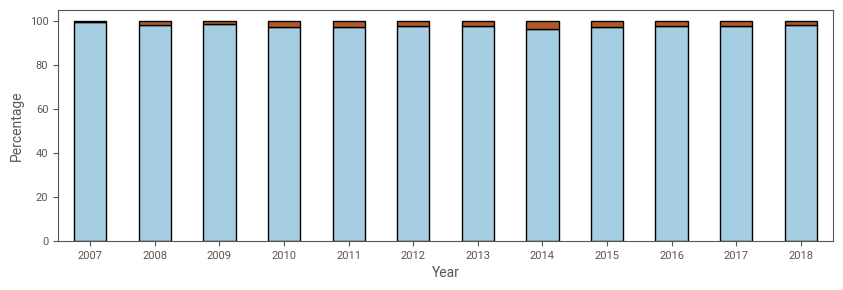

In [98]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "relocation", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

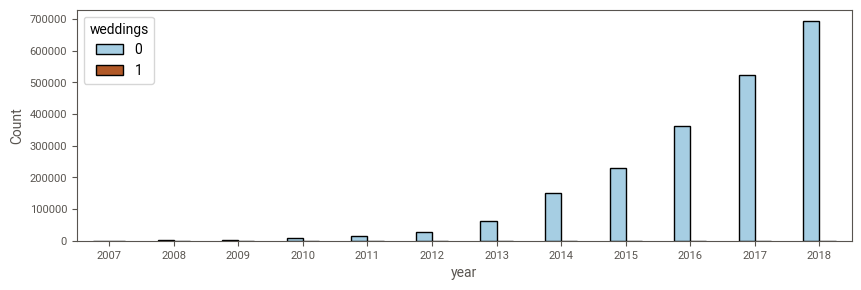

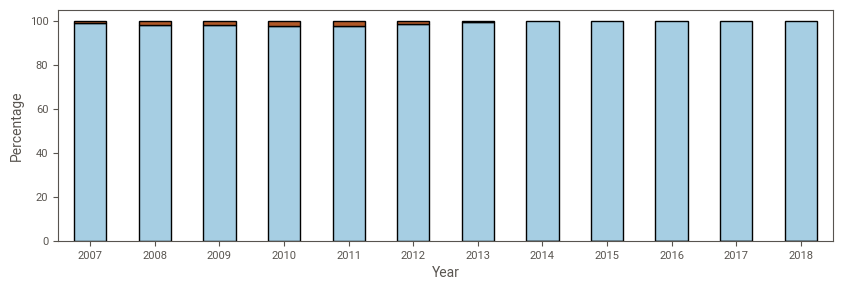

In [99]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "weddings", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

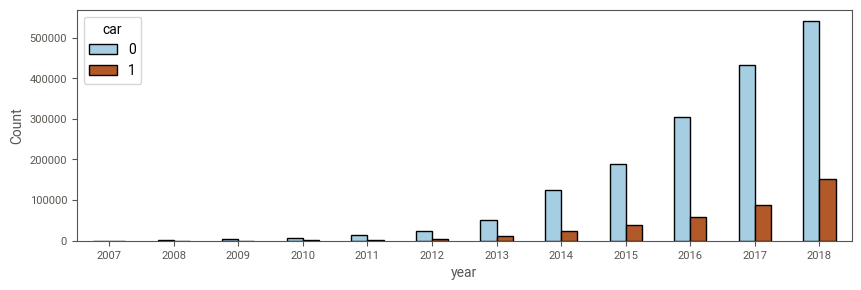

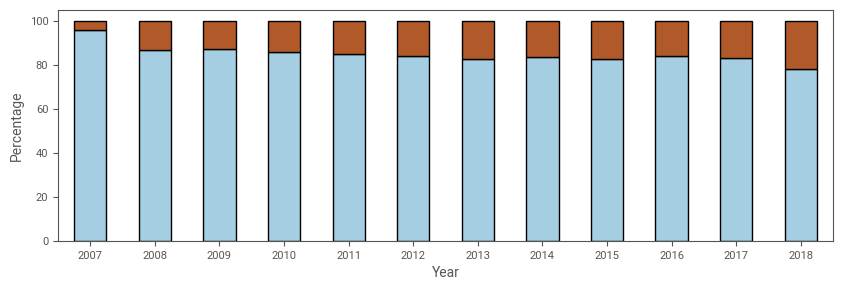

In [100]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "car", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

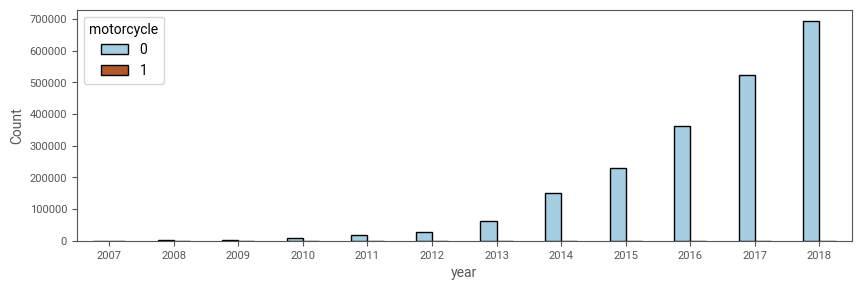

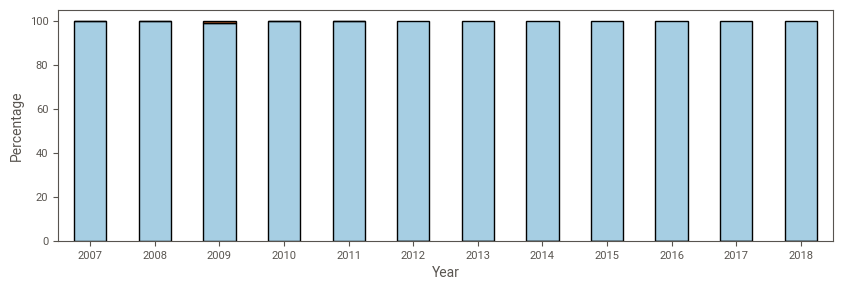

In [101]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "motorcycle", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

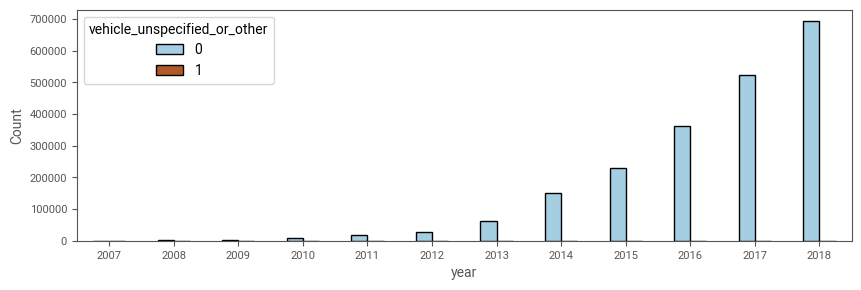

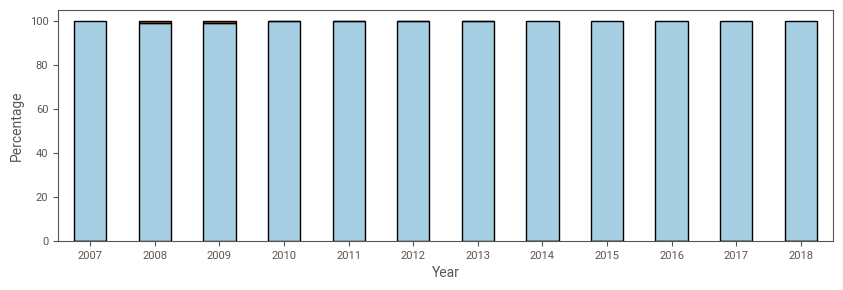

In [102]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "vehicle_unspecified_or_other", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

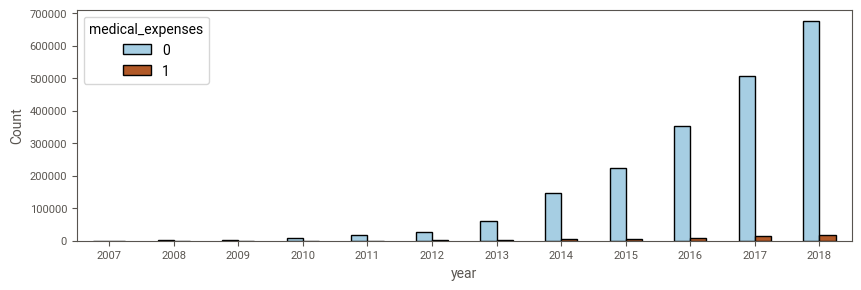

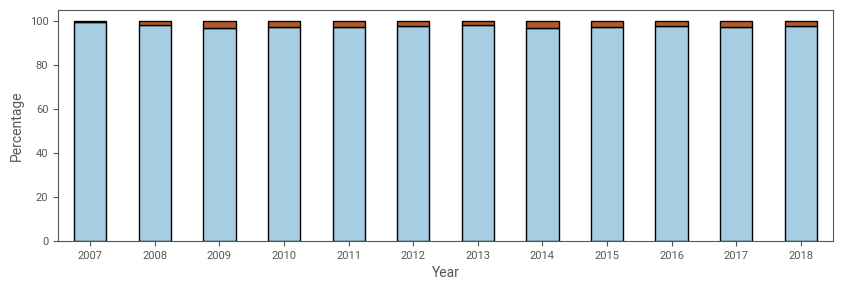

In [103]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "medical_expenses", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

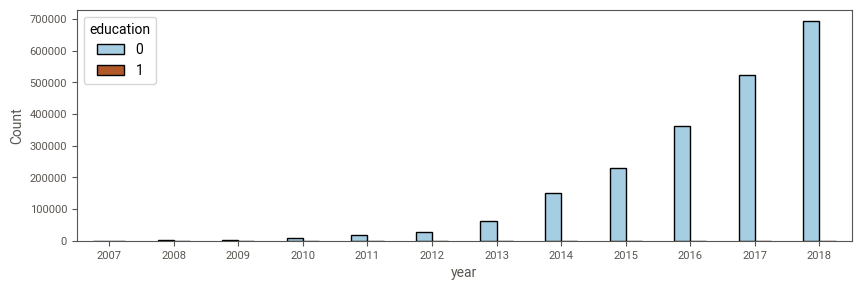

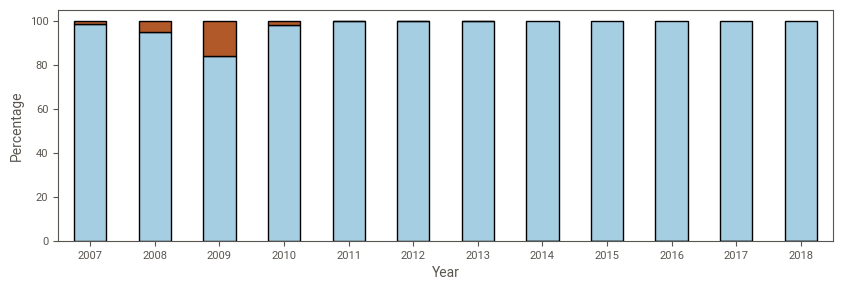

In [104]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "education", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

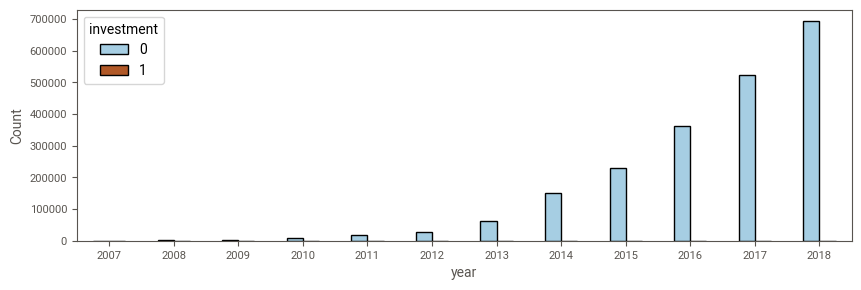

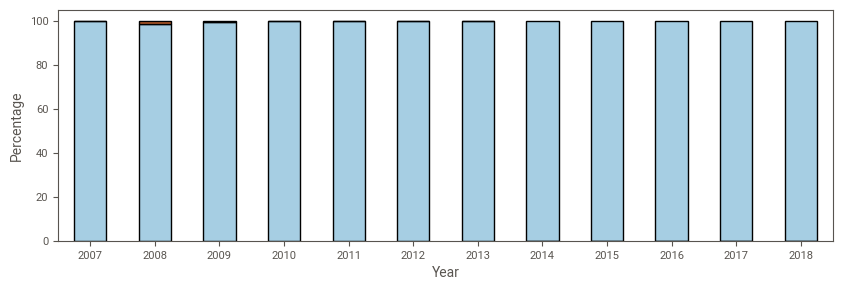

In [105]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "investment", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

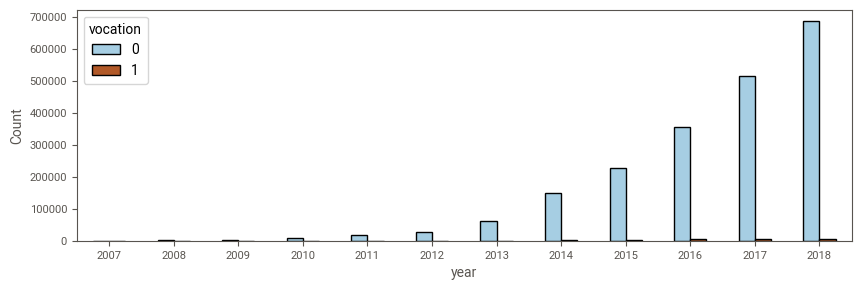

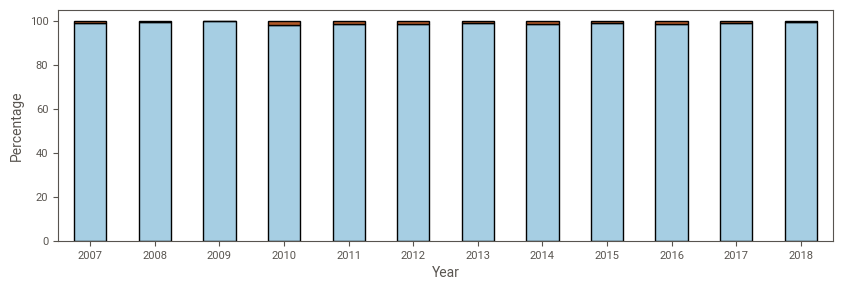

In [106]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "vocation", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

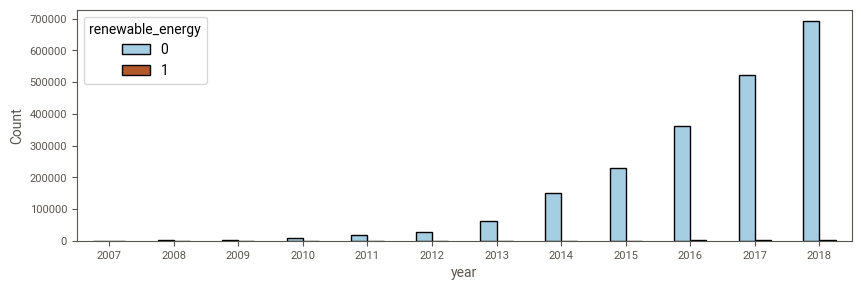

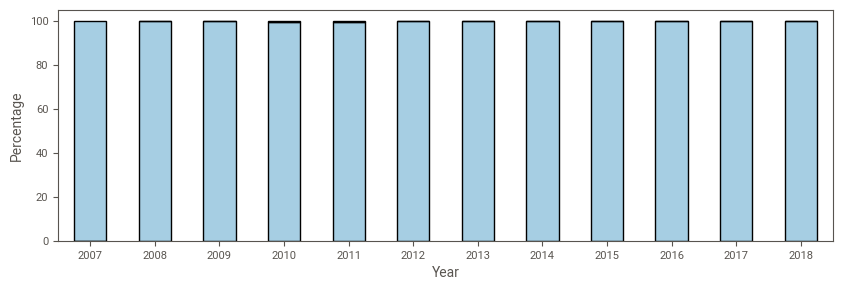

In [107]:
# | code-summary: Code
# | code-fold: false
ct = an.CrossTab("year", "renewable_energy", data=loans_eda)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Year", legend=False, colormap="Paired"
)
del ct

</details>


::: {.content-hidden when-format="html"}

`</details>` 
End of the collapsible section

---

:::

## EDA of Most Recent Year (2018)

Based on the EDA of all years, I decided to focus the analysis only on data from the most recent year (2018).

### General EDA

There are 694.2 thousand cases in the EDA subset.
The general EDA suggested that the following variables can be excluded:

- as irrelevant:
    - date
    - year
    - policy_code
    - debt_to_income_ratio_is_na_original (created for EDA only)
    - debt_to_income_ratio_orig_cap_100   (created for EDA only)
    - debt_to_income_ratio_original       (created for EDA only)
- constant:
    - zip_code_is_na
    - title_is_missing_or_empty
    - title_n_digits
    - title_n_punctuation
    - title_in_upper_case
    - title_in_lower_case
    - bills_taxes
    - payoff
    - weddings
    - motorcycle
    - vehicle_unspecified_or_other
    - investment
- almost constant:
    - education
    - debt_to_income_ratio_is_na	
    - renewable_energy

Find the details below.

In [55]:
file_path = dir_interim + "task-1-loans_eda.feather"

if os.path.exists(file_path):
    # Load from file, if present.
    loans_eda = pd.read_feather(file_path)

In [56]:
loans_eda_2018 = loans_eda.query("year == 2018")
print(f"{loans_eda_2018.shape[0]/1e3:,.1f}k rows for year 2018")

694.2k rows for year 2018


In [109]:
loans_eda_2018.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
Index: 694223 entries, 19248942 to 12767628
Columns: 60 entries, loan_status to renewable_energy
dtypes: Int16(3), Int8(36), category(2), datetime64[ns](1), float32(18)
memory usage: 113.2 MB


In [110]:
an.col_info(loans_eda_2018, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_status,Int8,1.4 MB,2,<0.1%,0,0%,"659,144",94.9%,94.9%,0
2,policy_code,Int8,1.4 MB,3,<0.1%,0,0%,"656,360",94.5%,94.5%,0
3,date,datetime64[ns],5.6 MB,365,0.1%,0,0%,"5,781",0.8%,0.8%,2018-10-01 00:00:00
4,year,Int16,2.1 MB,1,<0.1%,0,0%,"694,223",100.0%,100.0%,2018
5,month,Int8,1.4 MB,12,<0.1%,0,0%,"66,932",9.6%,9.6%,10
6,month_sin,float32,2.8 MB,8,<0.1%,0,0%,"132,879",19.1%,19.1%,-0.8660254
7,month_cos,float32,2.8 MB,8,<0.1%,0,0%,"128,343",18.5%,18.5%,-0.8660254
8,loan_amount,float32,2.8 MB,"1,849",0.3%,0,0%,"114,672",16.5%,16.5%,10000.0
9,loan_amount_log,float32,2.8 MB,"1,849",0.3%,0,0%,"114,672",16.5%,16.5%,9.210441
10,loan_amount_cap_40k,float32,2.8 MB,"1,550",0.2%,0,0%,"114,672",16.5%,16.5%,10000.0


In [57]:
# Columns to exclude
# (loan_title and loan_title_unified are already excluded)

to_exclude_1 = str_to_list(
    """
date
year
policy_code
debt_to_income_ratio_is_na_original
debt_to_income_ratio_orig_cap_100
debt_to_income_ratio_original
zip_code_is_na
title_is_missing_or_empty
title_n_digits
title_n_punctuation
title_in_upper_case
title_in_lower_case
bills_taxes
payoff
weddings
motorcycle
vehicle_unspecified_or_other
investment
education
renewable_energy
"""
)

                                             |          | [  0%]   00:00 -> (? left)


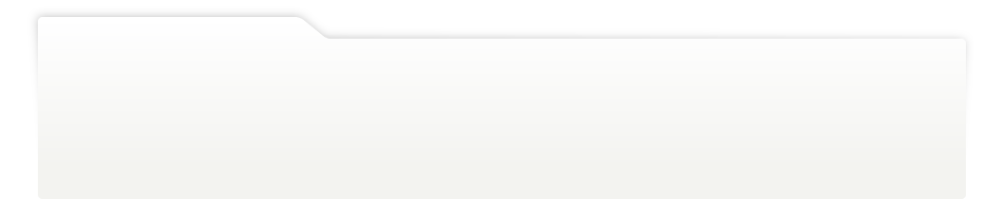
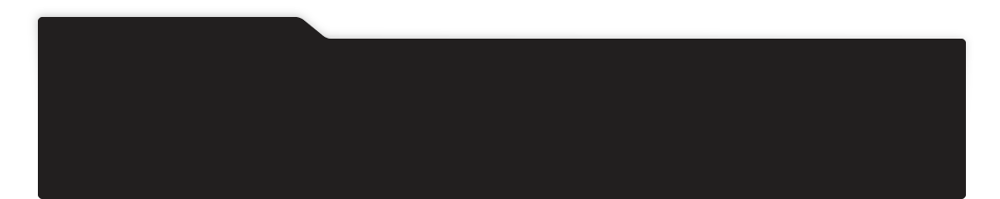
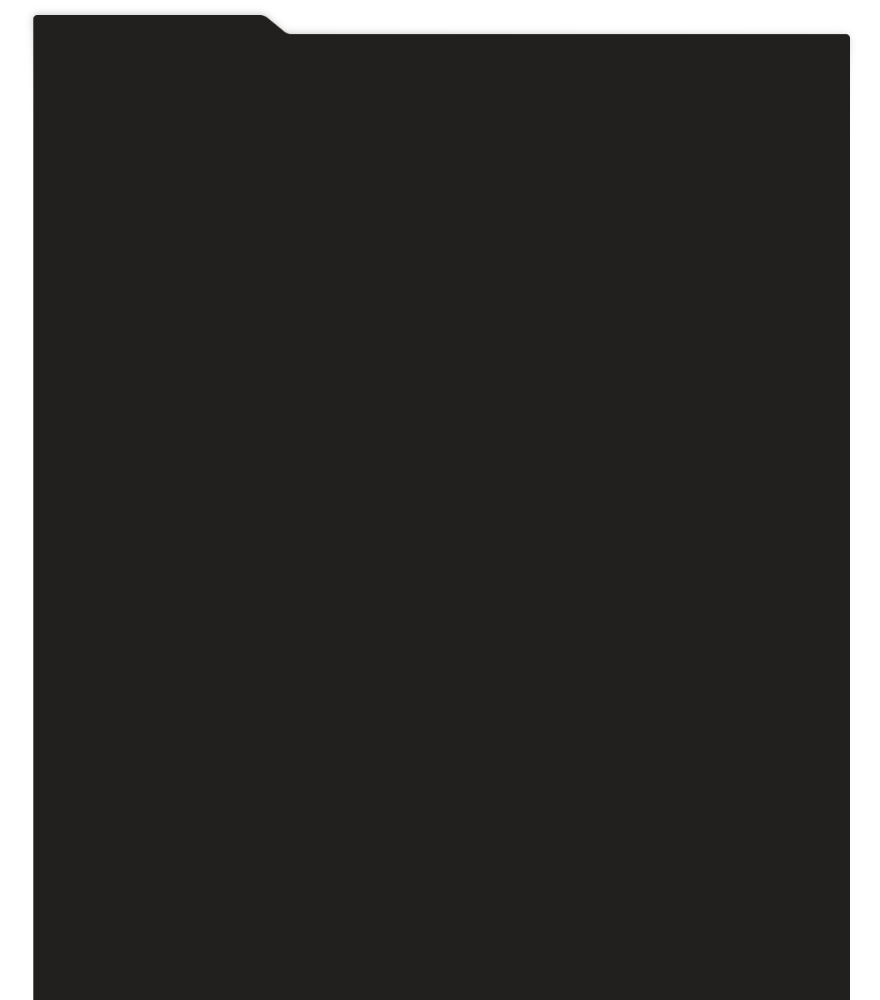
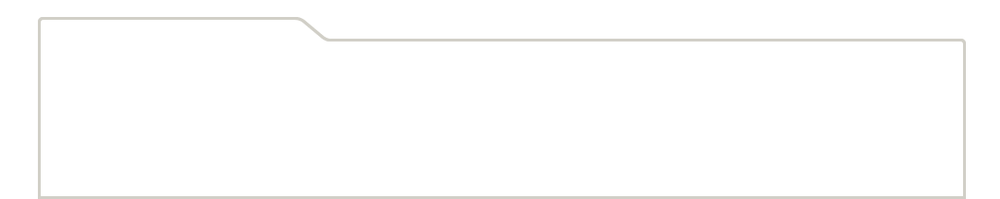
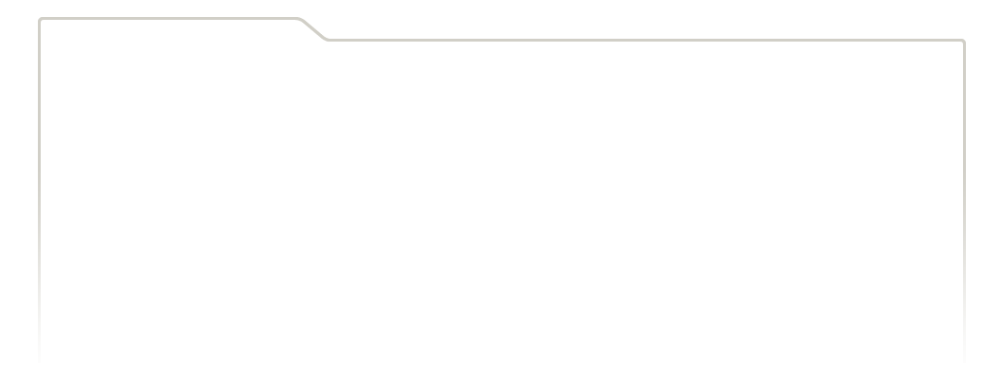
...
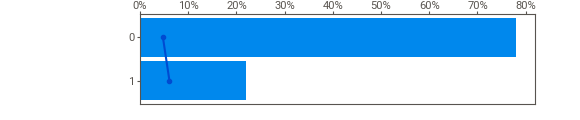
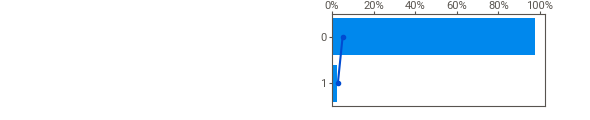
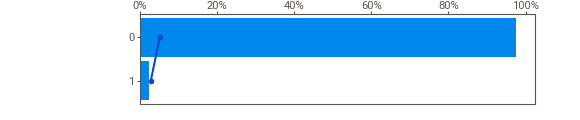
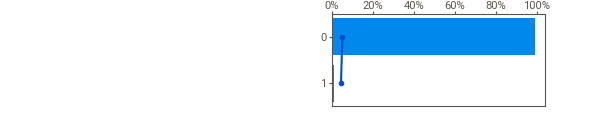
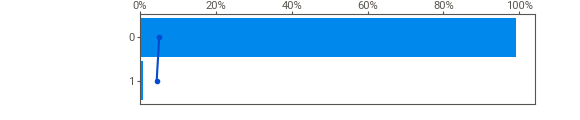

In [112]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_training_2018 = sweetviz.analyze(
            [loans_eda_2018.drop(columns=to_exclude_1), "Training data"],
            target_feat="loan_status",
            pairwise_analysis="off",
        )
        report_training_2018.show_notebook()

### EDA of Job and Finances-Related Variables

- The **loan amount** is skewed. There are some loans larger than 40k USD which is the maximum amount allowed by Lending Club. It might be beneficial to create a too-large loan indicator variable. For some predictive models, it might be beneficial to cap the loan amount at 40k USD.

- The **debt-to-income ratio** is also right skewed. In the original version of this variable, missing values were present only in the accepted loans data while `-1` values were present only in the rejected loans. Thus, both `-1` and missing values were treated as missing values in the pre-processed version of this variable.

- There were no accepted loans with **risk scores** below 662 and above 847.5. According to the literature, the upper bound of the risk score (FICO) is 850. So the values above this threshold are probably errors. The mean of rejected loans was lower than the mean of accepted loans.

- Risk scores were *missing* only in the rejected loans' data. 

- The **state** of Iowa (IA) is underrepresented: there were only 3 cases in the EDA subset. So variable "states" will be dropped and instead, 10 national areas based on the first digit of the ZIP code will be used.

Find all EDA results below.

In [113]:
def plot_kde(data, x, hue, bw_adjust=3, rug=True, common_norm=False, **kwargs):
    """Plot a kernel density estimate (KDE) plot with a rug plot."""
    return sns.displot(
        data,
        x=x,
        hue=hue,
        kind="kde",
        fill=True,
        height=3,
        aspect=3,
        common_norm=common_norm,
        bw_adjust=bw_adjust,
        rug=rug,
        **kwargs,
    )


def describe_numeric(data, x, by):
    """Describe numeric data by a categorical variable."""
    return data.groupby(hue)[x].describe().style.format("{:.1f}")

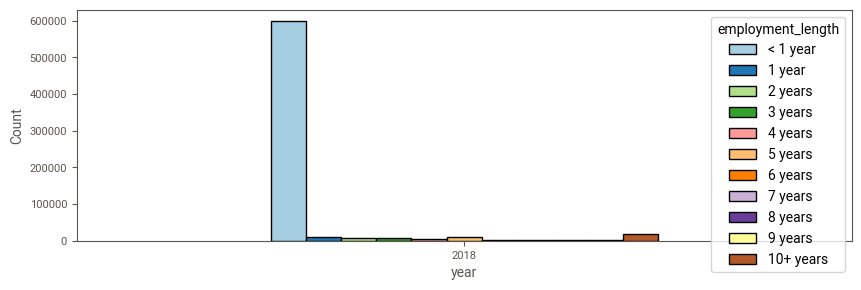

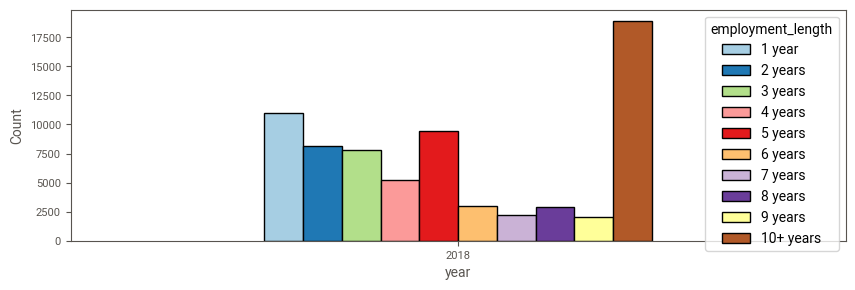

In [114]:
ct = an.CrossTab("year", "employment_length", data=loans_eda_2018)
ct.barplot(colormap="Paired")

ct2 = an.CrossTab(
    "year",
    "employment_length",
    data=loans_eda_2018.query("employment_length != '< 1 year'"),
)
ct2.barplot(colormap="Paired")

del ct, ct2

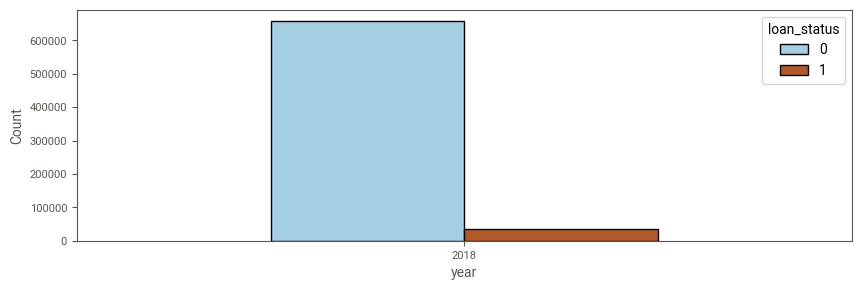

In [115]:
ct = an.CrossTab("year", "loan_status", data=loans_eda_2018)
ct.barplot(colormap="Paired")
del ct

month,1,2,3,4,5,6,7,8,9,10,11,12
loan_status,,,,,,,,,,,,
0,46628.00,38720.00,44958.00,51412.00,62477.00,55874.00,59517.00,62630.00,57023.00,63762.00,58123.00,58020.00
1,2539.00,2253.00,2779.00,2989.00,3262.00,3002.00,3087.00,3317.00,2858.00,3170.00,3022.00,2801.00
percent_accepted,5.16,5.50,5.82,5.49,4.96,5.10,4.93,5.03,4.77,4.74,4.94,4.61


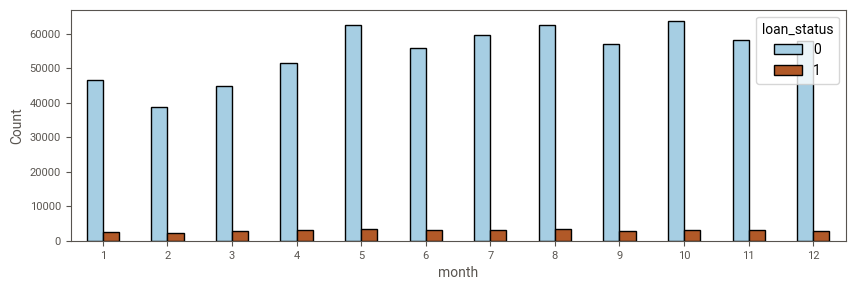

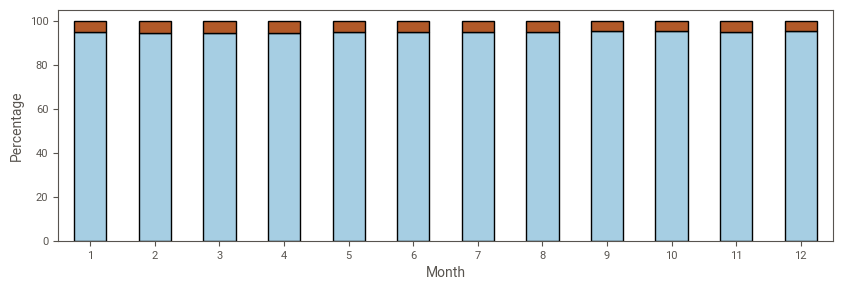

In [116]:
ct = an.CrossTab("month", "loan_status", data=loans_eda_2018)
ct.barplot(colormap="Paired")
ct.barplot(
    normalize="rows", stacked=True, xlabel="Month", legend=False, colormap="Paired"
)
display(ct.counts.assign(percent_accepted=lambda df: df[1] / (df[1] + df[0]) * 100).T)
del ct

loan_amount_above_40k,0,1
loan_status,,
0,656600.00,2544.00
1,35079.00,0.00
percent_accepted,5.07,0.00


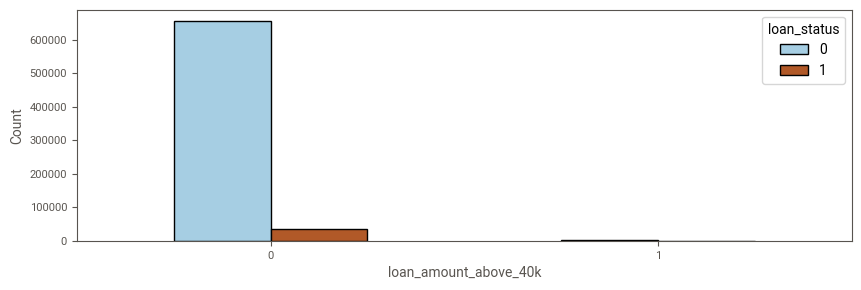

In [117]:
ct = an.CrossTab("loan_amount_above_40k", "loan_status", data=loans_eda_2018)
ct.barplot(colormap="Paired")
display(ct.counts.assign(percent_accepted=lambda df: df[1] / (df[1] + df[0]) * 100).T)
del ct

,count,mean,std,min,25%,50%,75%,max
loan_status,,,,,,,,
0,659144.0,13059.5,13528.5,100.0,5000.0,10000.0,20000.0,300000.0
1,35079.0,15966.1,10082.5,1000.0,8000.0,14000.0,21600.0,40000.0


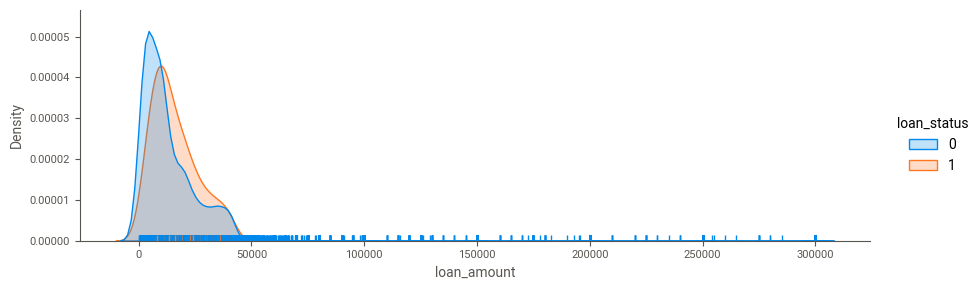

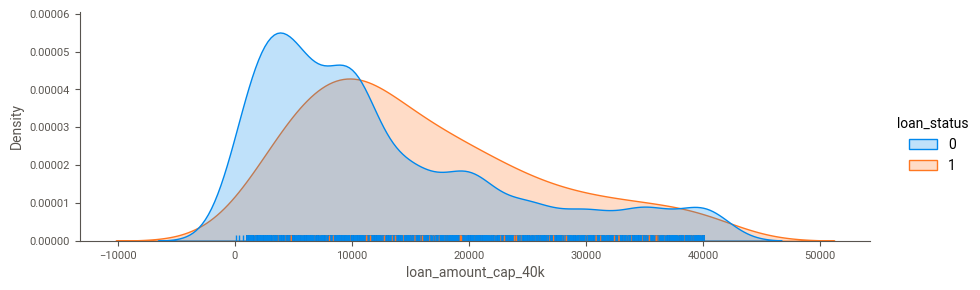

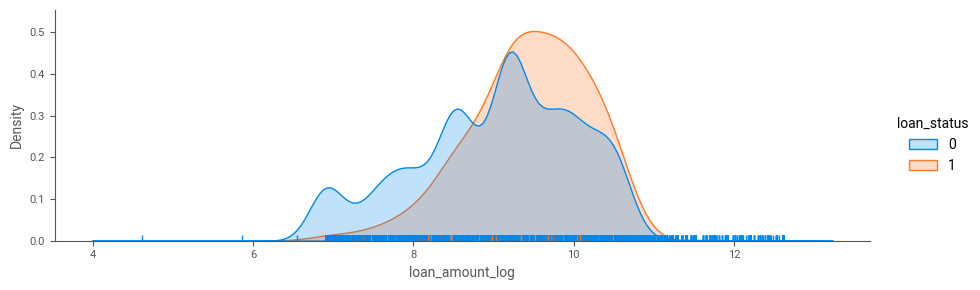

In [119]:
x_1 = "loan_amount"
x_2 = "loan_amount_cap_40k"
x_3 = "loan_amount_log"
hue = "loan_status"
data = loans_eda_2018

plot_kde(data, x_1, hue)
plot_kde(data, x_2, hue)
plot_kde(data, x_3, hue)
display(describe_numeric(data, x_1, by=hue))
del x_1, x_2, x_3, hue, data

In the original **debt-to-income ratio** variable (before treating -1 as a missing value), all the missing values were in the accepted loans data only, and all the -1 values were in the rejected loans data only.

In [120]:
ct1 = an.CrossTab(
    "debt_to_income_ratio_is_minus_1",
    "loan_status",
    data=loans_eda_2018.assign(
        debt_to_income_ratio_is_minus_1=loans_eda_2018.debt_to_income_ratio_original
        == -1
    ),
)
display(ct1.counts)

ct2 = an.CrossTab(
    "debt_to_income_ratio_is_na_original", "loan_status", data=loans_eda_2018
)
display(ct2.counts)

del ct1, ct2

loan_status,0,1
debt_to_income_ratio_is_minus_1,,
False,654673,35079
True,4471,0


loan_status,0,1
debt_to_income_ratio_is_na_original,,
0,659144,34994
1,0,85


After treating -1 as a missing value, the distribution of the **debt-to-income ratio** is following:

loan_status,0,1,percent_accepted
debt_to_income_ratio_is_na,,,
0,654673,34994,5.07
1,4471,85,1.87


debt_to_income_ratio_is_na,0,1,percent_missing
year,,,
2018,689667,4556,0.66


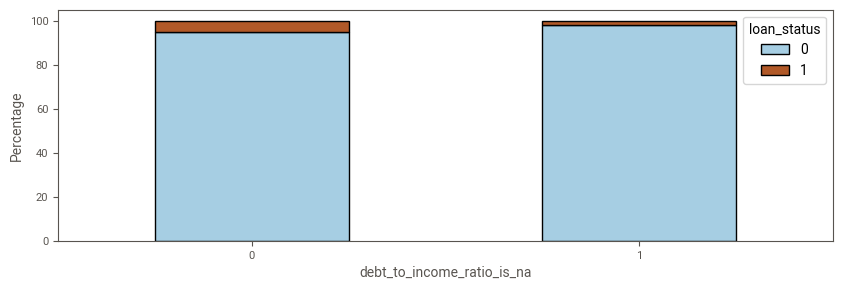

In [121]:
ct = an.CrossTab("debt_to_income_ratio_is_na", "loan_status", data=loans_eda_2018)
ct.barplot(normalize="rows", stacked=True, colormap="Paired")
display(ct.counts.assign(percent_accepted=lambda df: df[1] / (df[1] + df[0]) * 100))

ct2 = an.CrossTab("year", "debt_to_income_ratio_is_na", data=loans_eda_2018)
display(ct2.counts.assign(percent_missing=lambda df: df[1] / (df[1] + df[0]) * 100))

del ct, ct2

Plots with (a) full range of **debt-to-income ratio** and (b) range between 0 and 100:

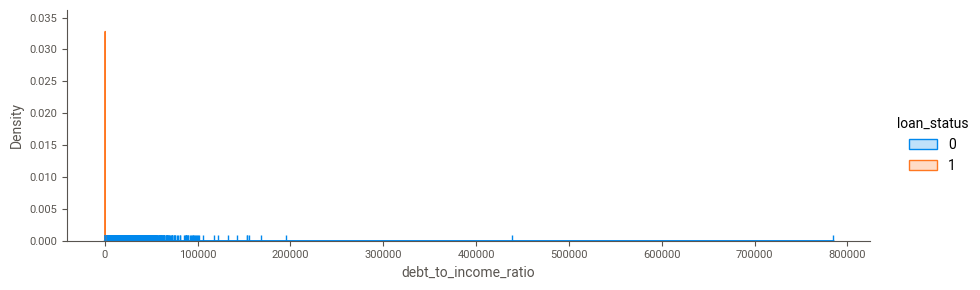

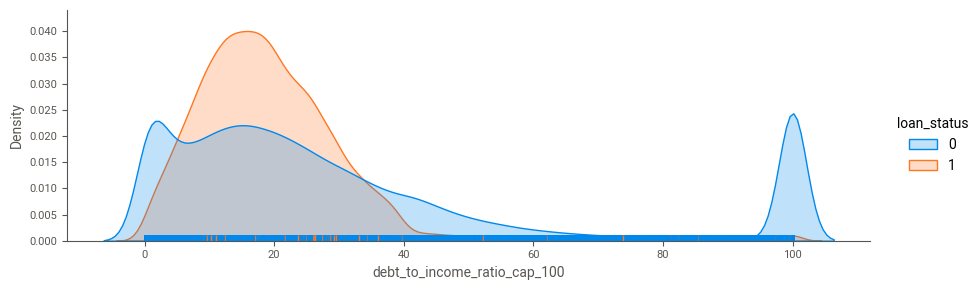

In [122]:
x = "debt_to_income_ratio"
hue = "loan_status"
data = loans_eda_2018

describe_numeric(data, x, by=hue)
plot_kde(data, x, hue)

plot_kde(data, "debt_to_income_ratio_cap_100", hue, bw_adjust=1);

employment_length,< 1 year,1 year,2 years,3 years,4 years,5 years,6 years,7 years,8 years,9 years,10+ years
loan_status,,,,,,,,,,,
0,597146.00,8644.00,4968.00,4995.00,2975.00,7271.00,1419.00,936.00,1751.00,1123.00,7513.00
1,3032.00,2321.00,3151.00,2812.00,2273.00,2199.00,1554.00,1280.00,1111.00,889.00,11413.00
percent_accepted,0.51,21.17,38.81,36.02,43.31,23.22,52.27,57.76,38.82,44.18,60.30


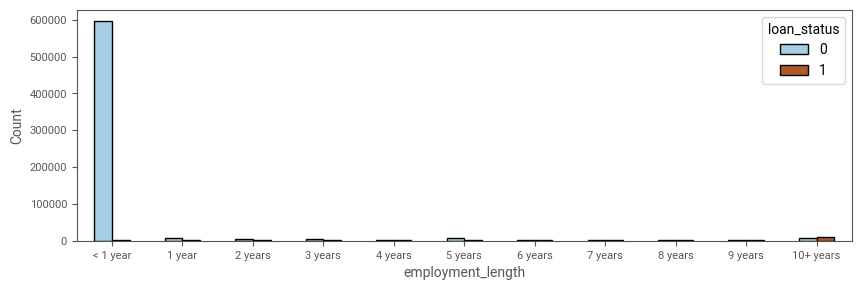

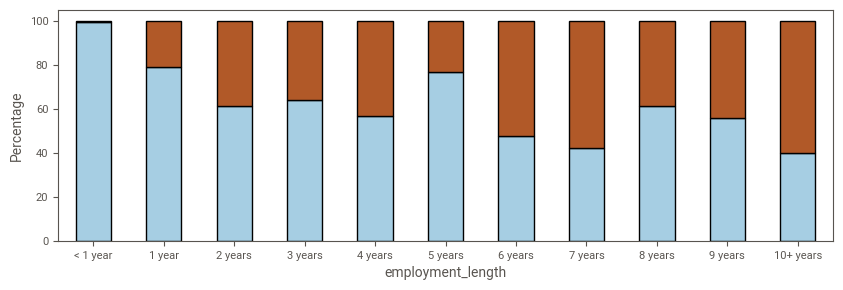

In [123]:
ct = an.CrossTab("employment_length", "loan_status", data=loans_eda_2018)
ct.barplot(colormap="Paired")
ct.barplot(normalize="rows", stacked=True, legend=False, colormap="Paired")
display(ct.counts.assign(percent_accepted=lambda df: df[1] / (df[1] + df[0]) * 100).T)
del ct

loan_status,0,1,percent_accepted
employment_length_is_na,,,
0,638741,32035,4.78
1,20403,3044,12.98


employment_length_is_na,0,1,percent_missing
year,,,
2018,670776,23447,3.38


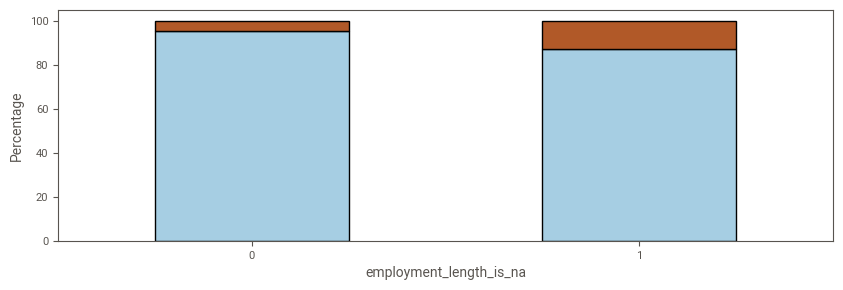

In [124]:
ct = an.CrossTab("employment_length_is_na", "loan_status", data=loans_eda_2018)
ct.barplot(normalize="rows", stacked=True, legend=False, colormap="Paired")
display(ct.counts.assign(percent_accepted=lambda df: df[1] / (df[1] + df[0]) * 100))

ct2 = an.CrossTab("year", "employment_length_is_na", data=loans_eda_2018)
display(ct2.counts.assign(percent_missing=lambda df: df[1] / (df[1] + df[0]) * 100))

del ct, ct2

,count,mean,std,min,25%,50%,75%,max
loan_status,,,,,,,,
0,45220.0,629.3,62.8,300.0,587.0,629.0,667.0,990.0
1,35079.0,708.4,36.2,662.0,682.0,702.0,727.0,847.5


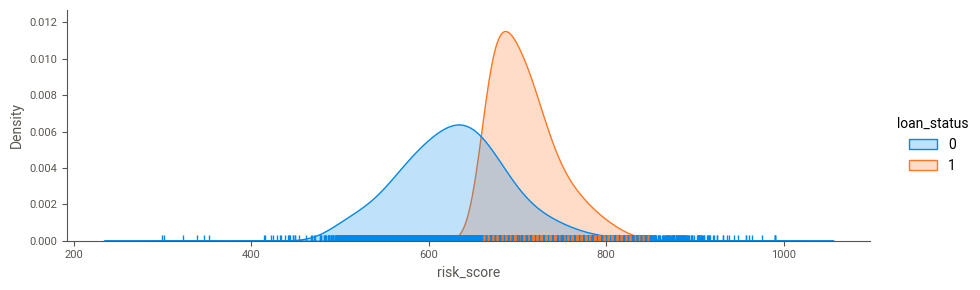

In [125]:
plot_kde(loans_eda_2018, "risk_score", "loan_status")
describe_numeric(loans_eda_2018, "risk_score", "loan_status")

loan_status,0,1,percent_accepted
risk_score_is_na,,,
0,45220,35079,43.69
1,613924,0,0.00


risk_score_is_na,0,1,percent_missing
year,,,
2018,80299,613924,88.43


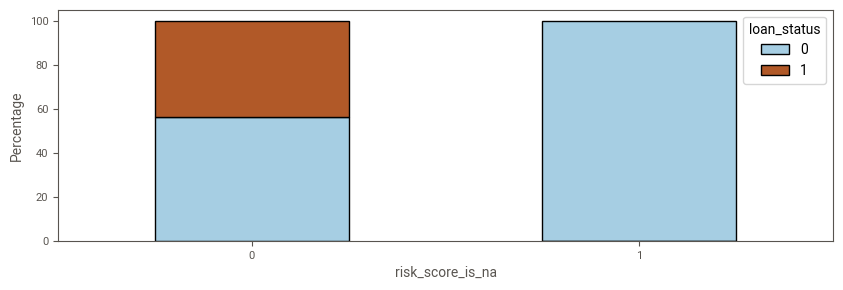

In [126]:
ct = an.CrossTab("risk_score_is_na", "loan_status", data=loans_eda_2018)
ct.barplot(normalize="rows", stacked=True, colormap="Paired")
display(ct.counts.assign(percent_accepted=lambda df: df[1] / (df[1] + df[0]) * 100))

ct2 = an.CrossTab("year", "risk_score_is_na", data=loans_eda_2018)
display(ct2.counts.assign(percent_missing=lambda df: df[1] / (df[1] + df[0]) * 100))

del ct, ct2

loan_status,0,1,percent_accepted
state,,,
MN,8677,608,6.55
CT,8389,586,6.53
CO,11236,776,6.46
VT,1198,80,6.26
CA,73260,4766,6.11
NH,2876,181,5.92
NY,44559,2793,5.90
AZ,14218,882,5.84
NJ,19980,1225,5.78


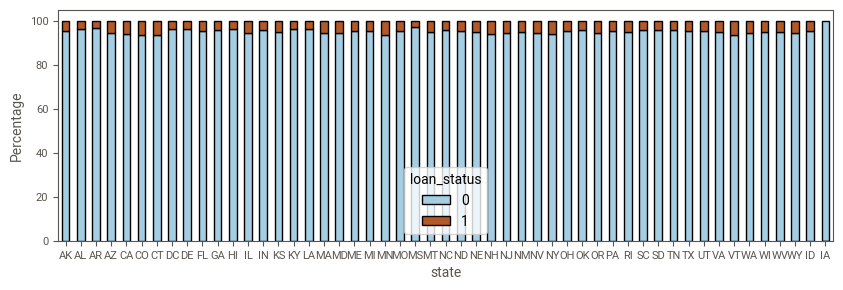

In [127]:
ct = an.CrossTab("state", "loan_status", data=loans_eda_2018)
ct.barplot(normalize="rows", stacked=True, colormap="Paired")
display(
    ct.counts.assign(
        percent_accepted=lambda df: df[1] / (df[1] + df[0]) * 100
    ).sort_values("percent_accepted", ascending=False)
)
del ct

loan_status,0,1,percent_accepted
zip_area,,,
9,96796,6099,5.93
0,50506,3107,5.80
8,45585,2739,5.67
5,21901,1293,5.57
1,71819,4067,5.36
6,44024,2428,5.23
2,67693,3431,4.82
4,63728,2977,4.46
7,84644,3849,4.35


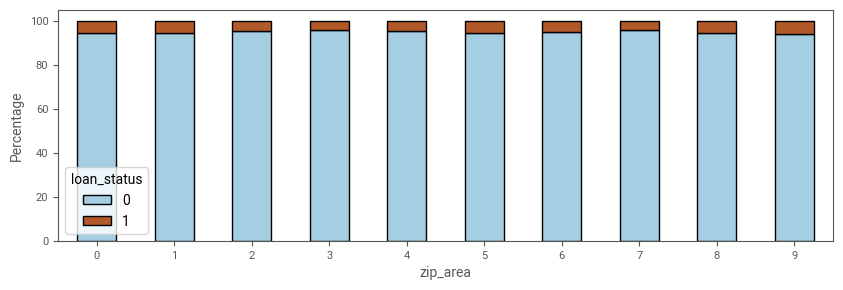

In [128]:
ct = an.CrossTab("zip_area", "loan_status", data=loans_eda_2018)
ct.barplot(normalize="rows", stacked=True, colormap="Paired")
display(
    ct.counts.assign(
        percent_accepted=lambda df: df[1] / (df[1] + df[0]) * 100
    ).sort_values("percent_accepted", ascending=False)
)
del ct

### Relationships between Variables

**Hierarchical clustering** can be performed **on a correlation matrix** to cluster variables with similar correlation patterns (these clusters can be identified as squares created of 2 or more variables along the diagonal). ***Absolute* values of correlation coefficients** make it easier to identify the clusters. Thus, @fig-corr-clustermap-abs helped to identify variables that are highly correlated with each other and manually populate the list of variables to exclude from the analysis.


Looking into correlations of variables to the target, variables  `risk_score_is_na`, `risk_score`, `employment_length_num` indicate the highest correlation to the target (@tbl-point-biserial-corr).

In [129]:
data_num = loans_eda_2018.drop(columns=to_exclude_1).select_dtypes("number")
corr_coefs = data_num.corr(method="pearson")
corr_coefs_abs = corr_coefs.fillna(0).abs()

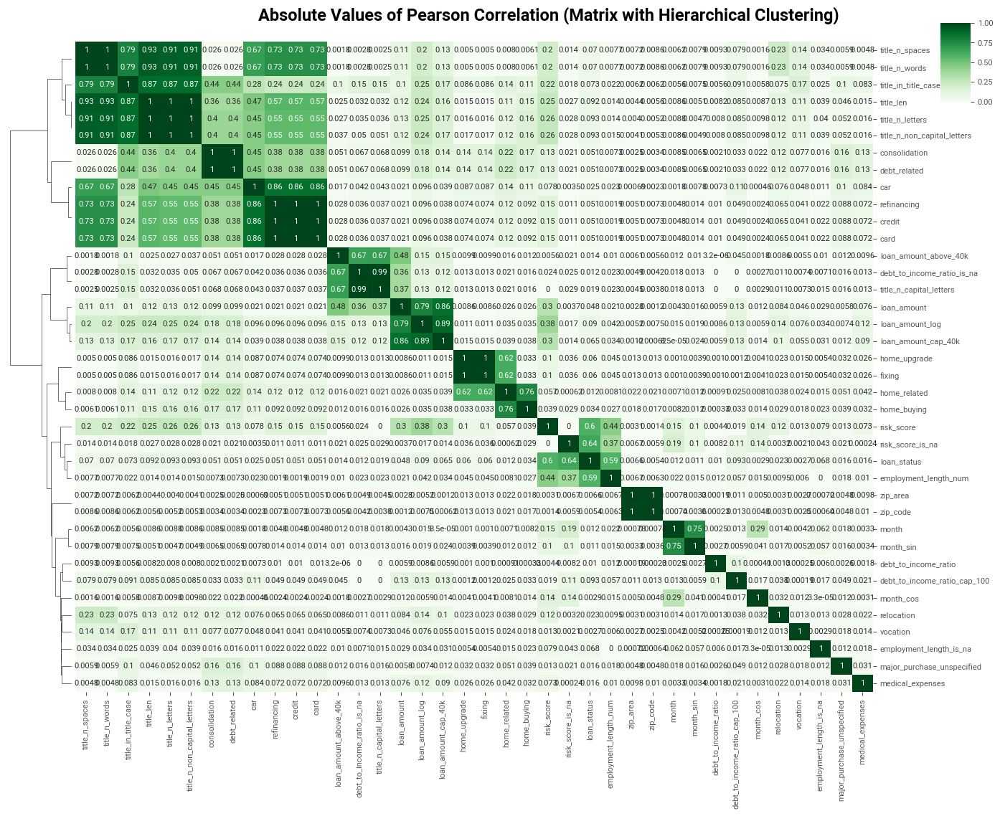

In [130]:
# | label: fig-corr-clustermap-abs
# | fig-cap: 'Matrix of absolute values of Pearson correlation coefficients.'
# | code-summary: Code of the figure
# | code-fold: false
g = sns.clustermap(
    corr_coefs_abs,
    method="ward",
    cmap="Greens",
    annot=True,
    annot_kws={"size": 8},
    vmin=0,
    vmax=1,
    figsize=(14, 11),
    cbar_pos=(0.94, 0.91, 0.03, 0.1),
    cbar_kws={"location": "right"},
    dendrogram_ratio=(0.075, 0),
)

g.fig.suptitle(
    "Absolute Values of Pearson Correlation (Matrix with Hierarchical Clustering)",
    fontsize=17,
    y=1.03,
    x=0.55,
);

The list of variables to exclude from the analysis based on this and previous explorations:

In [40]:
to_exclude_2 = str_to_list(
    """
date
year
policy_code
debt_to_income_ratio_is_na_original
debt_to_income_ratio_orig_cap_100
debt_to_income_ratio_original
zip_code_is_na
title_is_missing_or_empty
title_n_digits
title_n_punctuation
title_in_upper_case
title_in_lower_case
bills_taxes
payoff
weddings
motorcycle
vehicle_unspecified_or_other
investment
education	
renewable_energy
title_n_spaces
title_n_non_capital_letters
title_n_letters
title_in_title_case
fixing
credit
card
debt_related
zip_code
state
employment_length
loan_amount_log
month
"""
)

In [132]:
# | label: tbl-point-biserial-corr
# | tbl-cap: 'Point-biserial correlation coefficients between the variables
# |           and the target.'
# | code-summary: Code of the table
# | code-fold: false

an.get_pointbiserial_corr_scores(
    loans_eda_2018.drop(columns=to_exclude_2), target="loan_status"
)
# Time: 2m 41.0s

,variable_1,variable_2,n,r_pb,p,p_adj
1,loan_status,risk_score_is_na,694223,-0.638,<0.001,<0.001
2,loan_status,risk_score,80299,0.596,<0.001,<0.001
3,loan_status,employment_length_num,670776,0.589,<0.001,<0.001
4,loan_status,debt_to_income_ratio_cap_100,689667,-0.093,<0.001,<0.001
5,loan_status,title_len,694223,0.092,<0.001,<0.001
6,loan_status,title_n_words,694223,0.070,<0.001,<0.001
7,loan_status,employment_length_is_na,694223,0.068,<0.001,<0.001
8,loan_status,loan_amount_cap_40k,694223,0.065,<0.001,<0.001
9,loan_status,home_upgrade,694223,0.060,<0.001,<0.001
10,loan_status,consolidation,694223,0.051,<0.001,<0.001


The last check before modeling:

In [133]:
an.col_info(loans_eda_2018.drop(columns=to_exclude_2), style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_status,Int8,1.4 MB,2,<0.1%,0,0%,"659,144",94.9%,94.9%,0
2,month_sin,float32,2.8 MB,8,<0.1%,0,0%,"132,879",19.1%,19.1%,-0.8660254
3,month_cos,float32,2.8 MB,8,<0.1%,0,0%,"128,343",18.5%,18.5%,-0.8660254
4,loan_amount,float32,2.8 MB,"1,849",0.3%,0,0%,"114,672",16.5%,16.5%,10000.0
5,loan_amount_cap_40k,float32,2.8 MB,"1,550",0.2%,0,0%,"114,672",16.5%,16.5%,10000.0
6,loan_amount_above_40k,Int8,1.4 MB,2,<0.1%,0,0%,"691,679",99.6%,99.6%,0
7,debt_to_income_ratio,float32,2.8 MB,"24,784",3.6%,"4,556",0.7%,"63,399",9.1%,9.2%,100.0
8,debt_to_income_ratio_cap_100,float32,2.8 MB,"9,752",1.4%,"4,556",0.7%,"83,910",12.1%,12.2%,100.0
9,debt_to_income_ratio_is_na,Int8,1.4 MB,2,<0.1%,0,0%,"689,667",99.3%,99.3%,0
10,risk_score,float32,2.8 MB,462,0.1%,"613,924",88.4%,"2,555",0.4%,3.2%,682.0


## Modeling (Year 2018)

### Prepare Training, Validation, and Test Sets

In [58]:
path_train = dir_interim + "task-1-loans_train.feather"
path_validation = dir_interim + "task-1-loans_validation.feather"
path_test = dir_interim + "task-1-loans_test.feather"

if (
    os.path.exists(path_train)
    and os.path.exists(path_validation)
    and os.path.exists(path_test)
):
    # Load saved results
    loans_train = pd.read_feather(path_train)
    loans_validation = pd.read_feather(path_validation)
    loans_test = pd.read_feather(path_test)
else:
    # Save as feather files
    loans_train.to_feather(path_train)
    loans_validation.to_feather(path_validation)
    loans_test.to_feather(path_test)

In [59]:
# Filter the data for year 2018 only
loans_train_2018 = loans_train.query("year == 2018")
loans_validation_2018 = loans_validation.query("year == 2018")
loans_test_2018 = loans_test.query("year == 2018")

# Create X_train, y_train, X_validation, y_validation, X_test, and y_test
X_train = loans_train_2018.drop(columns=to_exclude_2 + ["loan_status"])
y_train = loans_train_2018["loan_status"]

X_validation = loans_validation_2018.drop(columns=to_exclude_2 + ["loan_status"])
y_validation = loans_validation_2018["loan_status"]

X_test = loans_test_2018.drop(columns=to_exclude_2 + ["loan_status"])
y_test = loans_test_2018["loan_status"]

In [60]:
# Remove some unnecessary variables
del (
    loans_train_2018,
    loans_validation_2018,
    loans_test_2018,
    loans_train,
    loans_validation,
    loans_test,
)

if "loans_eda_2018" in locals():
    del loans_eda_2018

if "loans_eda" in locals():
    del loans_eda

### Create Pre-Processing Pipelines

Some steps of group-independent pre-processing have already been done in the previous chapters and will not be repeated here. Here, pipelines for group-dependent processing will be created. 

Suffix `_lr` means that the pipeline (or other object) is for non-tree-based models (logistic regression and Naive Bayes) and `_trees` means that it is for tree-based models (LGBM):

- `_lr` pipeline contains one extra step: numeric data scaling.

In [61]:
# | code-fold: false
# | code-summary: Variable lists for pre-processing

numeric_common = str_to_list(
    """
risk_score
employment_length_num
title_len
title_n_capital_letters
title_n_words
"""
)

# Impute median, scale:
numeric_features_for_lr = (
    str_to_list(
        """
loan_amount_cap_40k
debt_to_income_ratio_cap_100
"""
    )
    + numeric_common
)

exclude_for_lr = str_to_list(
    """
loan_amount
debt_to_income_ratio
"""
)

# Impute median:
numeric_features_for_trees = (
    str_to_list(
        """
loan_amount
debt_to_income_ratio
"""
    )
    + numeric_common
)

exclude_for_trees = str_to_list(
    """
loan_amount_cap_40k
debt_to_income_ratio_cap_100
"""
)

# One-Hot Encoding:
categorical_features = ["zip_area"]

# Impute 0:
binary_features = str_to_list(
    """
loan_amount_above_40k
refinancing
consolidation
home_upgrade
home_related
home_buying
major_purchase_unspecified
relocation
car
medical_expenses
vocation
"""
)

# Pass Through
indicators = str_to_list(
    """
debt_to_income_ratio_is_na
employment_length_is_na
risk_score_is_na
"""
)

**Group-independent steps** that can be performed before cross-validation:

In [62]:
# | code-fold: false

select_binary_01 = make_column_selector(
    pattern=create_column_selector_pattern(binary_features)
)
select_categorical = make_column_selector(
    pattern=create_column_selector_pattern(categorical_features)
)

# Create the pipelines
binary_transformer = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="constant", fill_value=0))]
)
categorical_transformer = Pipeline(
    steps=[("onehot", OneHotEncoder(sparse_output=False, handle_unknown="ignore"))]
)


group_independent_transforms = ColumnTransformer(
    transformers=[
        ("binary", binary_transformer, select_binary_01),
        ("categorical", categorical_transformer, select_categorical),
    ],
    verbose_feature_names_out=False,
    remainder="passthrough",
)

group_independent_preprocessor_for_lr = Pipeline(
    steps=[
        ("dropper", DropFeatures(exclude_for_lr)),
        ("transformer", group_independent_transforms),
    ]
)

group_independent_preprocessor_for_trees = Pipeline(
    steps=[
        ("dropper", DropFeatures(exclude_for_trees)),
        ("transformer", group_independent_transforms),
    ]
)

- **For logistic regression and Naive Bayes**, `loan_amount`, `debt_to_income_ratio` will be dropped, and capped variables will be used instead:

In [63]:
# | code-fold: false
group_independent_preprocessor_for_lr

Pipeline(steps=[('dropper',
                 DropFeatures(features_to_drop=['loan_amount',
                                                'debt_to_income_ratio'])),
                ('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(fill_value=0,
                                                                                 strategy='constant'))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x0000026409B7ABD0>),
                                                 ('categorical',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x000002640D7AFAD0>)],
                                   verbose_feature_names_out=False))])

- **For tree-based models**, non-capped versions of the same variables will be used:

In [64]:
# | code-fold: false
group_independent_preprocessor_for_trees

Pipeline(steps=[('dropper',
                 DropFeatures(features_to_drop=['loan_amount_cap_40k',
                                                'debt_to_income_ratio_cap_100'])),
                ('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('binary',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(fill_value=0,
                                                                                 strategy='constant'))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x0000026409B7ABD0>),
                                                 ('categorical',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x000002640D7AFAD0>)],
                                   verbose_feature_names_out=False))])

**Group-dependent pre-processing steps** that should be performed after cross-validation splits before each model re-fitting:

In [65]:
# | code-fold: false

# Group-dependent pre-processing steps
# that will be performed before each model re-fitting

# Select numeric variables by data type and name pattern
select_numeric_for_lr = make_column_selector(
    dtype_include="number",
    pattern=create_column_selector_pattern(numeric_features_for_lr),
)
select_numeric_for_trees = make_column_selector(
    dtype_include="number",
    pattern=create_column_selector_pattern(numeric_features_for_trees),
)

# Create the pipelines
numeric_transformer_for_lr = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="median")), ("scaler", StandardScaler())]
)
numeric_transformer_for_trees = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="median"))]
)

group_dependent_preprocessor_for_lr = ColumnTransformer(
    transformers=[
        ("numeric", numeric_transformer_for_lr, select_numeric_for_lr),
    ],
    verbose_feature_names_out=False,
    remainder="passthrough",
)

group_dependent_preprocessor_for_trees = ColumnTransformer(
    transformers=[
        ("numeric", numeric_transformer_for_trees, select_numeric_for_trees),
    ],
    verbose_feature_names_out=False,
    remainder="passthrough",
)

- For logistic regression and Naive Bayes:

In [66]:
# | code-fold: false
# For LR and NB
group_dependent_preprocessor_for_lr

ColumnTransformer(remainder='passthrough',
                  transformers=[('numeric',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('scaler', StandardScaler())]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x000002640D7BBFD0>)],
                  verbose_feature_names_out=False)

- For tree-based models:

In [67]:
# | code-fold: false
# For tree-based models
group_dependent_preprocessor_for_trees

ColumnTransformer(remainder='passthrough',
                  transformers=[('numeric',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='median'))]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x000002640D7BBE50>)],
                  verbose_feature_names_out=False)

### Apply Group-Independent Pre-Processing

Apply group-independent pre-processing steps to the training, validation, and test sets and save the results as separate datasets.

In [68]:
print(X_train.shape)
print(X_validation.shape)
print(X_test.shape)

(6939617, 26)
(1484768, 26)
(1485951, 26)


Next, apply group-independent pre-processing and cache the results.

In [69]:
# For LR and NB
path_train = dir_interim + "task-1-X_train_lr.feather"
path_validation = dir_interim + "task-1-X_validation_lr.feather"
path_test = dir_interim + "task-1-X_test_lr.feather"

if (
    os.path.exists(path_train)
    and os.path.exists(path_validation)
    and os.path.exists(path_test)
):
    # Load saved results
    X_train_lr = pd.read_feather(path_train)
    X_validation_lr = pd.read_feather(path_validation)
    X_test_lr = pd.read_feather(path_test)
else:
    # Pre-process
    X_train_lr = group_independent_preprocessor_for_lr.fit_transform(X_train)
    X_validation_lr = group_independent_preprocessor_for_lr.transform(X_validation)
    X_test_lr = group_independent_preprocessor_for_lr.transform(X_test)

    # Save as feather files
    X_train_lr.to_feather(path_train)
    X_validation_lr.to_feather(path_validation)
    X_test_lr.to_feather(path_test)

In [70]:
# For LGBM
path_train_trees = dir_interim + "task-1-X_train_trees.feather"
path_validation_trees = dir_interim + "task-1-X_validation_trees.feather"
path_test_trees = dir_interim + "task-1-X_test_trees.feather"

if (
    os.path.exists(path_train_trees)
    and os.path.exists(path_validation_trees)
    and os.path.exists(path_test_trees)
):
    # Load saved results
    X_train_trees = pd.read_feather(path_train_trees)
    X_validation_trees = pd.read_feather(path_validation_trees)
    X_test_trees = pd.read_feather(path_test_trees)
else:
    # Pre-process
    X_train_trees = group_independent_preprocessor_for_trees.fit_transform(X_train)
    X_validation_trees = group_independent_preprocessor_for_trees.transform(
        X_validation
    )
    X_test_trees = group_independent_preprocessor_for_trees.transform(X_test)

    # Save as feather files
    X_train_lr.to_feather(path_train_trees)
    X_validation_lr.to_feather(path_validation_trees)
    X_test_lr.to_feather(path_test_trees)

### Train Models

In [71]:
# Dictionary to collect results (logistic regression and Naive Bayes)
models_lr = {}

In [72]:
@my.cache_results(dir_interim + "models_1_01_naive_bayes-2.pickle")
def fit_nb():
    """Fit a Naive Bayes model."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(group_dependent_preprocessor_for_lr)),
            ("classifier", GaussianNB()),
        ]
    )
    pipeline.fit(X_train_lr, y_train)

    return pipeline


models_lr["Naive Bayes"] = fit_nb()
# Time 1m 38.1s

In [73]:
@my.cache_results(dir_interim + "models_1_02_logistic_regression_sgd-2.pickle")
def fit_lr_sgd():
    """Fit a Logistic Regression model (via SGD training)."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(group_dependent_preprocessor_for_lr)),
            (
                "classifier",
                SGDClassifier(
                    random_state=1, loss="log_loss", n_jobs=-1, class_weight="balanced"
                ),
            ),
        ]
    )
    pipeline.fit(X_train_lr, y_train)
    return pipeline


models_lr["Logistic Regression"] = fit_lr_sgd()
# 51.5s

In [74]:
# Dictionary to collect results (tree-based models)
models_trees = {}

In [75]:
@my.cache_results(dir_interim + "models_1_03_lgbm-2.pickle")
def fit_lgbm():
    """Fit a LGBM model."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(group_dependent_preprocessor_for_trees)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="binary",
                    metric="binary_logloss",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )

    pipeline.fit(X_train_trees, y_train)

    return pipeline


# Time: 57.2s
models_trees["LGBM"] = fit_lgbm()

### Evaluate Models

In [76]:
# | code-fold: false
# | label: tbl-1-train
# | tbl-cap: 'Classification scores for the **train set**.
# |           The rows are sorted by ROC AUC score.
# |           The best values in each column are highlighted.'
print("--- Train ---")

trees_performance_train = ml.classification_scores(
    models_trees,
    X_train_trees,
    y_train,
    style=False,
)
ml.classification_scores(
    models_lr,
    X_train_lr,
    y_train,
    add=trees_performance_train,
    color="orange",
    sort_by="ROC_AUC",
)

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM,6939617,0.950,0.997,0.998,0.996,0.967,0.998,0.999,0.996,0.936,1.000,1.000
Logistic Regression,6939617,0.950,0.981,0.989,0.977,0.840,0.990,0.997,0.980,0.725,1.000,0.998
Naive Bayes,6939617,0.950,0.938,0.963,0.926,0.614,0.966,0.991,0.935,0.445,0.999,0.987


In [77]:
# | code-fold: false
# | label: tbl-pre-tune-validation
# | tbl-cap: 'Classification scores for the **validation set**.
# |           The rows are sorted by ROC AUC score.
# |           The best values in each column are highlighted.'

print("--- Validation ---")

trees_performance_val = ml.classification_scores(
    models_trees,
    X_validation_trees,
    y_validation,
    style=False,
)
ml.classification_scores(
    models_lr,
    X_validation_lr,
    y_validation,
    add=trees_performance_val,
    sort_by="ROC_AUC",
)

--- Validation ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM,1484768,0.950,0.997,0.998,0.995,0.966,0.998,0.999,0.996,0.935,1.000,1.000
Logistic Regression,1484768,0.950,0.981,0.989,0.978,0.841,0.990,0.997,0.980,0.726,1.000,0.998
Naive Bayes,1484768,0.950,0.938,0.963,0.927,0.614,0.966,0.991,0.935,0.445,1.000,0.988


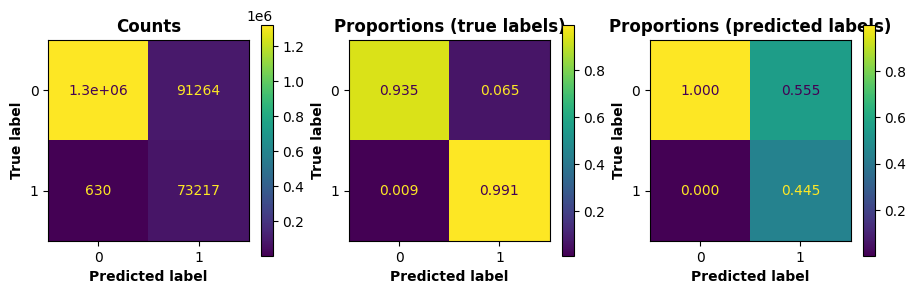

In [78]:
y_pred_validation_nb = models_lr["Naive Bayes"].predict(X_validation_lr)
ml.plot_confusion_matrices(y_validation, y_pred_validation_nb);

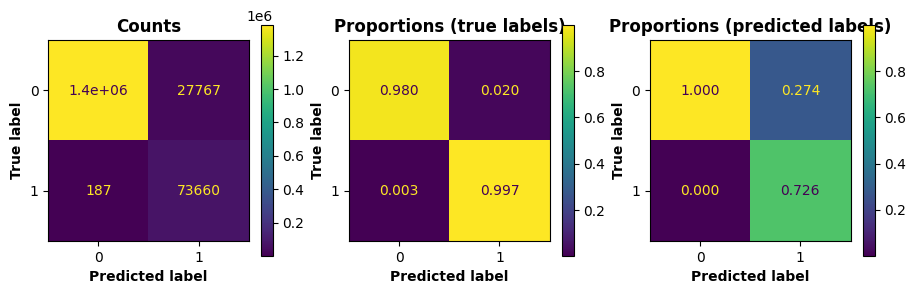

In [79]:
y_pred_validation_lr = models_lr["Logistic Regression"].predict(X_validation_lr)
ml.plot_confusion_matrices(y_validation, y_pred_validation_lr);

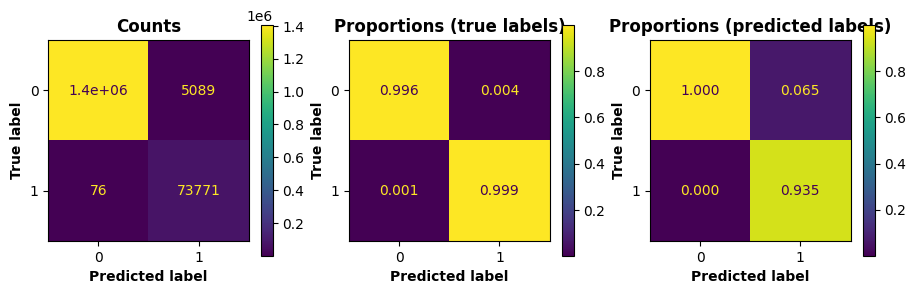

In [80]:
y_pred_validation_lgbm = models_trees["LGBM"].predict(X_validation_trees)
ml.plot_confusion_matrices(y_validation, y_pred_validation_lgbm);

For the next round of analysis, the LGBM model is selected as the best-performing one.

### Feature Importance (Best Model)

Feature importance for the LGBM model will be evaluated. Both internal LGBM and SHAP feature importance will be used. 

Both methods indicate, that there are 9 most important features, just suggest different order of features.

In [81]:
@my.cache_results(dir_interim + "task-1-shap_lgbm_k=all.pkl")
def get_shap_values_lgbm():
    model = "LGBM"
    preproc = Pipeline(steps=models_trees[model].steps[:-1])
    classifier = models_trees[model]["classifier"]
    X_validation_preproc = preproc.transform(X_validation_trees)

    tree_explainer = shap.TreeExplainer(classifier)
    shap_values = tree_explainer.shap_values(X_validation_preproc)
    return shap_values, X_validation_preproc


shap_values_lgbm, data_for_lgbm = get_shap_values_lgbm()
# Time:7m 49.3s

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


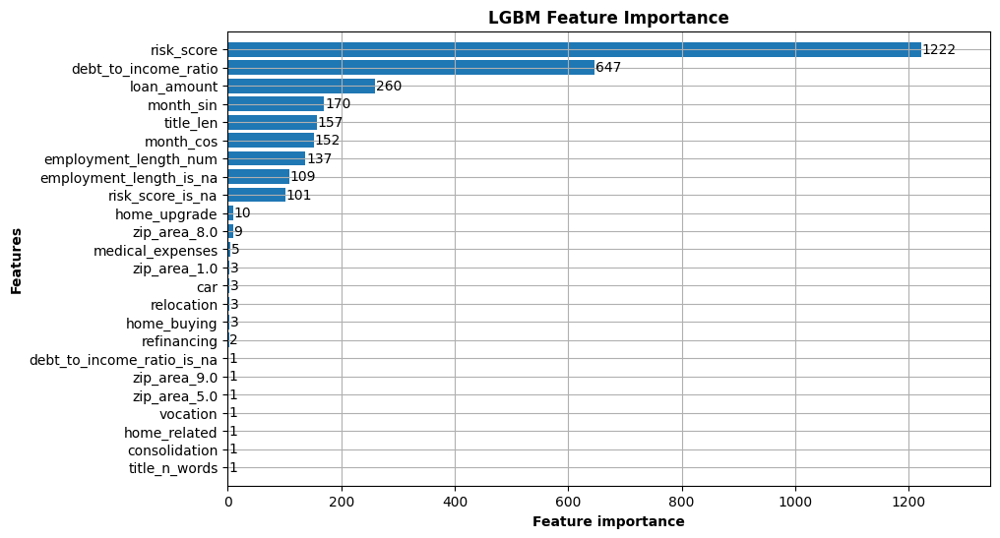

In [82]:
lgb.plot_importance(
    models_trees["LGBM"]["classifier"],
    max_num_features=50,
    figsize=(10, 6),
    height=0.8,
    title="LGBM Feature Importance",
);

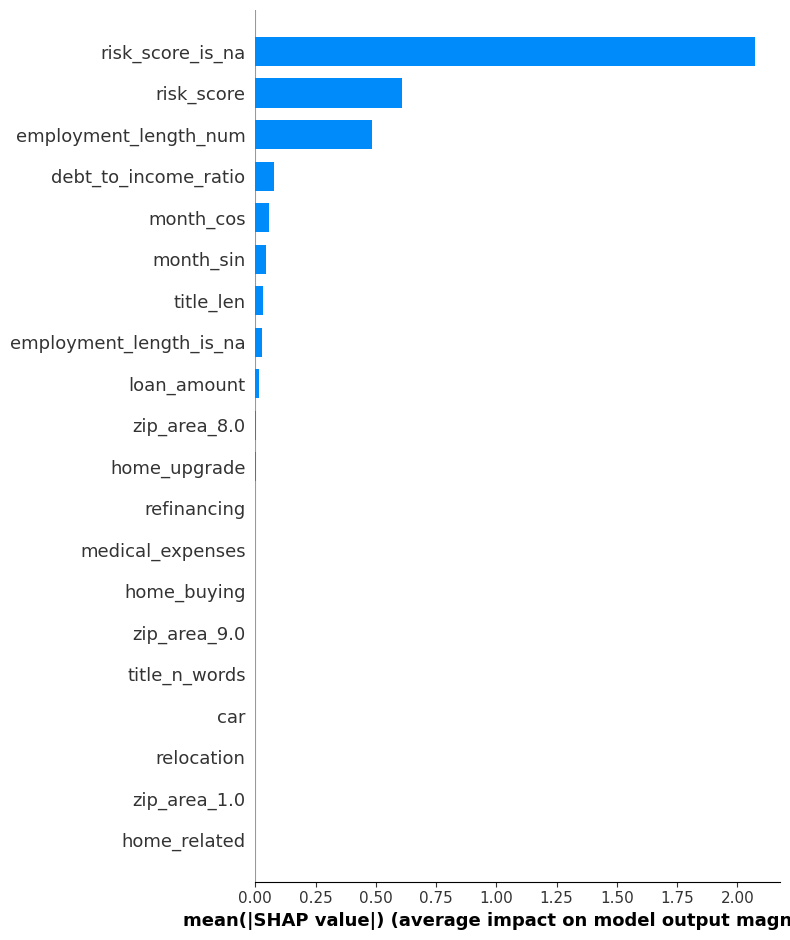

In [83]:
shap.summary_plot(shap_values_lgbm[1], data_for_lgbm, plot_type="bar")

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


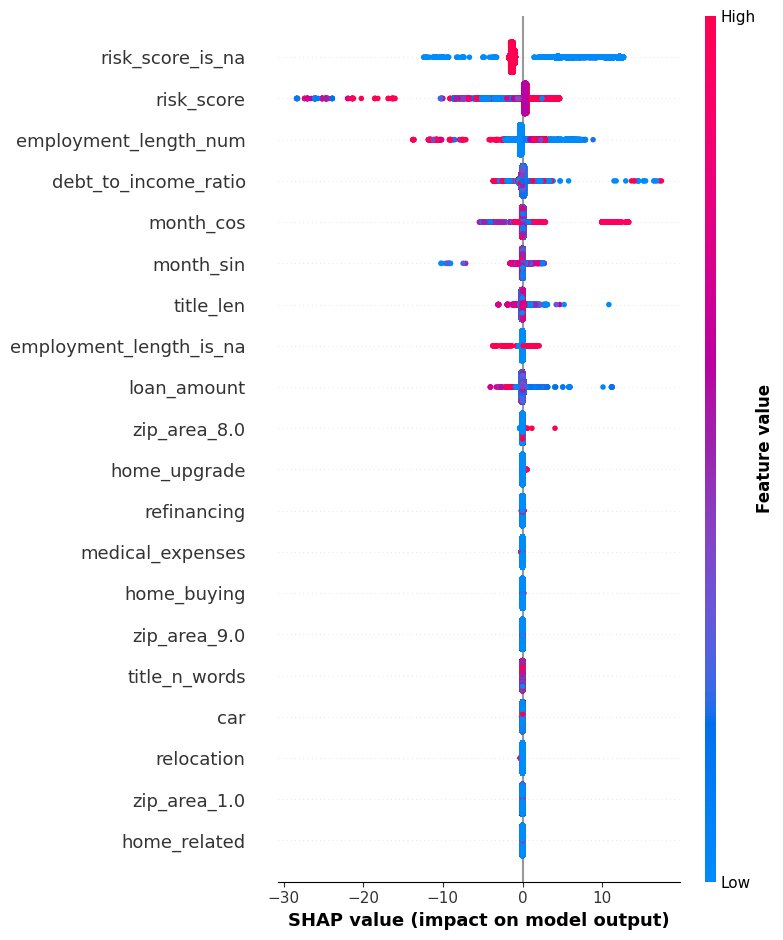

In [84]:
shap.summary_plot(shap_values_lgbm[1], data_for_lgbm)

### LGBM Re-Evaluation with Most Important Variables

The **LGBM model** was re-evaluated with **9 most important features** only.

Validation accuracy, F1 score (of accepted loans), and PPV (positive predictive value) *slightly dropped* while others remained the same at the precision of 3 decimal digits (@tbl-loan-status-9-features-validation). Due to lower complexity, the model with 9 features will be used in the next steps.

The details of modeling are presented below.

In [ ]:
# | code-summary: Code to define and train the model
# | code-fold: false


@my.cache_results(dir_interim + "models_1_03_lgbm_k=9.pkl")
def fit_lgbm_k9():
    """Fit a LGBM model."""

    to_include = str_to_list(
        """
    risk_score_is_na
    risk_score
    employment_length_num
    debt_to_income_ratio
    month_cos
    month_sin
    employment_length_is_na
    title_len
    loan_amount
    """
    )

    pipeline = Pipeline(
        steps=[
            ("selector", ColumnSelector(to_include)),
            ("preprocessor", clone(group_dependent_preprocessor_for_trees)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="binary",
                    metric="binary_logloss",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train_trees, y_train)
    return pipeline


models_trees["LGBM (feat=9)"] = fit_lgbm_k9()
# Time 35.4s

In [90]:
# | code-fold: false
# | label: tbl-loan-status-9-features-train
# | tbl-cap: 'Classification scores for the **train set**.
# |           The rows are sorted by ROC-AUC score.
# |           The best values in each column are highlighted.'
print("--- Train ---")

trees_performance_train = ml.classification_scores(
    models_trees,
    X_train_trees,
    y_train,
    style=False,
)
train_performance = ml.classification_scores(
    models_lr,
    X_train_lr,
    y_train,
    add=trees_performance_train,
    color="orange",
    sort_by="ROC_AUC",
)
train_performance

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM,6939617,0.950,0.997,0.998,0.996,0.967,0.998,0.999,0.996,0.936,1.000,1.000
LGBM (feat=9),6939617,0.950,0.996,0.998,0.995,0.965,0.998,0.999,0.996,0.934,1.000,1.000
Logistic Regression,6939617,0.950,0.981,0.989,0.977,0.840,0.990,0.997,0.980,0.725,1.000,0.998
Naive Bayes,6939617,0.950,0.938,0.963,0.926,0.614,0.966,0.991,0.935,0.445,0.999,0.987


In [91]:
# | code-fold: false
# | label: tbl-loan-status-9-features-validation
# | tbl-cap: 'Classification scores for the **validation set**.
# |           The rows are sorted by ROC-AUC score.
# |           The best values in each column are highlighted.'

print("--- Validation ---")

trees_performance_val = ml.classification_scores(
    models_trees,
    X_validation_trees,
    y_validation,
    style=False,
)
validation_performance = ml.classification_scores(
    models_lr,
    X_validation_lr,
    y_validation,
    add=trees_performance_val,
    sort_by="ROC_AUC",
)
validation_performance
# Time: 8m 50.6s

--- Validation ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM,1484768,0.950,0.997,0.998,0.995,0.966,0.998,0.999,0.996,0.935,1.000,1.000
LGBM (feat=9),1484768,0.950,0.996,0.998,0.995,0.965,0.998,0.999,0.996,0.933,1.000,1.000
Logistic Regression,1484768,0.950,0.981,0.989,0.978,0.841,0.990,0.997,0.980,0.726,1.000,0.998
Naive Bayes,1484768,0.950,0.938,0.963,0.927,0.614,0.966,0.991,0.935,0.445,1.000,0.988


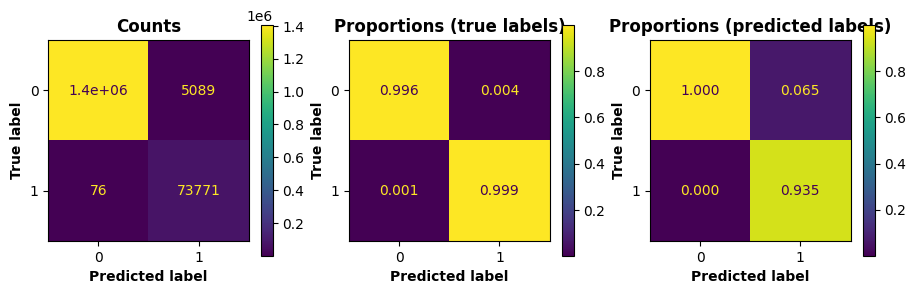

In [92]:
y_pred_validation_lgbm = models_trees["LGBM"].predict(X_validation_trees)
ml.plot_confusion_matrices(y_validation, y_pred_validation_lgbm);

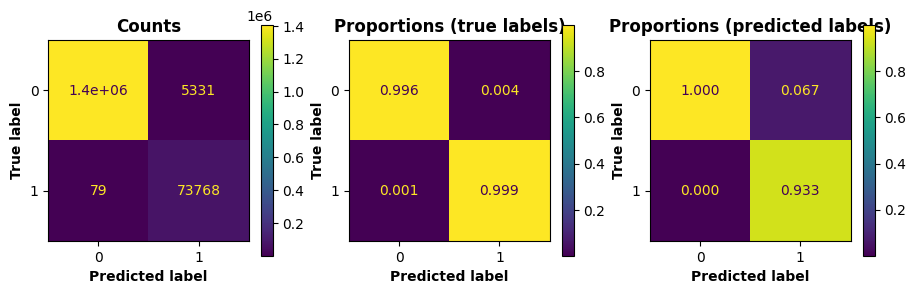

In [93]:
y_pred_validation_lgbm = models_trees["LGBM (feat=9)"].predict(X_validation_trees)
ml.plot_confusion_matrices(y_validation, y_pred_validation_lgbm);

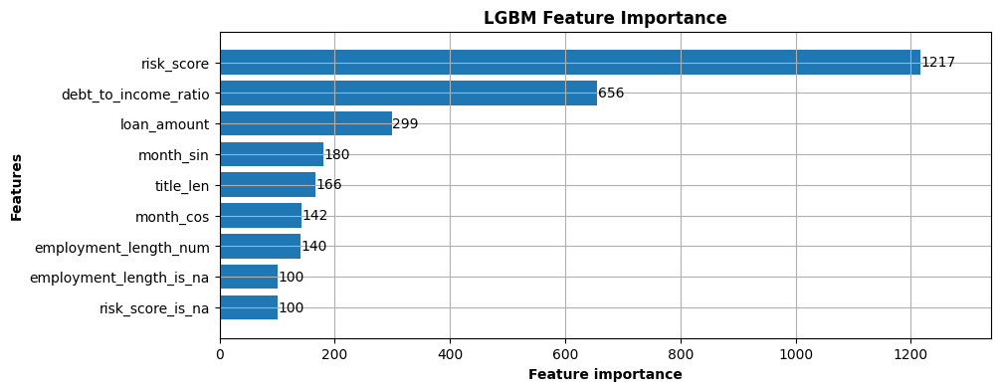

In [94]:
lgb.plot_importance(
    models_trees["LGBM (feat=9)"]["classifier"],
    max_num_features=50,
    figsize=(10, 4),
    height=0.8,
    title="LGBM Feature Importance",
);

In [95]:
@my.cache_results(dir_interim + "task-1-shap_lgbm_k=9.pkl")
def get_shap_values_lgbm_k8():
    model = "LGBM (feat=9)"
    preproc = Pipeline(steps=models_trees[model].steps[:-1])
    classifier = models_trees[model]["classifier"]
    X_validation_preproc = preproc.transform(X_validation_trees)

    tree_explainer = shap.TreeExplainer(classifier)
    shap_values = tree_explainer.shap_values(X_validation_preproc)
    return shap_values, X_validation_preproc


shap_values_lgbm_k9, data_for_lgbm_k9 = get_shap_values_lgbm_k8()
# Time: 7m 13.7s

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


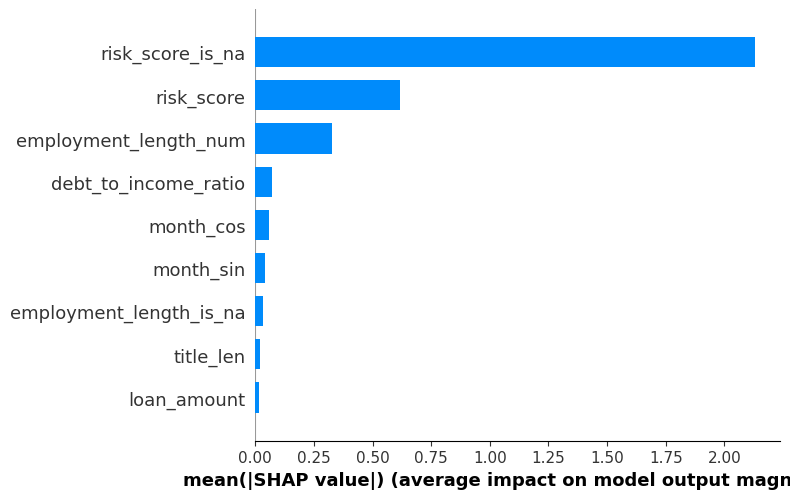

In [98]:
shap.summary_plot(shap_values_lgbm_k9[1], data_for_lgbm_k9, plot_type="bar")

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


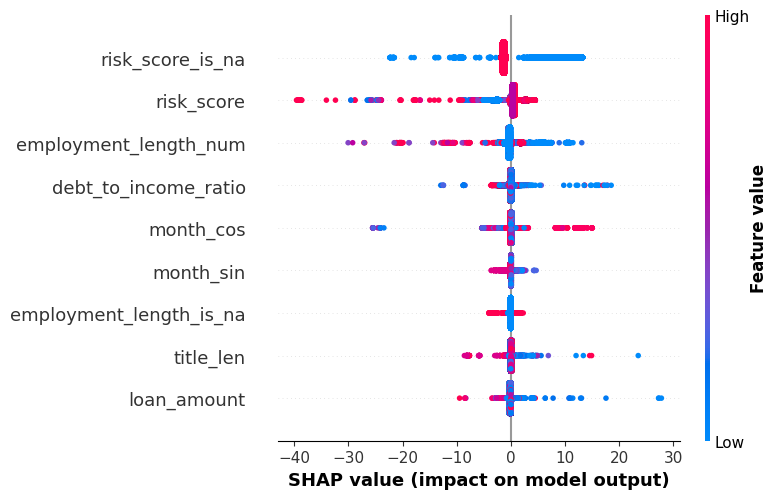

In [99]:
shap.summary_plot(shap_values_lgbm_k9[1], data_for_lgbm_k9)

## Final Model for Deployment

The final model will be trained on the whole dataset and deployed on Google Cloud Platform (GCP).

In [100]:
to_include = str_to_list(
    """
risk_score_is_na
risk_score
employment_length_num
debt_to_income_ratio
month_cos
month_sin
employment_length_is_na
title_len
loan_amount
"""
)

X = pd.concat(
    [
        X_train_trees[to_include],
        X_validation_trees[to_include],
        X_test_trees[to_include],
    ],
    axis="index",
)

y = pd.concat([y_train, y_validation, y_test], axis="index")

In [ ]:
@my.cache_results(dir_interim + "01--model_predict_loan_status.pkl")
def fit_lgbm_final():
    """Fit the final LGBM model."""
    pipeline = Pipeline(
        steps=[
            ("selector", ColumnSelector(to_include)),
            ("preprocessor", clone(group_dependent_preprocessor_for_trees)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="binary",
                    metric="binary_logloss",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X, y)
    return pipeline


loan_status_predictor_final = fit_lgbm_final()

# Task 2: Predicting Loan Grade, Subgrade, and Interest Rate

## Inspection, EDA and Pre-Processing

### Import and Inspect Data

For this task, only data from the most recent loan issue year (**2018**) will be used to reflect the most recent trends. This decision is made based on findings comparing trends over the years in Task 1.

To remember what data in the file looks like, the first 10 rows will be printed:

In [ ]:
!cd data/raw/ &&\
    head -n 10 accepted_2007_to_2018Q4.csv

id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,to

In [ ]:
!cd data/raw/ &&\
    head -n 10 accepted_2007_to_2018Q4.csv | csvlook


|         id | member_id | loan_amnt | funded_amnt | funded_amnt_inv |       term | int_rate | installment | grade | sub_grade | emp_title                               | emp_length | home_ownership | annual_inc | verification_status | issue_d  | loan_status | pymnt_plan | url                                                               | desc | purpose            | title                   | zip_code | addr_state |   dti | delinq_2yrs | earliest_cr_line | fico_range_low | fico_range_high | inq_last_6mths | mths_since_last_delinq | mths_since_last_record | open_acc | pub_rec | revol_bal | revol_util | total_acc | initial_list_status | out_prncp | out_prncp_inv | total_pymnt | total_pymnt_inv | total_rec_prncp | total_rec_int | total_rec_late_fee | recoveries | collection_recovery_fee | last_pymnt_d | last_pymnt_amnt | next_pymnt_d | last_credit_pull_d | last_fico_range_high | last_fico_range_low | collections_12_mths_ex_med | mths_since_last_major_derog | policy_code | application_type

Next, data will be imported, the year 2018 will be kept and data types will be automatically adjusted to take less memory. The results will be saved into a feather file.

In [3]:
file_path = dir_interim + "task-2--1-accepted_loans_2018--raw.feather"
if os.path.exists(file_path):
    # Restore from file, if present.
    accepted_2018 = pd.read_feather(file_path)
else:
    # Use Pyarrow backend to read data.
    # Leave only data of loans issued in year 2018.
    accepted_all = pd.read_csv("data/raw/accepted_2007_to_2018Q4.csv", engine="pyarrow")
    accepted_2018 = accepted_all[accepted_all["issue_d"].str.contains("2018", na=False)]
    accepted_2018 = klib.convert_datatypes(accepted_2018)
    accepted_2018.to_feather(file_path)
    del accepted_all

del file_path

The whole dataset took 2.5+ GB of memory (code is not shown here). After leaving only the year 2018, it used 574.3+ MB (code is not shown here). After automatic data type adjustment, the memory usage dropped almost 2 times to 267.4 MB.

```
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2260701 entries, 0 to 2260700
Columns: 151 entries, id to settlement_term
dtypes: float64(113), object(38)
memory usage: 2.5+ GB
```


```
<class 'pandas.core.frame.DataFrame'>
Index: 495242 entries, 421097 to 1611876
Columns: 151 entries, id to settlement_term
dtypes: float64(113), object(38)
memory usage: 574.3+ MB
```

In [4]:
accepted_2018.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
Index: 495242 entries, 421097 to 1611876
Columns: 151 entries, id to settlement_term
dtypes: category(35), float32(102), float64(11), string(3)
memory usage: 267.4 MB


::: {.callout-note}
In this section, a **general overview and inspection** will be done to get more familiar with the data and to catch the most obvious discrepancies. A detailed **EDA** will be performed **on the training set** only.

:::

To spot possible discrepancies, the columns were inspected and the results were sorted by the number of unique values (`n_unique`). Some columns have no non-missing values (member ID, description), some have only 1 non-missing value (`hardship_type`, `deferral_term`, etc.), and these should be excluded from the analysis.

In [5]:
an.col_info(accepted_2018).sort_values("n_unique").pipe(an.style_col_info)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
2,member_id,float32,2.0 MB,0,0%,"495,242",100.0%,0,0%,nan%,
20,desc,category,495.4 kB,0,0%,"495,242",100.0%,0,0%,nan%,
130,hardship_type,category,495.4 kB,1,<0.1%,"494,874",99.9%,368,0.1%,100.0%,INTEREST ONLY-3 MONTHS DEFERRAL
133,deferral_term,float32,2.0 MB,1,<0.1%,"494,874",99.9%,368,0.1%,100.0%,3.0
138,hardship_length,float32,2.0 MB,1,<0.1%,"494,874",99.9%,368,0.1%,100.0%,3.0
104,num_tl_120dpd_2m,float32,2.0 MB,1,<0.1%,"12,404",2.5%,"482,838",97.5%,100.0%,0.0
56,policy_code,float32,2.0 MB,1,<0.1%,0,0%,"495,242",100.0%,100.0%,1.0
145,debt_settlement_flag,category,495.5 kB,2,<0.1%,0,0%,"494,762",99.9%,99.9%,N
144,disbursement_method,category,495.5 kB,2,<0.1%,0,0%,"423,884",85.6%,85.6%,Cash
105,num_tl_30dpd,float32,2.0 MB,2,<0.1%,0,0%,"495,219",>99.9%,>99.9%,0.0


In the categorical target columns: first grades and sub-grades (e.g., A, B) seem to be more common than the last ones (e.g., F, G). This should be accounted for in the analysis. E.g., by using a stratified split.


grade
A    135177
B    141365
C    126850
D     69046
E     18958
F      3175
G       671
Name: count, dtype: int64

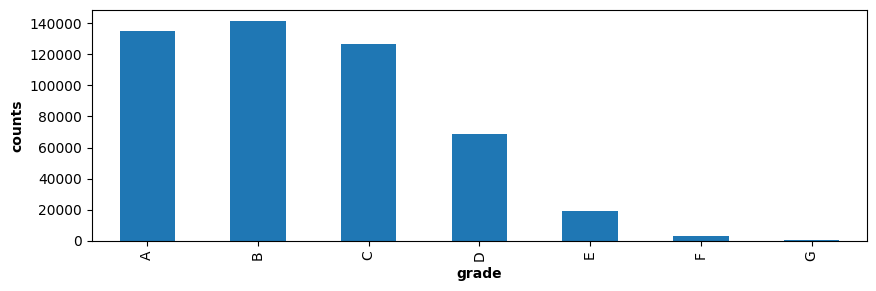

In [34]:
grade_counts = accepted_2018["grade"].value_counts().sort_index()
grade_counts.plot.bar(ylabel="counts")
grade_counts

A1     28887
A2     22871
A3     25264
A4     31648
A5     26507
...      ...
G1       487
G2        88
G3        44
G4        25
G5        27
dtype: object

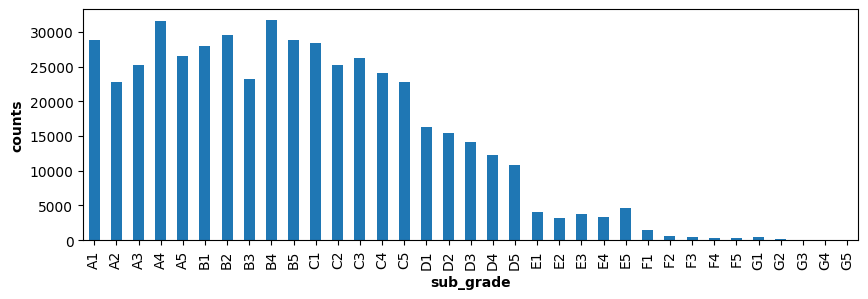

In [33]:
sub_grade_counts = accepted_2018["sub_grade"].value_counts().sort_index()
sub_grade_counts.plot.bar(ylabel="counts")
pd.concat([sub_grade_counts.head(), pd.Series({"...": "..."}), sub_grade_counts.tail()])

Loan title and purpose contain similar information. Some categories are very rare so should be merged. One of the variables should be dropped.

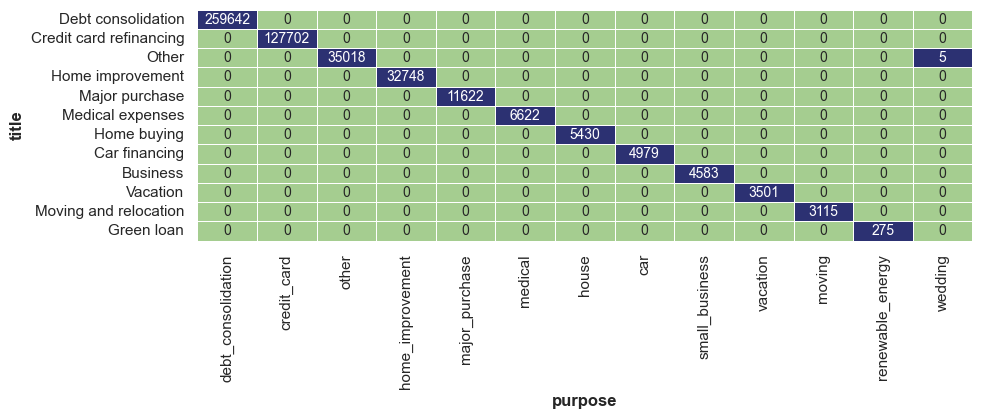

In [ ]:
ct = an.CrossTab("title", "purpose", data=accepted_2018, margins=True)
ct.counts = (
    ct.counts.sort_values(by="All", axis=0, ascending=False)
    .sort_values(by="All", axis=1, ascending=False)
    .drop("All", axis=0)
    .drop("All", axis=1)
)
ct.heatmap(vmax=1, cbar=False, cmap="crest");

### Group-Independent Pre-Processing

In this pre-processing phase:

- columns with more than 70% of missing values will be dropped;
- extract features (months from issue date, national area code `zip_area` from the first digit of the ZIP code, title length);
- add missing value indicators.
- some other columns after manual inspection will be dropped
    - irrelevant variables or variables after feature extraction;
    - date variables;
    - categorical variables with too many categories;
    - etc.

In [4]:
file_path = dir_interim + "task-2--2-accepted_loans-2018--preprocessed.feather"

# Drop columns based on manual inspection
drop_manually = [
    # Irrelevant
    "url",
    "id",
    "policy_code",
    "loan_status",
    # Almost duplicates of other columns:
    "title",
    # Dates
    "last_pymnt_d",
    "next_pymnt_d",
    "last_credit_pull_d",
    "issue_d",
    "earliest_cr_line",
    # Too many categories
    "zip_code",
    "addr_state",
    "emp_title",
    # Extremely low variability
    "num_tl_120dpd_2m",
    "acc_now_delinq",
]


if os.path.exists(file_path):
    accepted_2018_preproc = pd.read_feather(file_path)
else:
    # Remove columns with more than 70% of missing values
    accepted_2018_preproc = accepted_2018.loc[:, accepted_2018.isnull().mean() <= 0.7]

    # Pre-process the data
    accepted_2018_preproc = accepted_2018_preproc.assign(
        # Extract features
        title_len=lambda df: df["title"].str.len().fillna(0).astype("float32"),
        issue_d=lambda df: pd.to_datetime(df["issue_d"], format="%b-%Y"),
        issue_month=lambda df: df["issue_d"].dt.month.astype("Int8"),
        zip_area=lambda x: x.zip_code.str[0].astype("category"),
        # Encode variables:
        # - Employment length classes as integers
        emp_length=lambda df: df["emp_length"]
        .replace(dict(zip(utils.work_categories, range(len(utils.work_categories)))))
        .astype("Int8"),
        # Add missing value indicators
        emp_length_is_na=lambda df: df["emp_length"].isna().astype("Int8"),
        dti_is_na=lambda df: df["dti"].isna().astype("Int8"),
        mths_since_last_delinq_is_na=(
            lambda df: df["mths_since_last_delinq"].isna().astype("Int8")
        ),
        revol_util_is_na=lambda df: df["revol_util"].isna().astype("Int8"),
        mths_since_rcnt_il_is_na=lambda df: df["mths_since_rcnt_il"]
        .isna()
        .astype("Int8"),
        il_util_is_na=lambda df: df["il_util"].isna().astype("Int8"),
        all_util_is_na=lambda df: df["all_util"].isna().astype("Int8"),
        bc_open_to_buy_is_na=lambda df: df["bc_open_to_buy"].isna().astype("Int8"),
        bc_util_is_na=lambda df: df["bc_util"].isna().astype("Int8"),
        mo_sin_old_il_acct_is_na=lambda df: df["mo_sin_old_il_acct"]
        .isna()
        .astype("Int8"),
        mths_since_recent_bc_is_na=(
            lambda df: df["mths_since_recent_bc"].isna().astype("Int8")
        ),
        mths_since_recent_inq_is_na=(
            lambda df: df["mths_since_recent_inq"].isna().astype("Int8")
        ),
        percent_bc_gt_75_is_na=lambda df: df["percent_bc_gt_75"].isna().astype("Int8"),
    )

    # Remove columns after manual inspection
    accepted_2018_preproc = accepted_2018_preproc.drop(columns=drop_manually)

    # Save as feather file
    accepted_2018_preproc.to_feather(file_path)

del file_path
if "accepted_2018" in locals():
    del accepted_2018

### Create Pre-Processing Pipelines

In this section, pipelines for further processing of data will be created. Suffix `_lr` means that the pipeline (or other object) is for non-tree-based models (logistic regression and Naive Bayes) and `_trees` means that it is for tree-based models (LGBM):

- `_lr` pipeline contains one extra step: numeric data scaling.

In [12]:
# Numeric variables except missing value indicators
select_numeric = make_column_selector(dtype_include="number", pattern=".*(?!_is_na$)")
# Categorical variables
select_categorical = make_column_selector(dtype_include="category")

# Create the pipelines
numeric_transformer_lr = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="median")), ("scaler", StandardScaler())]
)
numeric_transformer_trees = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="median"))]
)
categorical_transformer = Pipeline(
    steps=[("onehot", OneHotEncoder(sparse_output=False, handle_unknown="ignore"))]
)

# Merge pipelines of numeric and categorical variables
pre_processing_lr = ColumnTransformer(
    transformers=[
        ("numeric", numeric_transformer_lr, select_numeric),
        ("categorical", categorical_transformer, select_categorical),
    ],
    verbose_feature_names_out=False,
    remainder="passthrough",
)
pre_processing_trees = ColumnTransformer(
    transformers=[
        ("numeric", numeric_transformer_trees, select_numeric),
        ("categorical", categorical_transformer, select_categorical),
    ],
    verbose_feature_names_out=False,
    remainder="passthrough",
)

In [ ]:
pre_processing_lr

ColumnTransformer(remainder='passthrough',
                  transformers=[('numeric',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='median')),
                                                 ('scaler', StandardScaler())]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x000001878499E590>),
                                ('categorical',
                                 Pipeline(steps=[('onehot',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse_output=False))]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x00000187803F2450>)],
                  verbose_feature_names_out=False)

In [ ]:
pre_processing_trees

ColumnTransformer(remainder='passthrough',
                  transformers=[('numeric',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(strategy='median'))]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x000001878499E590>),
                                ('categorical',
                                 Pipeline(steps=[('onehot',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse_output=False))]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x00000187803F2450>)],
                  verbose_feature_names_out=False)

### Split to Train, Validation, and Test Sets

Split data into training, validation, and test sets (70%:15%:15%) stratified by loan sub-grade to better reflect this type of data diversity in each set.

In [3]:
file_path = dir_interim + "task-2--2-accepted_loans-2018--preprocessed.feather"

if os.path.exists(file_path):
    accepted_2018_preproc = pd.read_feather(file_path)

del file_path

In [4]:
# Train, validation, test split (stratified by sub-grade): 70%:15%:15%
accepted_train, accepted_validation = train_test_split(
    accepted_2018_preproc,
    test_size=0.3,
    random_state=42,
    stratify=accepted_2018_preproc.sub_grade,
)

accepted_validation, accepted_test = train_test_split(
    accepted_validation,
    test_size=0.5,
    random_state=42,
    stratify=accepted_validation.sub_grade,
)

The sizes of these sets are as follows:

In [8]:
print(f"{accepted_train.shape[0]/1e3:.1f}k rows in training set.")
print(f"{accepted_validation.shape[0]/1e3: .1f}k rows in validation set.")
print(f"{accepted_test.shape[0]/1e3: .1f}k rows in test set.")

346.7k rows in training set.
 74.3k rows in validation set.
 74.3k rows in test set.


### EDA on Training Set

EDA in this section will cover 2 parts: EDA of target variables and EDA of other variables.

No essential discrepancies were found. Some variables (e.g., `pymnt_plan`) have rare values (are almost constant), but some target variables also have rare values (e.g., G5 grade). So these variables will be kept for now and models will "decide" if they are important enough. 

Variables such as `emp_length`,  `verification_status`, or `fico_range_low` show a potential to be good predictors.

Please, find EDA details below.

**Target variables**

Correspondence between loan grade and sub-grade (blue cells indicate that the sub-grade is included in the grade) show no discrepancies:

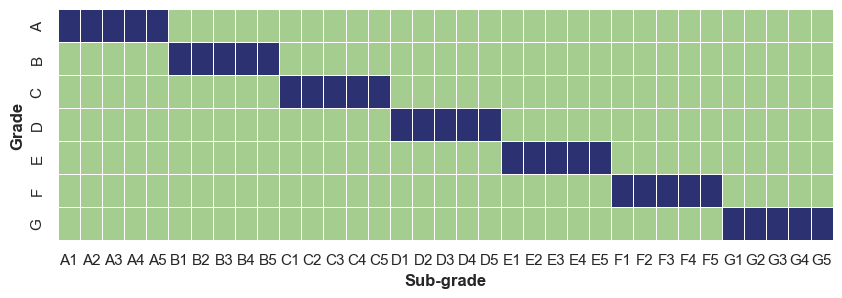

In [ ]:
ct = an.CrossTab("grade", "sub_grade", data=accepted_train)
ct.heatmap(vmax=1, cbar=False, cmap="crest", annot=False)
plt.xlabel("Sub-grade")
plt.ylabel("Grade")
del ct

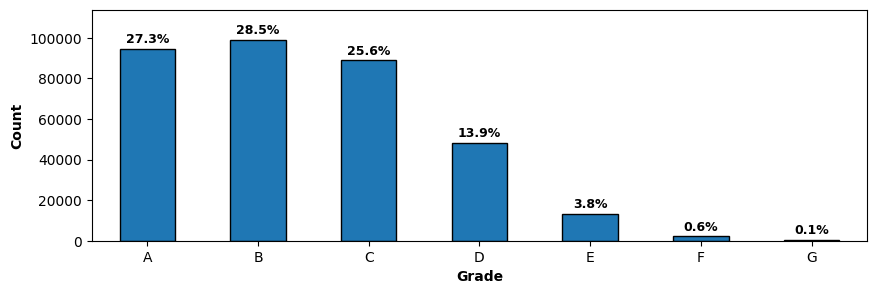

In [73]:
counts_g = (
    accepted_train["grade"]
    .value_counts()
    .sort_index()
    .to_frame()
    .reset_index()
    .assign(
        percent=lambda df: my.format_percent(df["count"] / df["count"].sum() * 100),
    )
)

my.plot_counts_with_labels(counts_g, x="grade", y="count", label="percent", rot=0);

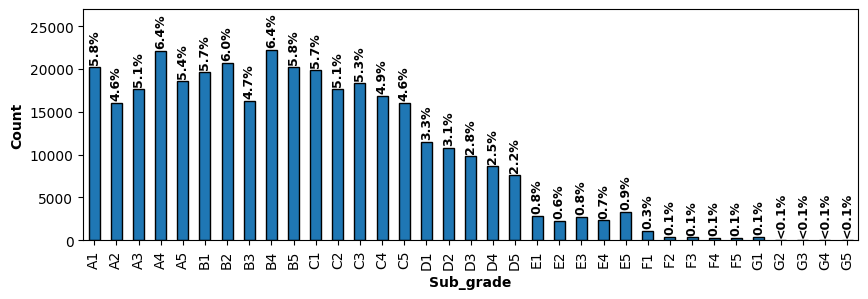

In [75]:
subgrade_count_series = accepted_train["sub_grade"].value_counts().sort_index()
counts_s = (
    subgrade_count_series.to_frame()
    .reset_index()
    .assign(
        percent=lambda df: df["count"] / df["count"].sum() * 100,
        label=lambda df: my.format_percent(df["percent"]),
    )
)

my.plot_counts_with_labels(
    counts_s,
    x="sub_grade",
    y="count",
    label="label",
    label_rotation=90,
    y_lim_max=27_000,
);

In [78]:
print("Counts of sub-grades for F and G grades:")
pd.concat([pd.Series({"Group": "Count"}), subgrade_count_series.tail(10)])

Counts of sub-grades for F and G grades:


Group    Count
F1        1063
F2         403
F3         305
F4         220
F5         231
G1         341
G2          62
G3          31
G4          17
G5          19
dtype: object

In most cases, **grades/sub-grades** are **in alignment with interest rates**: lower grades have higher interest rates and vice versa. But there are some **exceptions:** that not some loans have a 6% interest rate disregarding the grade/sub-grade (this is the case for all grades except grade G).

Please, find the details below.

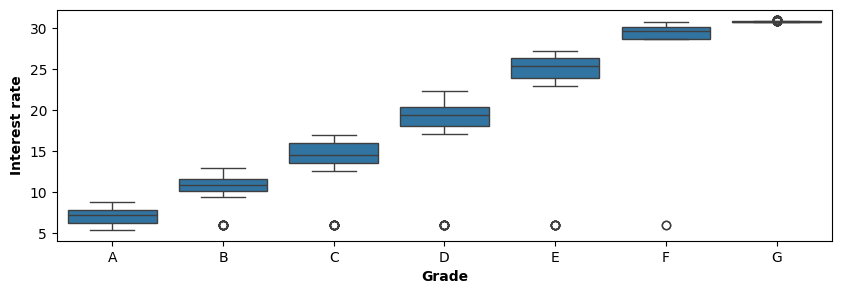

In [81]:
sns.boxplot(x="grade", y="int_rate", data=accepted_train)
plt.xlabel("Grade")
plt.ylabel("Interest rate");

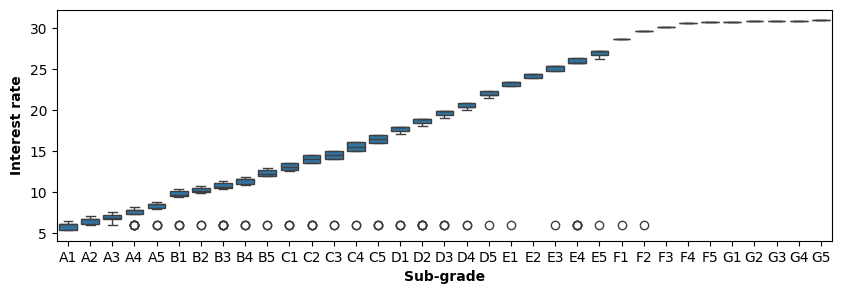

In [82]:
sns.boxplot(x="sub_grade", y="int_rate", data=accepted_train)
plt.xlabel("Sub-grade")
plt.ylabel("Interest rate");

Let's look into the outlying visible in the plot above:

In [83]:
accepted_train.query("sub_grade == 'B4'")["int_rate"].value_counts().sort_index()

int_rate
6.00        3
10.90    4935
10.91    2102
11.05    3300
11.55    8370
11.80    3499
Name: count, dtype: int64

In [87]:
accepted_train.query("sub_grade == 'D5'")["int_rate"].value_counts().sort_index()

int_rate
6.00        1
21.45    1093
21.85    3018
22.35    3474
Name: count, dtype: int64

It seems that those values are 6%. Let's look deeper into it:

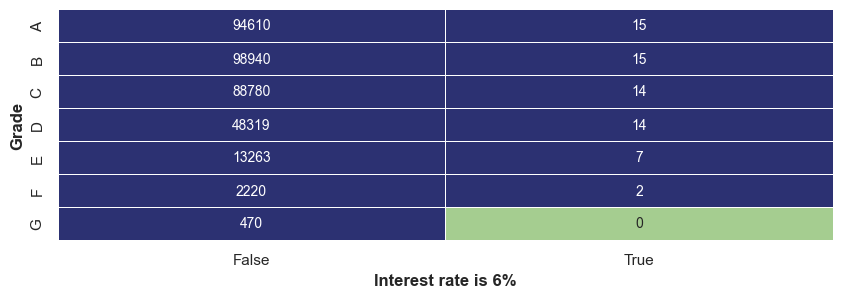

In [86]:
ct = an.CrossTab(
    "grade",
    "int_rate_is_6",
    data=accepted_train.assign(int_rate_is_6=lambda df: (df["int_rate"] == 6)),
)
ct.heatmap(vmax=1, cbar=False, cmap="crest")
plt.xlabel("Interest rate is 6%")
plt.ylabel("Grade")
del ct

**General EDA**

In [ ]:
an.col_info(accepted_train, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,loan_amnt,float32,1.4 MB,"1,555",0.4%,0,0%,"38,907",11.2%,11.2%,10000.0
2,funded_amnt,float32,1.4 MB,"1,555",0.4%,0,0%,"38,907",11.2%,11.2%,10000.0
3,funded_amnt_inv,float64,2.8 MB,"1,569",0.5%,0,0%,"37,718",10.9%,10.9%,10000.0
4,term,category,346.9 kB,2,<0.1%,0,0%,"241,239",69.6%,69.6%,36 months
5,int_rate,float32,1.4 MB,110,<0.1%,0,0%,"9,643",2.8%,2.8%,6.11
6,installment,float32,1.4 MB,"29,669",8.6%,0,0%,"1,049",0.3%,0.3%,304.72
7,grade,category,347.4 kB,7,<0.1%,0,0%,"98,955",28.5%,28.5%,B
8,sub_grade,category,349.8 kB,35,<0.1%,0,0%,"22,209",6.4%,6.4%,B4
9,emp_length,Int8,693.3 kB,11,<0.1%,"29,368",8.5%,"112,097",32.3%,35.3%,10
10,home_ownership,category,347.1 kB,4,<0.1%,0,0%,"167,124",48.2%,48.2%,MORTGAGE


                                             |          | [  0%]   00:00 -> (? left)


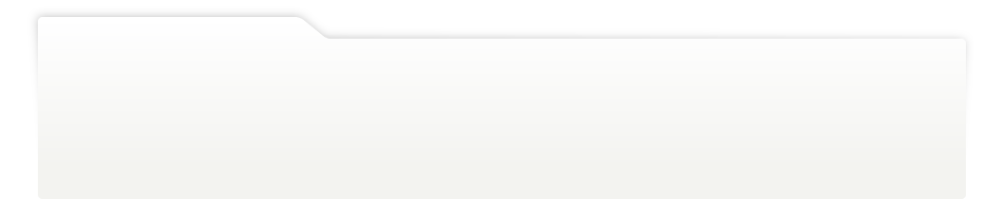
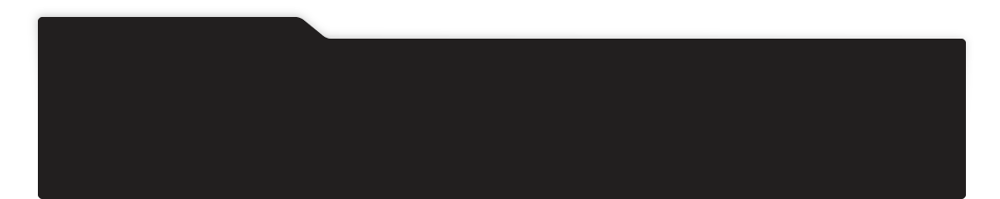
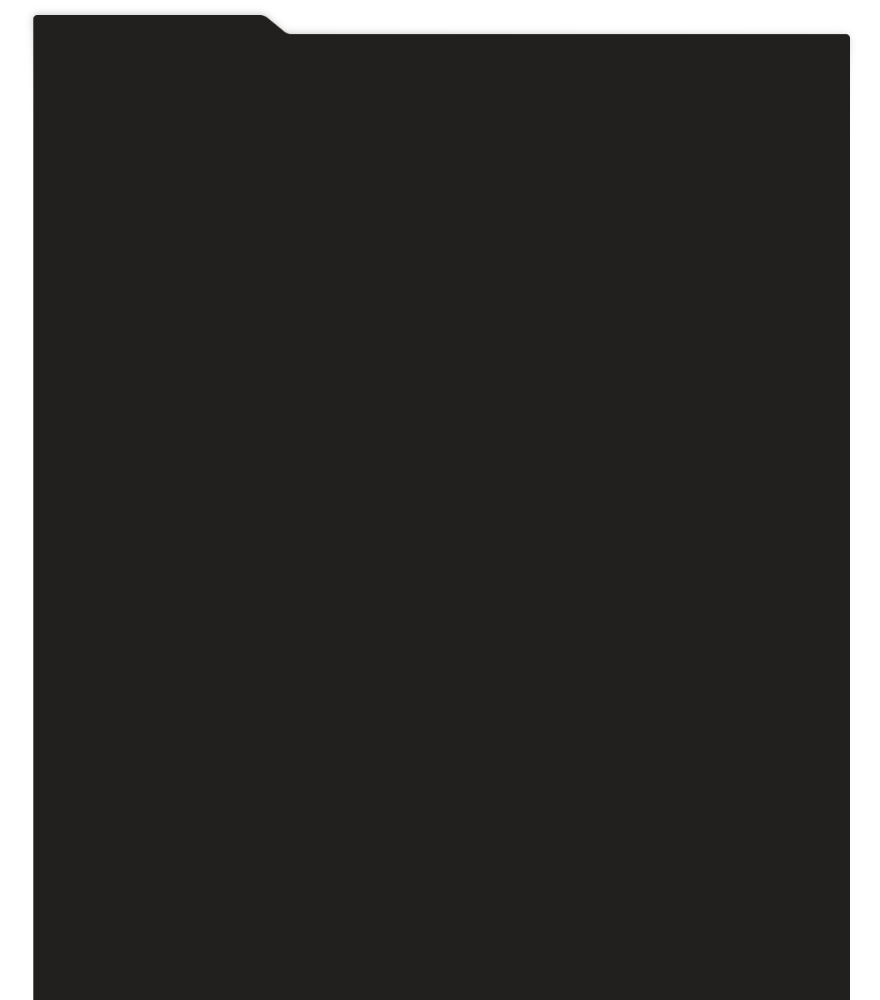
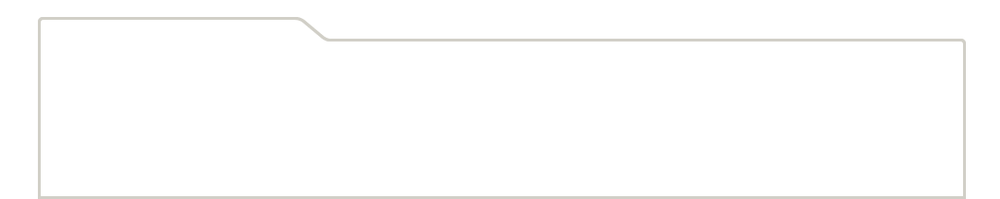
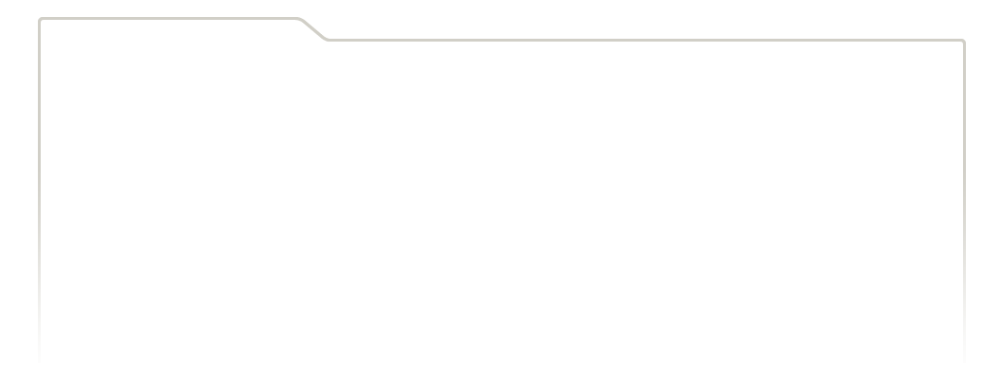
...
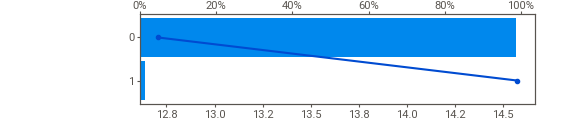
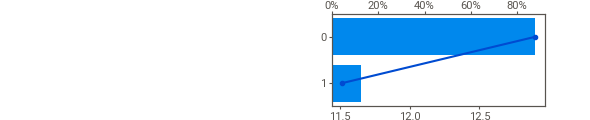
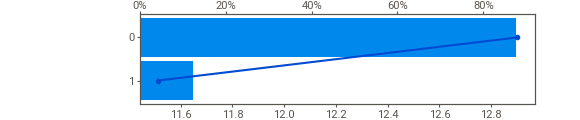
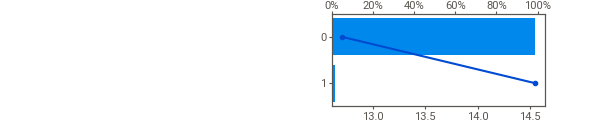
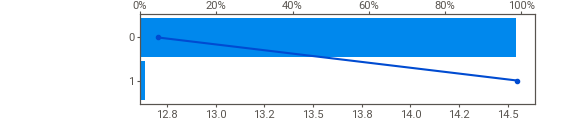

In [88]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_accepted_2018 = sweetviz.analyze(
            [accepted_train, "Accepted loans (train)"],
            target_feat="int_rate",
            pairwise_analysis="off",
        )
        report_accepted_2018.show_notebook()

### Separate Target Variables

As there are 3 sub-tasks (predict grade, sub-grade, and interest rate), **3** separate **target variables** for each set of predictors will be created.

In [5]:
X_train = accepted_train.drop(columns=["grade", "sub_grade", "int_rate"])
y_train_grades = accepted_train["grade"]
y_train_subgrades = accepted_train["sub_grade"]
y_train_int_rate = accepted_train["int_rate"]

X_validation = accepted_validation.drop(columns=["grade", "sub_grade", "int_rate"])
y_validation_grades = accepted_validation["grade"]
y_validation_subgrades = accepted_validation["sub_grade"]
y_validation_int_rate = accepted_validation["int_rate"]

X_test = accepted_test.drop(columns=["grade", "sub_grade", "int_rate"])
y_test_grades = accepted_test["grade"]
y_test_subgrades = accepted_test["sub_grade"]
y_test_int_rate = accepted_test["int_rate"]

## Loan Grade Prediction

This section focuses on predicting loan **grades**.

### Train Models

Here **5 models** will be trained:

- logistic regression (LR);
- Naive Bayes (NB);
- LGBM;
- Combination of all 3 models (LR, NB, and LGBM) with soft voting;
- Combination of all 3 models (LR, NB, and LGBM) with hard voting.

In [10]:
# Dictionary to collect the results
models_grades = {}

In [11]:
@my.cache_results(dir_interim + "models_2_01_naive_bayes.pickle")
def fit_nb_grades():
    """Fit a Naive Bayes model."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_lr)),
            ("classifier", GaussianNB()),
        ]
    )
    pipeline.fit(X_train, y_train_grades)

    return pipeline


models_grades["Naive Bayes"] = fit_nb_grades()

In [12]:
@my.cache_results(dir_interim + "models_2_02_logistic_regression_sgd.pickle")
def fit_lr_sgd_grades():
    """Fit a Logistic Regression model (via SGD training)."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_lr)),
            (
                "classifier",
                SGDClassifier(
                    random_state=1, loss="log_loss", n_jobs=-1, class_weight="balanced"
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_grades)

    return pipeline


models_grades["Logistic Regression"] = fit_lr_sgd_grades()

In [13]:
@my.cache_results(dir_interim + "models_2_03_lgbm--test.pickle")
def fit_lgbm_grades():
    """Fit a LGBM model."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_trees)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="multiclass",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_grades)
    return pipeline


# Time: 1m 1.9s
models_grades["LGBM"] = fit_lgbm_grades()

In [14]:
@my.cache_results(dir_interim + "models_2_04_voting_soft.pickle")
def fit_voting_soft_grades():
    """Fit a voting classifier with soft voting."""

    classifiers = [
        ("GaussianNB", GaussianNB()),
        (
            "SGDClassifier",
            SGDClassifier(
                random_state=1, loss="log_loss", n_jobs=-1, class_weight="balanced"
            ),
        ),
        (
            "LGBMClassifier",
            LGBMClassifier(
                random_state=1,
                class_weight="balanced",
                objective="multiclass",
                n_jobs=-1,
                device="gpu",
                verbosity=1,
            ),
        ),
    ]

    voting_classifier = VotingClassifier(classifiers, voting="soft", n_jobs=-1)

    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_lr)),
            ("classifier", voting_classifier),
        ]
    )
    pipeline.fit(X_train, y_train_grades)
    return pipeline


# Time: 1m 7.9s
models_grades["Voting (soft)"] = fit_voting_soft_grades()

In [15]:
@my.cache_results(dir_interim + "models_2_05_voting_hard.pickle")
def fit_voting_hard_grades():
    """Fit a voting classifier with hard voting."""

    classifiers = [
        ("GaussianNB", GaussianNB()),
        (
            "SGDClassifier",
            SGDClassifier(
                random_state=1, loss="log_loss", n_jobs=-1, class_weight="balanced"
            ),
        ),
        (
            "LGBMClassifier",
            LGBMClassifier(
                random_state=1,
                class_weight="balanced",
                objective="multiclass",
                n_jobs=-1,
                device="gpu",
                verbosity=1,
            ),
        ),
    ]

    voting_classifier = VotingClassifier(classifiers, voting="hard", n_jobs=-1)

    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_lr)),
            ("classifier", voting_classifier),
        ]
    )
    pipeline.fit(X_train, y_train_grades)
    return pipeline


# Time: 1m 7.6s
models_grades["Voting (hard)"] = fit_voting_hard_grades()

### Evaluation

Next, the models will be evaluated. Macro-averaged **ROC AUC** (and **F1** scores where ROC AUC is unavailable) will be used as the main performance metric. The results will be compared to the baseline model that always predicts the most frequent class. Two performance metrics are needed as for hard-voting ROC AUC cannot be calculated (it requires probabilities).

**Results:** the best-performing model was **LGBM** with **ROC AUC** of **0.9950** and **F1** of **0.83** in the validation set.

Please, find the details below.

In [60]:
# | code-summary: Functions `print_classification_report_for_grades()`, etc.
# | code-fold: false


# Report that includes ROC AUC
def print_classification_report_for_grades(models, model_name, include_roc_auc=True):
    """Make a classification report for a given model.

    Creates classification reports on training and validation sets.
    Args:
        models (dict|scikit learn model): Either a dictionary with models or a model.
        model_name (str): The name of the model to be evaluated.
        include_roc_auc (bool): Whether to include ROC AUC in the report.
    """
    ml.print_classification_report(
        models,
        model_name,
        X_train,
        X_validation,
        y_train_grades,
        y_validation_grades,
        label_train_set="Train",
        label_test_set="Validation",
        label_model=model_name,
        include_roc_auc=include_roc_auc,
    )

In [54]:
dummy_grades = DummyClassifier(strategy="most_frequent")
dummy_grades.fit(X_train, y_train_grades)

print_classification_report_for_grades(dummy_grades, "baseline")

--- Train (baseline) ---
ROC AUC: 0.5000 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.00      0.00      0.00     94625
           B       0.29      1.00      0.44     98955
           C       0.00      0.00      0.00     88794
           D       0.00      0.00      0.00     48333
           E       0.00      0.00      0.00     13270
           F       0.00      0.00      0.00      2222
           G       0.00      0.00      0.00       470

    accuracy                           0.29    346669
   macro avg       0.04      0.14      0.06    346669
weighted avg       0.08      0.29      0.13    346669


--- Validation (baseline) ---
ROC AUC: 0.5000 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.00      0.00      0.00     20275
           B       0.29      1.00      0.44     21203
           C       0.00      0.00      0.00     19027
           D       0.00      0.0

Evaluation of Naive Bayes model:

In [55]:
print_classification_report_for_grades(models_grades, "Naive Bayes")

--- Train (Naive Bayes) ---
ROC AUC: 0.7387 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.58      0.71      0.64     94625
           B       0.32      0.57      0.41     98955
           C       0.35      0.02      0.03     88794
           D       0.38      0.09      0.14     48333
           E       0.14      0.06      0.08     13270
           F       0.04      0.31      0.07      2222
           G       0.01      0.29      0.02       470

    accuracy                           0.38    346669
   macro avg       0.26      0.29      0.20    346669
weighted avg       0.40      0.38      0.32    346669


--- Validation (Naive Bayes) ---
ROC AUC: 0.7440 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.58      0.71      0.64     20275
           B       0.32      0.57      0.41     21203
           C       0.36      0.02      0.04     19027
           D       0.39   

Evaluation of Logistic Regression model:

In [56]:
print_classification_report_for_grades(models_grades, "Logistic Regression")

--- Train (Logistic Regression) ---
ROC AUC: 0.9062 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.76      0.89      0.82     94625
           B       0.61      0.50      0.55     98955
           C       0.56      0.49      0.52     88794
           D       0.53      0.51      0.52     48333
           E       0.33      0.57      0.42     13270
           F       0.16      0.14      0.15      2222
           G       0.07      0.72      0.12       470

    accuracy                           0.61    346669
   macro avg       0.43      0.55      0.44    346669
weighted avg       0.61      0.61      0.61    346669


--- Validation (Logistic Regression) ---
ROC AUC: 0.9036 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.76      0.89      0.82     20275
           B       0.60      0.50      0.55     21203
           C       0.56      0.48      0.52     19027
          

Evaluation of LGBM model:

In [57]:
print_classification_report_for_grades(models_grades, "LGBM")

--- Train (LGBM) ---
ROC AUC: 0.9963 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.96      0.98      0.97     94625
           B       0.93      0.92      0.92     98955
           C       0.94      0.90      0.92     88794
           D       0.93      0.92      0.92     48333
           E       0.85      0.96      0.90     13270
           F       0.91      1.00      0.95      2222
           G       0.80      1.00      0.89       470

    accuracy                           0.93    346669
   macro avg       0.90      0.95      0.92    346669
weighted avg       0.93      0.93      0.93    346669


--- Validation (LGBM) ---
ROC AUC: 0.9950 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.96      0.98      0.97     20275
           B       0.92      0.92      0.92     21203
           C       0.93      0.90      0.91     19027
           D       0.92      0.91      0

Evaluate the soft voting ensemble model:

In [58]:
print_classification_report_for_grades(models_grades, "Voting (soft)")

--- Train (Voting (soft)) ---
ROC AUC: 0.9858 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.76      0.95      0.84     94625
           B       0.98      0.65      0.78     98955
           C       0.98      0.63      0.77     88794
           D       0.90      0.65      0.75     48333
           E       0.78      0.64      0.70     13270
           F       0.54      0.22      0.31      2222
           G       0.01      0.99      0.02       470

    accuracy                           0.72    346669
   macro avg       0.70      0.67      0.60    346669
weighted avg       0.89      0.72      0.78    346669


--- Validation (Voting (soft)) ---
ROC AUC: 0.9823 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.75      0.94      0.84     20275
           B       0.98      0.64      0.77     21203
           C       0.98      0.63      0.76     19027
           D       0.9

Evaluate the hard voting ensemble model (no AUC is calculated):

In [59]:
# NOTE: for hard voting `.predict_proba` is not available.
print_classification_report_for_grades(
    models_grades, "Voting (hard)", include_roc_auc=False
)

--- Train (Voting (hard)) ---
              precision    recall  f1-score   support

           A       0.67      0.99      0.80     94625
           B       0.75      0.67      0.71     98955
           C       0.83      0.64      0.73     88794
           D       0.86      0.59      0.70     48333
           E       0.75      0.62      0.68     13270
           F       0.89      0.15      0.26      2222
           G       0.09      0.99      0.16       470

    accuracy                           0.73    346669
   macro avg       0.69      0.66      0.58    346669
weighted avg       0.76      0.73      0.73    346669


--- Validation (Voting (hard)) ---
              precision    recall  f1-score   support

           A       0.67      0.99      0.80     20275
           B       0.74      0.66      0.70     21203
           C       0.82      0.64      0.72     19027
           D       0.85      0.59      0.70     10355
           E       0.75      0.60      0.67      2846
           F

The best-performing model is LGBM. It will be explored in more detail.

In [ ]:
y_pred_validation_lgbm_grades = models_grades["LGBM"].predict(X_validation)

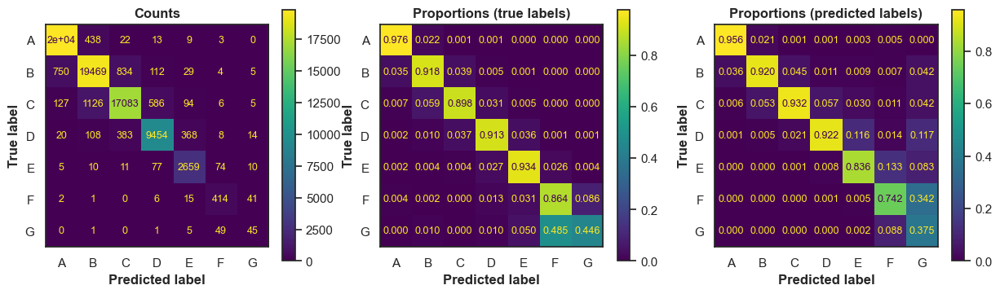

In [ ]:
sns.set_style("white")
ml.plot_confusion_matrices(
    y_validation_grades,
    y_pred_validation_lgbm_grades,
    figsize=(15, 4),
    text_kw={"size": 9},
);

It seems that the highest confusion is between F and G grades.

### Feature Importance (General)

**Internal LGBM** method as well as **SHAP** values were used to evaluate feature importance. Variables `total_rec_int`, `total_rec_prncp` and `installment` were identified as the most important ones by both methods just in different order.

Please, find the details below.

In [17]:
@my.cache_results(dir_interim + "task-2-grades--shap_lgbm_k=all.pkl")
def get_shap_values_grades_lgbm():
    model = "LGBM"
    preproc = Pipeline(steps=models_grades[model].steps[:-1])
    classifier = models_grades[model]["classifier"]
    X_validation_preproc = preproc.transform(X_validation)

    tree_explainer = shap.TreeExplainer(classifier)
    shap_values = tree_explainer.shap_values(X_validation_preproc)

    return shap_values, X_validation_preproc


shap_values_lgbm_grades, data_for_lgbm_grades = get_shap_values_grades_lgbm()
# Time: 3m 17.8s

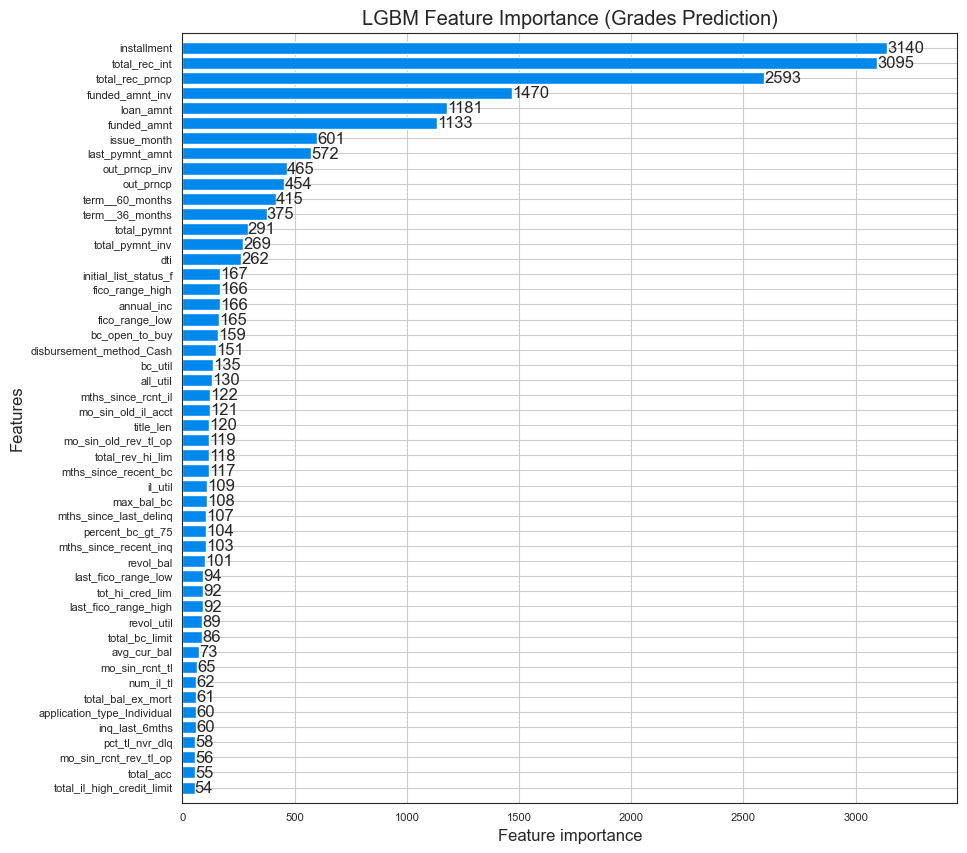

In [106]:
sns.set_style("white")
lgb.plot_importance(
    models_grades["LGBM"]["classifier"],
    max_num_features=50,
    figsize=(10, 10),
    height=0.8,
    title="LGBM Feature Importance (Grades Prediction)",
);

In [18]:
vals = np.abs(shap_values_lgbm_grades).mean(0).mean(0)
feature_importance = (
    pd.DataFrame(
        list(zip(data_for_lgbm_grades.columns, vals)),
        columns=["col_name", "importance"],
    )
    .sort_values(by=["importance"], ascending=False)
    .reset_index()
)

feature_importance.query("importance > 0.01").head().style.format(precision=4)

,index,col_name,importance
0,22,total_rec_int,0.7640
1,21,total_rec_prncp,0.4286
2,3,installment,0.3728
3,2,funded_amnt_inv,0.1921
4,120,initial_list_status_f,0.1906


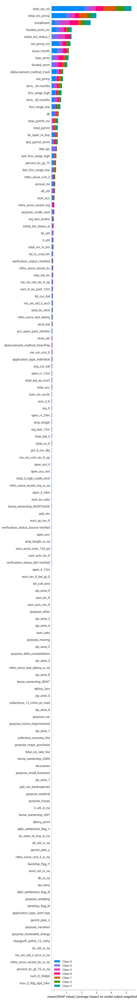

In [ ]:
shap.summary_plot(
    shap_values_lgbm_grades, data_for_lgbm_grades, plot_type="bar", max_display=150
)

### Feature Importance (by Grade)

Analyzing feature importance by grade, it seems that for higher grade prediction, total interest received (`total_rec_int`) is the most important feature, while for lower grade prediction, the most important feature monthly installment size (`installment`).

Find the details below.

In [ ]:
# | code-summary: Code of `shap_summary_plot__grades()`
# | code-fold: false


def shap_summary_plot__grades(gr_index):
    """Convenience function to plot SHAP summary plot for a given grade.

    Args:
        gr_index (int): The index of the grade to plot.
    """
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        shap.summary_plot(
            shap_values_lgbm_grades[gr_index],
            data_for_lgbm_grades,
            plot_type="dot",
            max_display=20,
            plot_size=(10, 6),
        )

Feature importances for **Grade A**:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


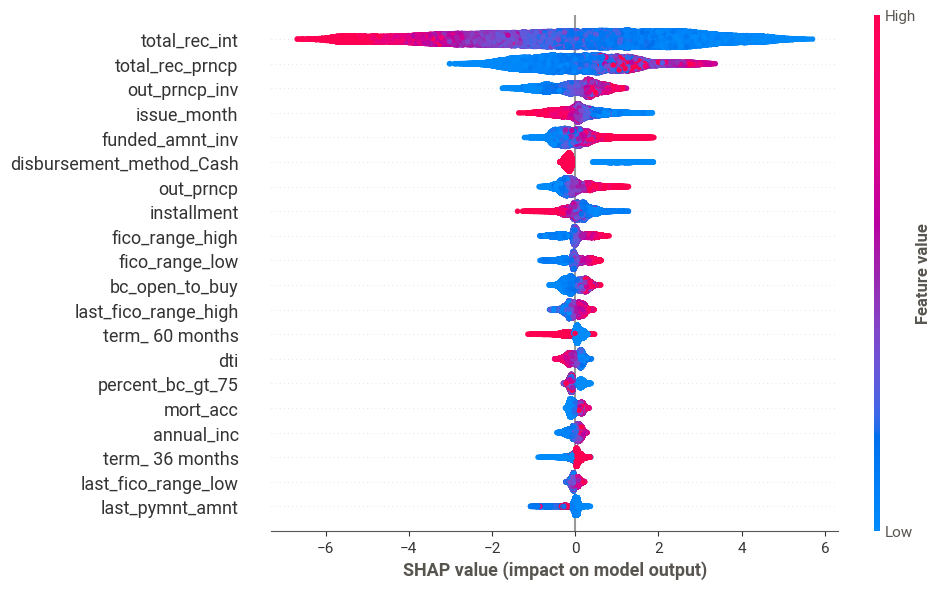

In [ ]:
shap_summary_plot__grades(0)

Feature importances for **Grade B**:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


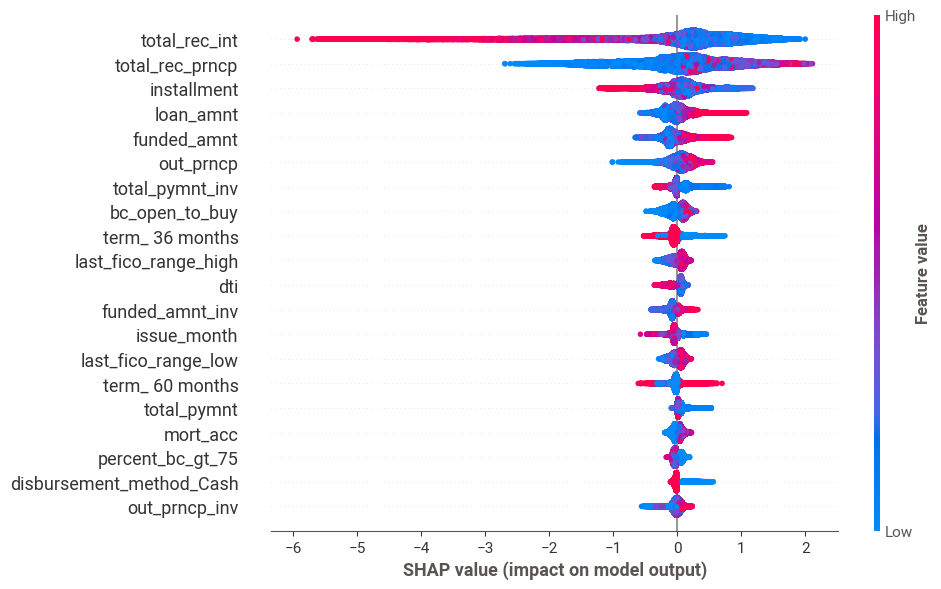

In [ ]:
shap_summary_plot__grades(1)

Feature importances for **Grade C**:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


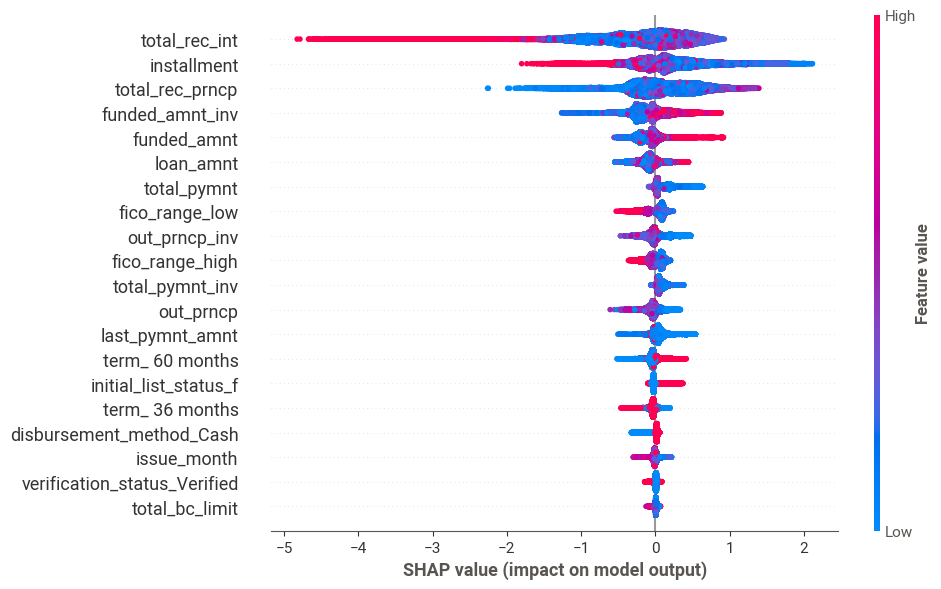

In [ ]:
shap_summary_plot__grades(2)

Feature importances for **Grade D**:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


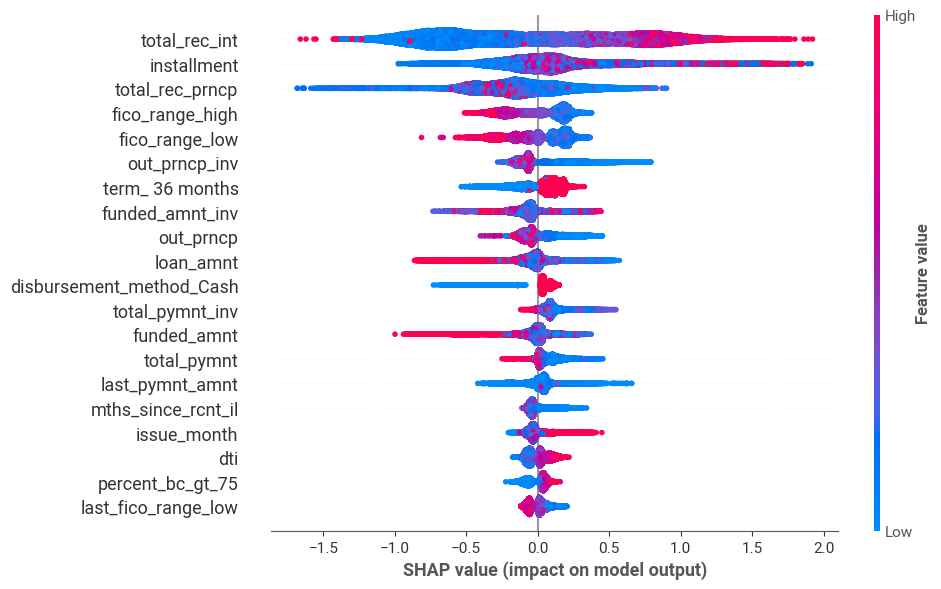

In [ ]:
shap_summary_plot__grades(3)

Feature importances for **Grade E**:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


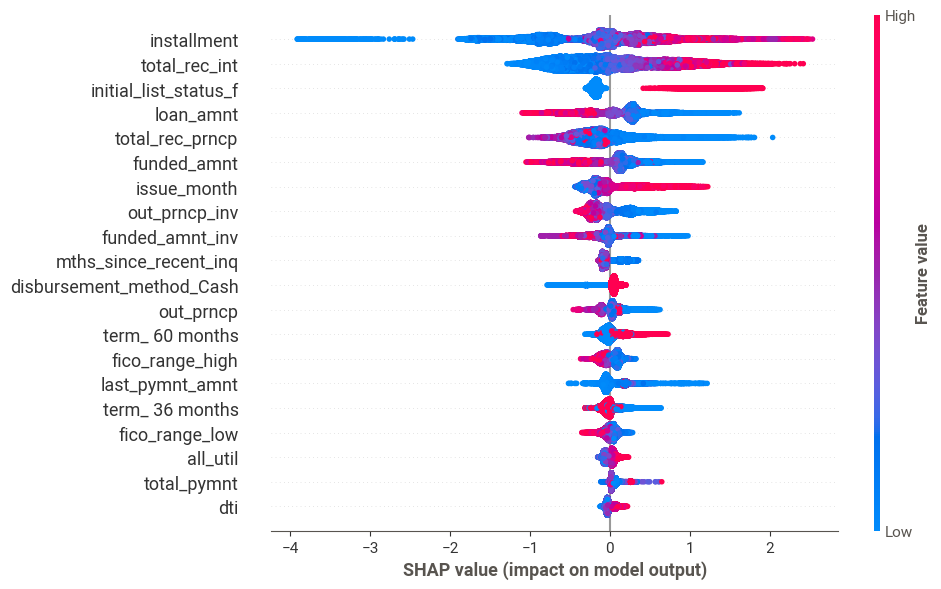

In [ ]:
shap_summary_plot__grades(4)

Feature importances for **Grade F**:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


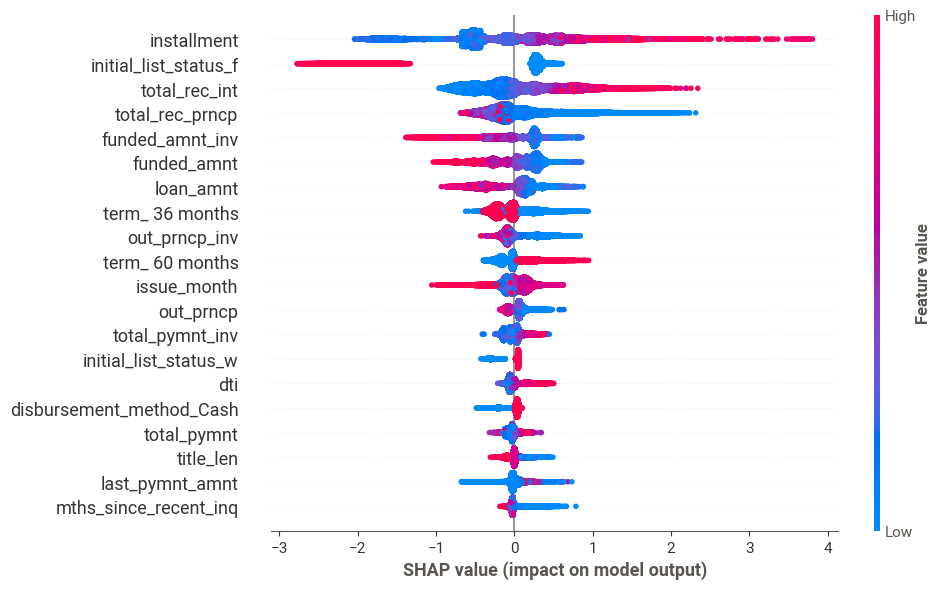

In [ ]:
shap_summary_plot__grades(5)

Feature importances for **Grade G**:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


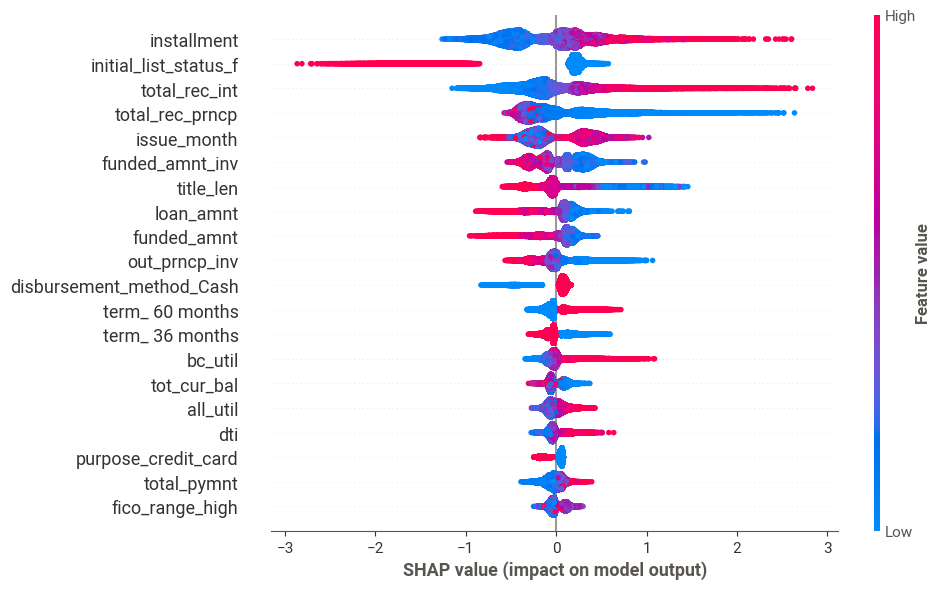

In [ ]:
shap_summary_plot__grades(6)

### Re-Train Models on the Most Important Features

The LGBM model will be trained on a smaller number of features (41, 30, and 13). This number of features was selected using 0.010, 0.025, and 0.090 cut-off thresholds of SHAP feature importance. The model with 13 features showed the best overall performance (see @tbl-13-features-overall) and improvement of classification accuracy for most of the grades except grade F (see @tbl-13-features-by-grade).

<!-- ... -->

: Overall classification performance (validation set) of the LGBM models with all 140 (all) and 13 features. {#tbl-13-features-overall}


Number of features | ROC AUC (validation)
-------------------|-------------------
140 (all)          |  0.9950
45                 |  0.9950 
30                 |  0.9951
13                 |  **0.9967**

<!-- ... -->

: Classification performance by grade (validation set) of the LGBM models with all 140 (all) and 13 features. {#tbl-13-features-by-grade}

Grade | F1 (all features)   | F1 (13 features)
----  | ------              | ------  
 A    |     0.97            |  **0.98**
 B    |     0.92            |  **0.94**
 C    |     0.91            |  **0.93**
 D    |     0.92            |  **0.94**
 E    |     0.88            |  **0.90**
 F    |   **0.80**          |  0.78
 G    |     0.41            |  **0.49**

Please, find more details below.

In [19]:
# | code-summary: Code to train LGBM with 45, 30 and 13 features
# | code-fold: false
def fit_lgbm_grades_with_selection(features):
    """Template to fit a LGBM model with a smalled number of features."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_trees)),
            ("selector", ColumnSelector(features)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="multiclass",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_grades)
    return pipeline


@my.cache_results(dir_interim + "models_2_03_lgbm-45-features.pickle")
def fit_lgbm_grades_45():
    features = feature_importance.query("importance > 0.010").col_name.to_list()
    return fit_lgbm_grades_with_selection(features)


@my.cache_results(dir_interim + "models_2_03_lgbm-30-features.pickle")
def fit_lgbm_grades_30():
    features = feature_importance.query("importance > 0.025").col_name.to_list()
    return fit_lgbm_grades_with_selection(features)


@my.cache_results(dir_interim + "models_2_03_lgbm-13-features.pickle")
def fit_lgbm_grades_13():
    features = feature_importance.query("importance > 0.090").col_name.to_list()
    return fit_lgbm_grades_with_selection(features)

In [20]:
models_grades["LGBM (45 features)"] = fit_lgbm_grades_45()

In [21]:
models_grades["LGBM (30 features)"] = fit_lgbm_grades_30()

In [22]:
models_grades["LGBM (13 features)"] = fit_lgbm_grades_13()

In [ ]:
print_classification_report_for_grades(models_grades, "LGBM (45 features)")

--- Train (LGBM (45 features)) ---
ROC AUC: 0.9964 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.96      0.98      0.97     94625
           B       0.93      0.92      0.92     98955
           C       0.94      0.91      0.92     88794
           D       0.93      0.92      0.92     48333
           E       0.85      0.96      0.90     13270
           F       0.91      1.00      0.95      2222
           G       0.77      1.00      0.87       470

    accuracy                           0.94    346669
   macro avg       0.90      0.96      0.92    346669
weighted avg       0.94      0.94      0.94    346669

--- Validation (LGBM (45 features)) ---
ROC AUC: 0.9950 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.96      0.98      0.97     20275
           B       0.92      0.92      0.92     21203
           C       0.93      0.90      0.91     19027
           D 

In [ ]:
print_classification_report_for_grades(models_grades, "LGBM (30 features)")

--- Train (LGBM (30 features)) ---
ROC AUC: 0.9965 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.96      0.98      0.97     94625
           B       0.93      0.93      0.93     98955
           C       0.94      0.91      0.92     88794
           D       0.93      0.92      0.93     48333
           E       0.85      0.96      0.90     13270
           F       0.87      0.99      0.93      2222
           G       0.72      1.00      0.84       470

    accuracy                           0.94    346669
   macro avg       0.89      0.95      0.92    346669
weighted avg       0.94      0.94      0.94    346669

--- Validation (LGBM (30 features)) ---
ROC AUC: 0.9951 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.96      0.98      0.97     20275
           B       0.92      0.92      0.92     21203
           C       0.93      0.90      0.92     19027
           D 

In [ ]:
print_classification_report_for_grades(models_grades, "LGBM (13 features)")

--- Train (LGBM (13 features)) ---
ROC AUC: 0.9976 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.97      0.99      0.98     94625
           B       0.95      0.94      0.94     98955
           C       0.95      0.92      0.94     88794
           D       0.95      0.93      0.94     48333
           E       0.88      0.96      0.92     13270
           F       0.87      0.94      0.90      2222
           G       0.64      1.00      0.78       470

    accuracy                           0.95    346669
   macro avg       0.89      0.96      0.91    346669
weighted avg       0.95      0.95      0.95    346669

--- Validation (LGBM (13 features)) ---
ROC AUC: 0.9967 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.97      0.99      0.98     20275
           B       0.94      0.94      0.94     21203
           C       0.95      0.92      0.93     19027
           D 

The model with 13 features performed best. Let's analyze it in more detail.

The 13 features are:

In [111]:
feature_importance.head(13).col_name.to_list()

['total_rec_int',
 'total_rec_prncp',
 'installment',
 'funded_amnt_inv',
 'initial_list_status_f',
 'out_prncp_inv',
 'issue_month',
 'loan_amnt',
 'funded_amnt',
 'disbursement_method_Cash',
 'out_prncp',
 'term_ 36 months',
 'fico_range_high']

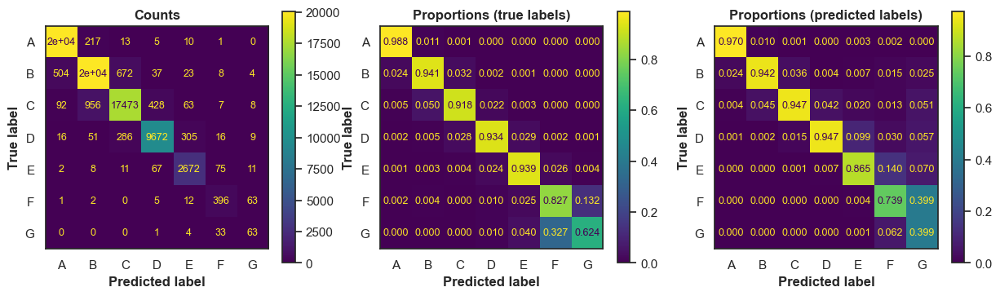

In [ ]:
y_pred_validation_lgbm_grades_13 = models_grades["LGBM (13 features)"].predict(
    X_validation
)
sns.set_style("white")
ml.plot_confusion_matrices(
    y_validation_grades,
    y_pred_validation_lgbm_grades_13,
    figsize=(15, 4),
    text_kw={"size": 9},
);

LGBM model with 13 features showed the best ROC AUC value of 0.9967 (validation). Comparing each grade separately, in the 13-feature model, F1 scores improved in all grades except Grade F (see @tbl-13-features-by-grade).

### Evaluation on Test Set

The final model evaluation on the test set shows **ROC AUC** of **0.9968**.

Please, find the details below.

In [29]:
# Model input variables
grade_model_input = [
    "total_rec_int",
    "total_rec_prncp",
    "installment",
    "funded_amnt_inv",
    "initial_list_status_f",
    "out_prncp_inv",
    "issue_month",
    "loan_amnt",
    "funded_amnt",
    "disbursement_method_Cash",
    "out_prncp",
    "term_ 36 months",
    "fico_range_high",
]

In [61]:
X_train_validation = pd.concat([X_train, X_validation], axis="index")
y_train_validation_grades = pd.concat(
    [y_train_grades, y_validation_grades], axis="index"
)


@my.cache_results(dir_interim + "models_2_03_lgbm--final-evaluation.pickle")
def fit_lgbm_grades_final_evaluation():
    """Fit a LGBM model for final testing."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_trees)),
            ("selector", ColumnSelector(grade_model_input)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="multiclass",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train_validation, y_train_validation_grades)
    return pipeline


models_grades["LGBM (final evaluation)"] = fit_lgbm_grades_final_evaluation()

In [62]:
ml.print_classification_report(
    models=models_grades,
    model_name="LGBM (final evaluation)",
    X_train=X_train_validation,
    X_test=X_test,
    y_train=y_train_validation_grades,
    y_test=y_test_grades,
    label_train_set="Train + Validation",
    label_test_set="Test",
    label_model="Final evaluation",
)

--- Train + Validation (Final evaluation) ---
ROC AUC: 0.9976 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.97      0.99      0.98    114900
           B       0.94      0.94      0.94    120158
           C       0.95      0.92      0.93    107821
           D       0.95      0.93      0.94     58688
           E       0.88      0.96      0.92     16116
           F       0.87      0.92      0.90      2701
           G       0.60      1.00      0.75       571

    accuracy                           0.95    420955
   macro avg       0.88      0.95      0.91    420955
weighted avg       0.95      0.95      0.95    420955


--- Test (Final evaluation) ---
ROC AUC: 0.9968 (one-versus-rest macro average)

              precision    recall  f1-score   support

           A       0.97      0.99      0.98     20277
           B       0.94      0.94      0.94     21207
           C       0.94      0.92      0.93     19029
         

Confusion matrices for the test set:

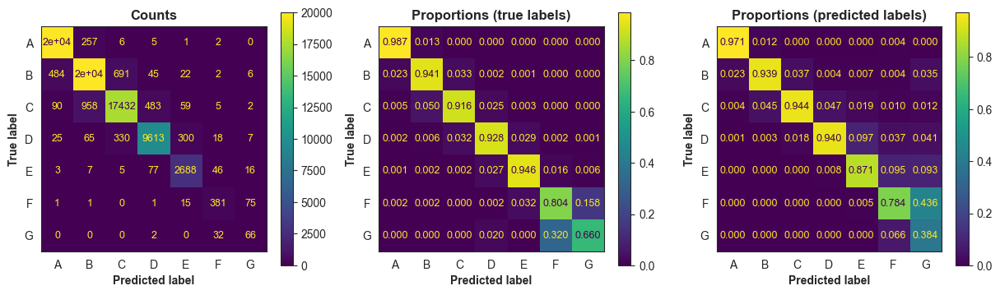

In [63]:
y_pred_test = models_grades["LGBM (final evaluation)"].predict(X_test)

sns.set_style("white")
ml.plot_confusion_matrices(y_test, y_pred_test, figsize=(15, 4), text_kw={"size": 9});

### Final Model for Deployment

In this section, the final pre-processing and prediction pipeline will be created and trained on the whole dataset. The model will be saved into a pickle file and deployed on Google Cloud Platform (GCP).

In [ ]:
# Pipeline input variables
grade_pipeline_input = [
    "total_rec_int",
    "total_rec_prncp",
    "installment",
    "funded_amnt_inv",
    "initial_list_status",
    "out_prncp_inv",
    "issue_d",
    "loan_amnt",
    "funded_amnt",
    "disbursement_method",
    "out_prncp",
    "term",
    "fico_range_high",
]


@my.cache_results(dir_interim + "02--model_predict_grade.pkl")
def fit_lgbm_grades_final():
    """Final LGBM model for grades prediction."""
    pipeline = Pipeline(
        steps=[
            ("selector_1", ColumnSelector(grade_pipeline_input)),
            ("preprocessor_1", PreprocessorForGrades()),
            ("preprocessor_2", clone(pre_processing_trees)),
            ("selector_2", ColumnSelector(grade_model_input)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="multiclass",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )

    # Load required dataset
    data_file_path = dir_interim + "task-2--1-accepted_loans_2018--raw.feather"
    accepted_2018 = pd.read_feather(data_file_path)

    pipeline.set_output(transform="pandas")
    pipeline.fit(accepted_2018, accepted_2018["grade"])
    return pipeline


# Fit the model
loan_grade_predictor_final = fit_lgbm_grades_final()
loan_grade_predictor_final

## Loan Sub-Grade Prediction

This section focuses on predicting loan **sub-grades**.

### Train Models

Here **3 models** will be trained:

-   logistic regression (LR);
-   Naive Bayes (NB);
-   LGBM.

The voting ensemble model will *not* be trained as it did not improve the performance in the grade prediction task.

In [65]:
# Dictionary to collect the results
models_subgrades = {}

In [66]:
@my.cache_results(dir_interim + "models_3_01_naive_bayes.pickle")
def fit_nb_subgrades():
    """Fit a Naive Bayes model."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_lr)),
            ("classifier", GaussianNB()),
        ]
    )
    pipeline.fit(X_train, y_train_subgrades)
    return pipeline


models_subgrades["Naive Bayes"] = fit_nb_subgrades()
# Time: 13.3s

In [67]:
@my.cache_results(dir_interim + "models_3_02_logistic_regression_sgd.pickle")
def fit_lr_sgd_subgrades():
    """Fit a Logistic Regression model (via SGD training)."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_lr)),
            (
                "classifier",
                SGDClassifier(
                    random_state=1, loss="log_loss", n_jobs=-1, class_weight="balanced"
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_subgrades)
    return pipeline


models_subgrades["Logistic Regression"] = fit_lr_sgd_subgrades()
# Time: 50.5s

In [68]:
@my.cache_results(dir_interim + "models_3_03_lgbm.pickle")
def fit_lgbm_subgrades():
    """Fit a LGBM model."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_trees)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="multiclass",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_subgrades)
    return pipeline


models_subgrades["LGBM"] = fit_lgbm_subgrades()
# Time: 3m 23.9s

### Evaluation

Next, the models will be evaluated. Macro-averaged **ROC AUC** will be used as the main performance metric and **F1** score as an additional one. The results will be compared to the baseline model that always predicts the most frequent class.

**Results:** the best-performing model was **LGBM** with **ROC AUC** of **0.9668** and **F1** of **0.58** in the validation set. Most correctly classified are subgrades from A1 to D5 and the highest confusion is between the lowest grades (F4 to G5), and for sug-brades from G2 to G5 there were no correct predictions at all.

In the baseline model, ROC AUC was 0.5 and F1 was 0.0.

Find the details below.

In [70]:
# | code-summary: Code of `print_classification_report_for_subgrades()`
# | code-fold: false


def print_classification_report_for_subgrades(models, model_name, include_roc_auc=True):
    """Make a classification report for a given model.

    Creates classification reports on training and validation sets.
    Args:
        models (dict|scikit learn model): Either a dictionary with models or a model.
        model_name (str): The name of the model to be evaluated.
        include_roc_auc (bool): Whether to include ROC AUC in the report.
    """
    ml.print_classification_report(
        models,
        model_name,
        X_train,
        X_validation,
        y_train_subgrades,
        y_validation_subgrades,
        label_train_set="Train",
        label_test_set="Validation",
        label_model=model_name,
        include_roc_auc=include_roc_auc,
    )

In [72]:
dummy_subgrades = DummyClassifier(strategy="most_frequent")
dummy_subgrades.fit(X_train, y_train_subgrades)

print_classification_report_for_subgrades(dummy_subgrades, "baseline")

--- Train (baseline) ---
ROC AUC: 0.5000 (one-versus-rest macro average)

              precision    recall  f1-score   support

          A1       0.00      0.00      0.00     20221
          A2       0.00      0.00      0.00     16010
          A3       0.00      0.00      0.00     17685
          A4       0.00      0.00      0.00     22154
          A5       0.00      0.00      0.00     18555
          B1       0.00      0.00      0.00     19626
          B2       0.00      0.00      0.00     20671
          B3       0.00      0.00      0.00     16223
          B4       0.06      1.00      0.12     22209
          B5       0.00      0.00      0.00     20226
          C1       0.00      0.00      0.00     19874
          C2       0.00      0.00      0.00     17635
          C3       0.00      0.00      0.00     18397
          C4       0.00      0.00      0.00     16885
          C5       0.00      0.00      0.00     16003
          D1       0.00      0.00      0.00     11457
       

Evaluation of Naive Bayes model:

In [ ]:
print_classification_report_for_subgrades(models_subgrades, "Naive Bayes")

--- Train (Naive Bayes) ---
ROC AUC: 0.5804 (one-versus-rest macro average)

              precision    recall  f1-score   support

          A1       0.14      0.19      0.16     20221
          A2       0.15      0.01      0.02     16010
          A3       0.08      0.00      0.00     17685
          A4       0.00      0.00      0.00     22154
          A5       0.00      0.00      0.00     18555
          B1       0.06      0.00      0.00     19626
          B2       0.00      0.00      0.00     20671
          B3       0.00      0.00      0.00     16223
          B4       0.07      0.00      0.00     22209
          B5       0.00      0.00      0.00     20226
          C1       0.04      0.00      0.00     19874
          C2       0.03      0.00      0.00     17635
          C3       0.00      0.00      0.00     18397
          C4       0.05      0.00      0.00     16885
          C5       0.33      0.00      0.00     16003
          D1       0.04      0.00      0.00     11457
    

Evaluation of Logistic Regression model:

In [ ]:
print_classification_report_for_subgrades(models_subgrades, "Logistic Regression")

--- Train (Logistic Regression) ---
ROC AUC: 0.8560 (one-versus-rest macro average)

              precision    recall  f1-score   support

          A1       0.46      0.76      0.58     20221
          A2       0.31      0.06      0.10     16010
          A3       0.21      0.30      0.24     17685
          A4       0.21      0.25      0.23     22154
          A5       0.17      0.30      0.22     18555
          B1       0.20      0.05      0.08     19626
          B2       0.18      0.16      0.17     20671
          B3       0.11      0.20      0.14     16223
          B4       0.17      0.04      0.07     22209
          B5       0.15      0.07      0.10     20226
          C1       0.15      0.18      0.16     19874
          C2       0.12      0.03      0.05     17635
          C3       0.14      0.01      0.02     18397
          C4       0.13      0.02      0.03     16885
          C5       0.11      0.15      0.13     16003
          D1       0.09      0.10      0.09     11

Evaluation of LGBM model:

In [ ]:
print_classification_report_for_subgrades(models_subgrades, "LGBM")

--- Train (LGBM) ---
ROC AUC: 0.9933 (one-versus-rest macro average)

              precision    recall  f1-score   support

          A1       0.86      0.91      0.89     20221
          A2       0.72      0.83      0.77     16010
          A3       0.75      0.79      0.77     17685
          A4       0.82      0.72      0.77     22154
          A5       0.74      0.85      0.79     18555
          B1       0.78      0.74      0.76     19626
          B2       0.77      0.70      0.73     20671
          B3       0.65      0.75      0.70     16223
          B4       0.80      0.75      0.78     22209
          B5       0.83      0.78      0.81     20226
          C1       0.82      0.80      0.81     19874
          C2       0.78      0.75      0.77     17635
          C3       0.80      0.78      0.79     18397
          C4       0.83      0.78      0.80     16885
          C5       0.85      0.80      0.83     16003
          D1       0.83      0.84      0.83     11457
          D

The best-performing model is LGBM. It will be explored in more detail.

In [ ]:
y_pred_subgrades_validation_lgbm = models_subgrades["LGBM"].predict(X_validation)

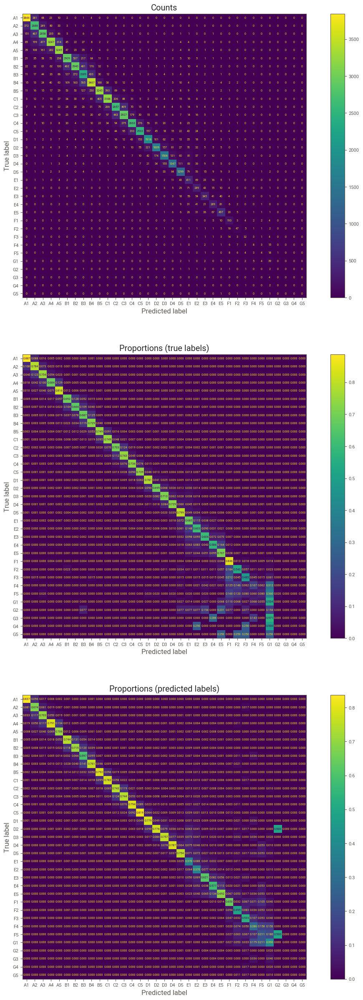

In [ ]:
ml.plot_confusion_matrices(
    y_validation_subgrades,
    y_pred_subgrades_validation_lgbm,
    figsize=(15, 30),
    text_kw={"size": 5},
    layout="vertical",
);

It seems that the highest confusion is between the lowest grades: F4 to G5. In the group of the lowest grades from G2 to G5 no correct prediction at all.

### Feature Importance

Internal LGBM method as well as SHAP values were used to evaluate feature importance. This time it was decided to keep 27 features with the highest SHAP values.

Please, find the details below.

In [74]:
@my.cache_results(dir_interim + "task-2-subgrades--shap_lgbm_k=all.pkl")
def get_shap_values_subgrades_lgbm():
    model = "LGBM"
    preproc = Pipeline(steps=models_subgrades[model].steps[:-1])
    classifier = models_subgrades[model]["classifier"]
    X_validation_preproc = preproc.transform(X_validation)

    tree_explainer = shap.TreeExplainer(classifier)
    shap_values = tree_explainer.shap_values(X_validation_preproc)

    return shap_values, X_validation_preproc


shap_values_lgbm_subgrades, data_for_lgbm_subgrades = get_shap_values_subgrades_lgbm()
# Time: 18m 30.0s

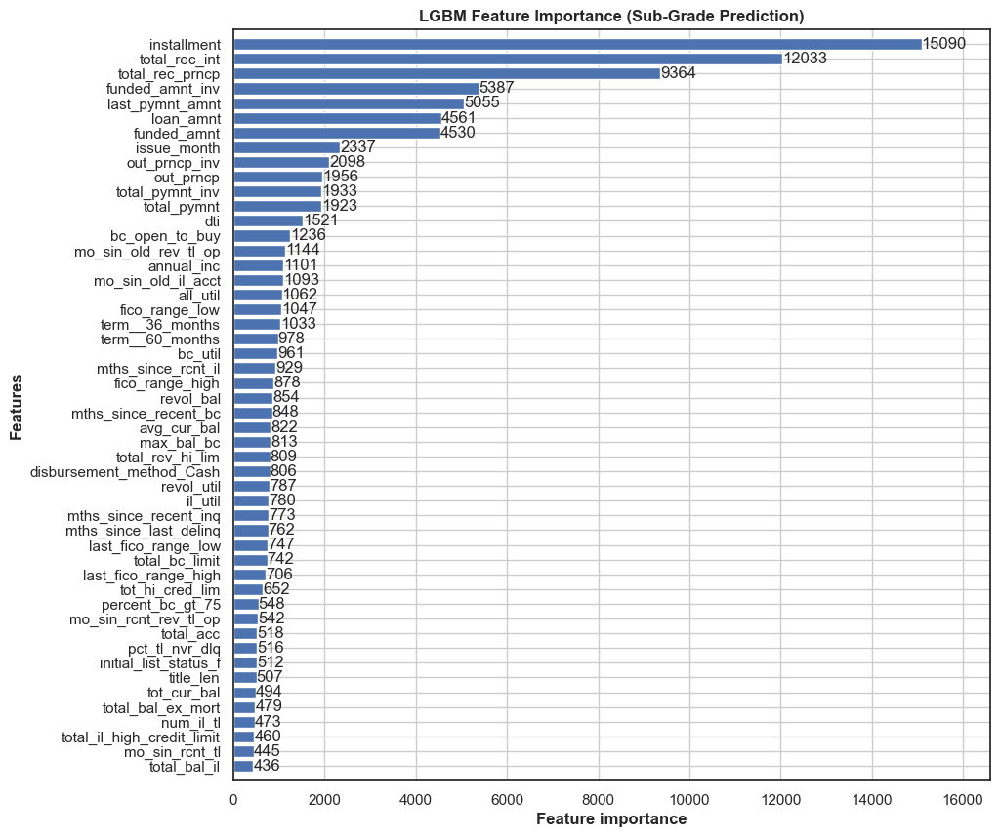

In [ ]:
lgb.plot_importance(
    models_subgrades["LGBM"]["classifier"],
    max_num_features=50,
    figsize=(10, 10),
    height=0.8,
    title="LGBM Feature Importance (Sub-Grade Prediction)",
);

In [75]:
vals_subgrades = np.abs(shap_values_lgbm_subgrades).mean(0).mean(0)
feature_importance_subgrades = (
    pd.DataFrame(
        list(zip(data_for_lgbm_subgrades.columns, vals_subgrades)),
        columns=["col_name", "importance"],
    )
    .sort_values(by=["importance"], ascending=False)
    .reset_index()
)

In [ ]:
feature_importance_subgrades.head(30).style.format(precision=4)

,index,col_name,importance
0,22,total_rec_int,0.6425
1,21,total_rec_prncp,0.3997
2,3,installment,0.3133
3,2,funded_amnt_inv,0.1600
4,0,loan_amnt,0.1322
5,1,funded_amnt,0.1273
6,20,total_pymnt_inv,0.1253
7,126,disbursement_method_Cash,0.1206
8,120,initial_list_status_f,0.1086
9,18,out_prncp_inv,0.1041


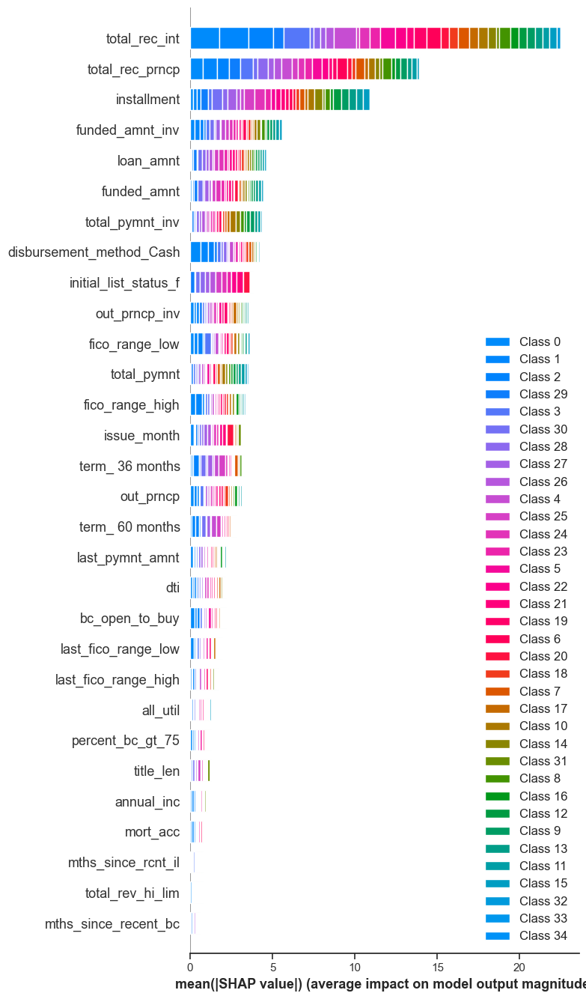

In [ ]:
shap.summary_plot(
    shap_values_lgbm_subgrades, data_for_lgbm_subgrades, plot_type="bar", max_display=30
)

### Re-Train Model on the Most Important Features

By using 27 features instead of 140, the classification performance slightly increased in **ROC AUC** (validation) from 0.9668 to **0.9688** and in **F1** from 0.58 to **0.60** Still, the issues with the lowest subgrades persist.



Find the details below.

In [ ]:
# | code-summary: Code to train LGBM with fewer features
# | code-fold: false


def fit_lgbm_subgrades_with_selection(features):
    """Template to fit a LGBM model with a smaller number of features."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_trees)),
            ("selector", ColumnSelector(features)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="multiclass",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_subgrades)
    return pipeline


@my.cache_results(dir_interim + "models_3_03_lgbm-27-features.pickle")
def fit_lgbm_subgrades_27():
    features = feature_importance.head(27).col_name.to_list()
    return fit_lgbm_subgrades_with_selection(features)

In [ ]:
models_subgrades["LGBM (27 features)"] = fit_lgbm_subgrades_27()
# Time: 2m 5.0 s

In [ ]:
print_classification_report_for_subgrades(models_subgrades, "LGBM (27 features)")

--- Train (LGBM (27 features)) ---
ROC AUC: 0.9934 (one-versus-rest macro average)

              precision    recall  f1-score   support

          A1       0.88      0.92      0.90     20221
          A2       0.74      0.84      0.79     16010
          A3       0.77      0.81      0.79     17685
          A4       0.82      0.74      0.78     22154
          A5       0.76      0.86      0.81     18555
          B1       0.78      0.74      0.76     19626
          B2       0.77      0.72      0.75     20671
          B3       0.65      0.77      0.70     16223
          B4       0.82      0.75      0.78     22209
          B5       0.84      0.78      0.81     20226
          C1       0.81      0.80      0.80     19874
          C2       0.78      0.75      0.77     17635
          C3       0.80      0.78      0.79     18397
          C4       0.83      0.80      0.82     16885
          C5       0.86      0.80      0.83     16003
          D1       0.85      0.83      0.84     114

Confusion matrices for the test set:

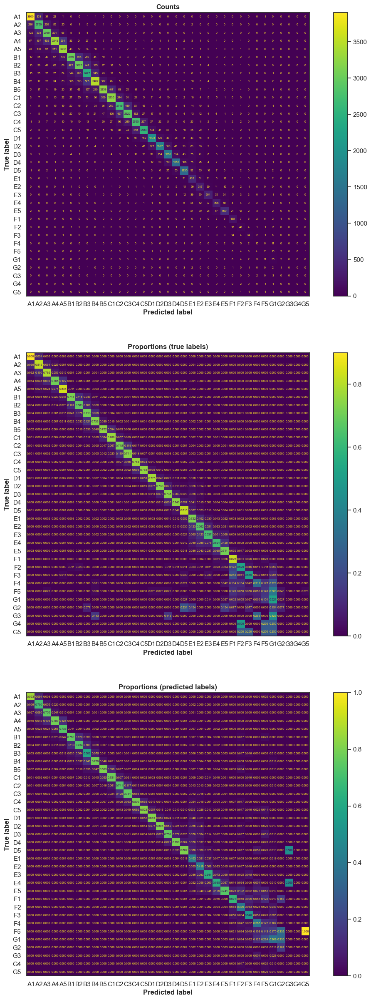

In [ ]:
y_pred_subgrades_validation_lgbm_27 = models_subgrades["LGBM (27 features)"].predict(
    X_validation
)
ml.plot_confusion_matrices(
    y_validation_subgrades,
    y_pred_subgrades_validation_lgbm_27,
    figsize=(15, 30),
    text_kw={"size": 5},
    layout="vertical",
);

### Evaluation on Test Set

The final model evaluation on the test set shows **ROC AUC** of **0.9645** and **F1** score of **0.61**.



Please, find the details below.

In [77]:
# Model input variables
subgrade_model_input = [
    "total_rec_int",
    "total_rec_prncp",
    "installment",
    "funded_amnt_inv",
    "loan_amnt",
    "funded_amnt",
    "total_pymnt_inv",
    "disbursement_method_Cash",
    "initial_list_status_f",
    "out_prncp_inv",
    "fico_range_low",
    "total_pymnt",
    "fico_range_high",
    "issue_month",
    "term_ 36 months",
    "out_prncp",
    "term_ 60 months",
    "last_pymnt_amnt",
    "dti",
    "bc_open_to_buy",
    "last_fico_range_low",
    "last_fico_range_high",
    "all_util",
    "percent_bc_gt_75",
    "title_len",
    "annual_inc",
    "mort_acc",
]

In [ ]:
X_train_validation = pd.concat([X_train, X_validation], axis="index")
y_train_validation_subgrades = pd.concat(
    [y_train_subgrades, y_validation_subgrades], axis="index"
)


@my.cache_results(dir_interim + "models_3_03_lgbm--final-evaluation.pickle")
def fit_lgbm_subgrades_final_evaluation():
    """Fit a LGBM model for final testing."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_trees)),
            ("selector", ColumnSelector(subgrade_model_input)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="multiclass",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train_validation, y_train_validation_subgrades)
    return pipeline


models_subgrades["LGBM (final evaluation)"] = fit_lgbm_subgrades_final_evaluation()

In [79]:
ml.print_classification_report(
    models=models_subgrades,
    model_name="LGBM (final evaluation)",
    X_train=X_train_validation,
    X_test=X_test,
    y_train=y_train_validation_subgrades,
    y_test=y_test_subgrades,
    label_train_set="Train + Validation",
    label_test_set="Test",
    label_model="Final evaluation",
)

--- Train + Validation (Final evaluation) ---
ROC AUC: 0.9932 (one-versus-rest macro average)

              precision    recall  f1-score   support

          A1       0.87      0.92      0.89     24554
          A2       0.73      0.83      0.77     19440
          A3       0.76      0.80      0.78     21474
          A4       0.82      0.74      0.78     26901
          A5       0.74      0.84      0.79     22531
          B1       0.79      0.74      0.76     23831
          B2       0.74      0.72      0.73     25100
          B3       0.64      0.76      0.69     19699
          B4       0.83      0.74      0.79     26968
          B5       0.83      0.78      0.80     24560
          C1       0.83      0.77      0.80     24133
          C2       0.75      0.75      0.75     21414
          C3       0.79      0.76      0.77     22339
          C4       0.84      0.78      0.81     20503
          C5       0.85      0.82      0.84     19432
          D1       0.84      0.83      0

Confusion matrices for the test set:

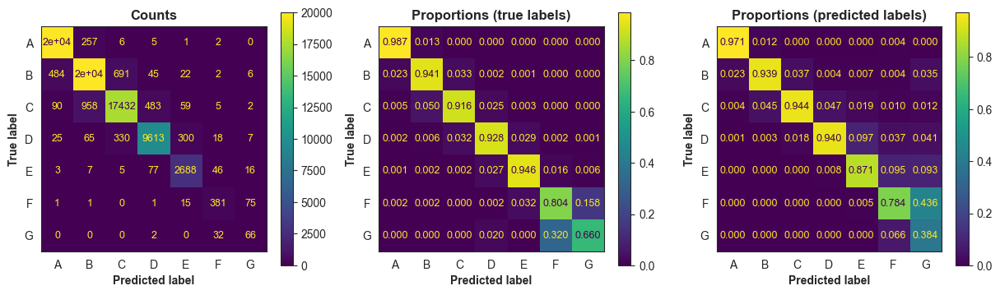

In [ ]:
y_pred_test = models_grades["LGBM (final evaluation)"].predict(X_test)

sns.set_style("white")
ml.plot_confusion_matrices(y_test, y_pred_test, figsize=(15, 4), text_kw={"size": 9});

### Final Model for Deployment

In this section, the final pre-processing and prediction pipeline will be created and trained on the whole dataset. The model will be saved into a pickle file and deployed on Google Cloud Platform (GCP).

In [91]:
# Pipeline input variables
subgrade_pipeline_input = [
    "total_rec_int",
    "total_rec_prncp",
    "installment",
    "funded_amnt_inv",
    "loan_amnt",
    "funded_amnt",
    "total_pymnt_inv",
    "disbursement_method",
    "initial_list_status",
    "out_prncp_inv",
    "fico_range_low",
    "total_pymnt",
    "fico_range_high",
    "issue_d",
    "term",
    "out_prncp",
    "last_pymnt_amnt",
    "dti",
    "bc_open_to_buy",
    "last_fico_range_low",
    "last_fico_range_high",
    "all_util",
    "percent_bc_gt_75",
    "title",
    "annual_inc",
    "mort_acc",
]


@my.cache_results(dir_interim + "03--model_predict_subgrade.pkl")
def fit_lgbm_subgrades_final():
    """Final LGBM model for sub-grades prediction."""
    pipeline = Pipeline(
        steps=[
            ("selector_1", ColumnSelector(subgrade_pipeline_input)),
            ("preprocessor_1", PreprocessorForSubgrades()),
            ("preprocessor_2", clone(pre_processing_trees)),
            ("selector_2", ColumnSelector(subgrade_model_input)),
            (
                "classifier",
                LGBMClassifier(
                    random_state=1,
                    class_weight="balanced",
                    objective="multiclass",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )

    # Load required dataset
    data_file_path = dir_interim + "task-2--1-accepted_loans_2018--raw.feather"
    accepted_2018 = pd.read_feather(data_file_path)

    pipeline.set_output(transform="pandas")
    pipeline.fit(accepted_2018, accepted_2018["sub_grade"])
    return pipeline


# Fit the model
loan_subgrade_predictor_final = fit_lgbm_subgrades_final()
loan_subgrade_predictor_final

# Time: 5m 25.1s

Pipeline(steps=[('selector_1',
                 ColumnSelector(keep=['total_rec_int', 'total_rec_prncp',
                                      'installment', 'funded_amnt_inv',
                                      'loan_amnt', 'funded_amnt',
                                      'total_pymnt_inv', 'disbursement_method',
                                      'initial_list_status', 'out_prncp_inv',
                                      'fico_range_low', 'total_pymnt',
                                      'fico_range_high', 'issue_d', 'term',
                                      'out_prncp', 'last_pymnt_amnt', 'dti',
                                      'bc_open_to_buy', 'last_fico...
                                      'fico_range_high', 'issue_month',
                                      'term_ 36 months', 'out_prncp',
                                      'term_ 60 months', 'last_pymnt_amnt',
                                      'dti', 'bc_open_to_buy',
                                      'last_fico_range_low',
                                      'last_fico_range_high', 'all_util',
                                      'percent_bc_gt_75', 'title_len',
                                      'annual_inc', 'mort_acc'])),
                ('classifier',
                 LGBMClassifier(class_weight='balanced', device='gpu',
                                n_jobs=-1, objective='multiclass',
                                random_state=1, verbosity=1))])

In [95]:
data_file_path = dir_interim + "task-2--1-accepted_loans_2018--raw.feather"
accepted_2018 = pd.read_feather(data_file_path)

accepted_2018[subgrade_pipeline_input].iloc[[23486, 4, 300717]].to_dict(orient="list")

{'total_rec_int': [728.280029296875, 11.579999923706055, 1397.8199462890625],
 'total_rec_prncp': [2723.12, 3000.0, 1399.58],
 'installment': [288.010009765625, 93.0999984741211, 705.3800048828125],
 'funded_amnt_inv': [9000.0, 3000.0, 30000.0],
 'loan_amnt': [9000.0, 3000.0, 30000.0],
 'funded_amnt': [9000.0, 3000.0, 30000.0],
 'total_pymnt_inv': [3451.4, 3011.58, 2797.4],
 'disbursement_method': ['Cash', 'Cash', 'Cash'],
 'initial_list_status': ['w', 'w', 'w'],
 'out_prncp_inv': [6276.88, 0.0, 28600.42],
 'fico_range_low': [715.0, 760.0, 715.0],
 'total_pymnt': [3451.4, 3011.5772850636, 2797.4],
 'fico_range_high': [719.0, 764.0, 719.0],
 'issue_d': ['Mar-2018', 'Mar-2018', 'Nov-2018'],
 'term': [' 36 months', ' 36 months', ' 60 months'],
 'out_prncp': [6276.88, 0.0, 28600.42],
 'last_pymnt_amnt': [288.01, 614.03, 705.38],
 'dti': [14.510000228881836, 0.5799999833106995, 32.220001220703125],
 'bc_open_to_buy': [455.0, 30359.0, 17345.0],
 'last_fico_range_low': [805.0, 760.0, 755.0],


## Interest Rate Prediction

This section focuses on predicting loan **sub-grades**.

### Train Models

Here **4 models** will be trained:

-   linear regression;
-   LASSO regression;
-   Ridge regression;
-   LGBM (regular gradient boosting).


In [6]:
# Dictionary to collect the results
models_int_rate = {}

In [7]:
@my.cache_results(dir_interim + "models_4_01_linear_regression_sgd.pickle")
def fit_lr_sgd_int_rate():
    """Fit a Linear Regression model (via SGD training)."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_lr)),
            (
                "regressor",
                SGDRegressor(
                    random_state=1,
                    loss="squared_error",  # Use 'squared_error' for regression
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_int_rate)
    return pipeline


models_int_rate["Linear Regression"] = fit_lr_sgd_int_rate()

In [8]:
# Function for LASSO Regression
@my.cache_results(dir_interim + "models_4_02_lasso_regression_sgd.pickle")
def fit_lasso_regression():
    """Fit a LASSO Regression model (via SGD training)."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_lr)),
            (
                "regressor",
                SGDRegressor(
                    random_state=1,
                    penalty="l1",  # L1 regularization for LASSO
                    alpha=1.0,
                    loss="squared_error",
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_int_rate)
    return pipeline


models_int_rate["LASSO Regression"] = fit_lasso_regression()

In [9]:
# Function for Ridge Regression
@my.cache_results(dir_interim + "models_4_03_ridge_regression_sgd.pickle")
def fit_ridge_regression():
    """Fit a Ridge Regression model (via SGD training)."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_lr)),
            (
                "regressor",
                SGDRegressor(
                    random_state=1,
                    penalty="l2",  # L2 regularization for Ridge
                    alpha=1.0,
                    loss="squared_error",
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_int_rate)
    return pipeline


models_int_rate["Ridge Regression"] = fit_ridge_regression()

In [10]:
@my.cache_results(dir_interim + "models_4_04_lgbm_regression.pickle")
def fit_lgbm_int_rate_regression():
    """Fit a LGBM regression model."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_trees)),
            (
                "regressor",
                LGBMRegressor(
                    random_state=1,
                    objective="regression",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_int_rate)
    return pipeline


models_int_rate["LGBM"] = fit_lgbm_int_rate_regression()

### Evaluation

The LGBM model outperformed the remaining models with RMSE=1.416 (while SD=5.153) and MAE=0.897 (while median absolute deviation, MedianAD, is 3.610).

For linear regression, errors are extremely large and R² is calculated incorrectly (negative value while should be in the range between 0 and 1). 

In [15]:
print("--- Train ---")
ml.regression_scores(
    models_int_rate, X_train, y_train_int_rate, sort_by="RMSE", color="orange"
)

--- Train ---


,n,SD,RMSE,MedianAD,MAE,R²,SD_RMSE_ratio,MedianAD_MAE_ratio
LGBM,346669,5.149,1.382,3.610,0.881,0.928,3.727,4.096
Ridge Regression,346669,5.149,3.682,3.610,2.811,0.489,1.398,1.284
LASSO Regression,346669,5.149,4.329,3.610,3.401,0.293,1.189,1.061
Linear Regression,346669,5.149,53939835148.674,3.610,1450519710.172,-109724639462755778560.000,0.000,0.000


In [16]:
print("--- Validation ---")
ml.regression_scores(
    models_int_rate, X_validation, y_validation_int_rate, sort_by="RMSE"
)

--- Validation ---


,n,SD,RMSE,MedianAD,MAE,R²,SD_RMSE_ratio,MedianAD_MAE_ratio
LGBM,74286,5.153,1.416,3.610,0.897,0.925,3.640,4.024
Ridge Regression,74286,5.153,3.692,3.610,2.822,0.487,1.396,1.279
LASSO Regression,74286,5.153,4.338,3.610,3.410,0.291,1.188,1.059
Linear Regression,74286,5.153,34670485474.882,3.610,1397356309.915,-45272654153225068544.000,0.000,0.000


### Feature Importance

In [19]:
@my.cache_results(dir_interim + "task-2-int_rate--shap_lgbm_k=all.pkl")
def get_shap_values_int_rate_lgbm():
    model = "LGBM"
    preproc = Pipeline(steps=models_int_rate[model].steps[:-1])
    regressor = models_int_rate[model]["regressor"]
    X_validation_preproc = preproc.transform(X_validation)

    tree_explainer = shap.TreeExplainer(regressor)
    shap_values = tree_explainer.shap_values(X_validation_preproc)

    return shap_values, X_validation_preproc


shap_values_lgbm_int_rate, data_for_lgbm_int_rate = get_shap_values_int_rate_lgbm()
# Time: 21.0s

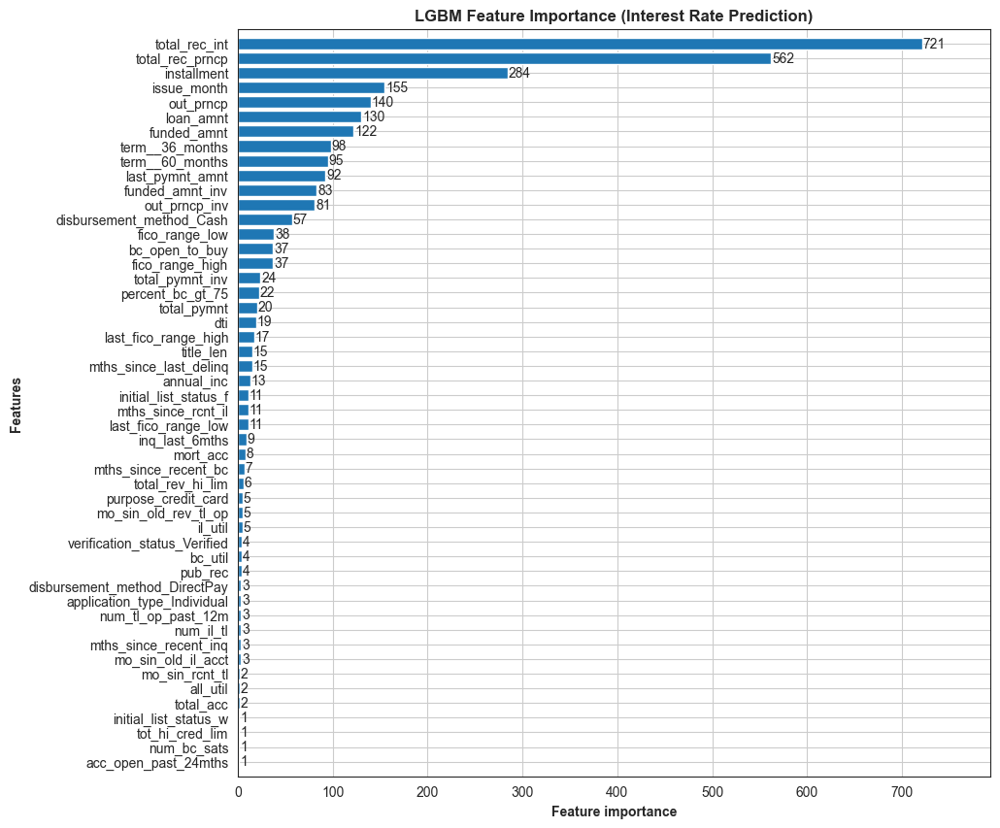

In [24]:
sns.set_style("white")
lgb.plot_importance(
    models_int_rate["LGBM"]["regressor"],
    max_num_features=50,
    figsize=(10, 10),
    height=0.8,
    title="LGBM Feature Importance (Interest Rate Prediction)",
);

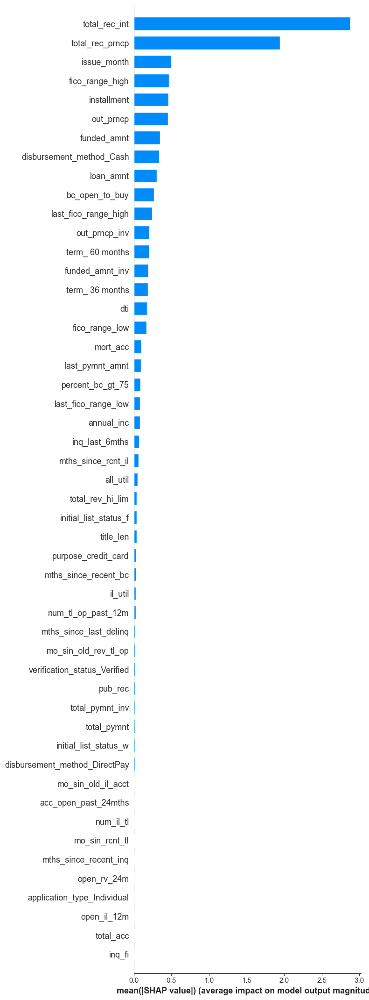

In [34]:
shap.summary_plot(
    shap_values_lgbm_int_rate, data_for_lgbm_int_rate, plot_type="bar", max_display=50
)

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


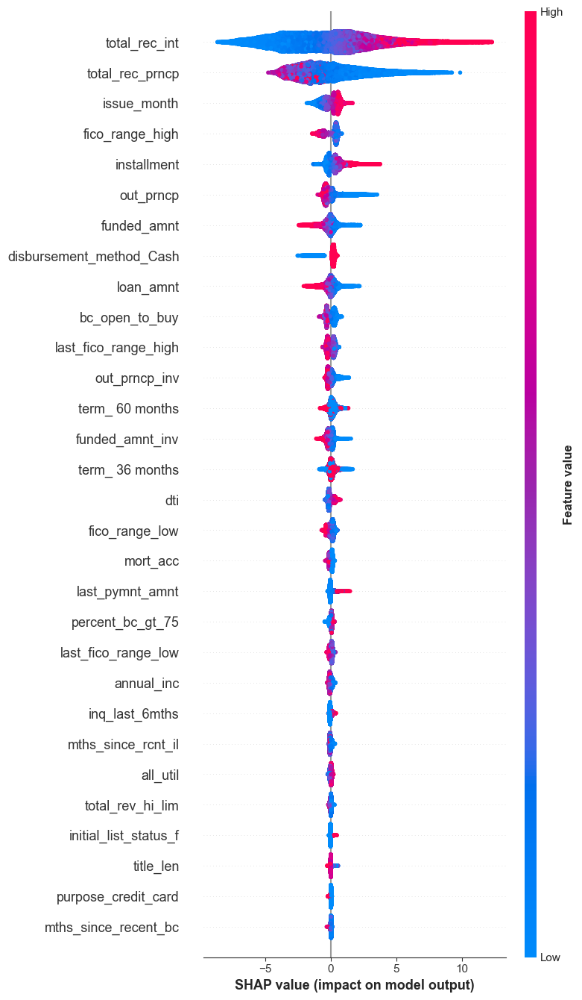

In [35]:
shap.summary_plot(shap_values_lgbm_int_rate, data_for_lgbm_int_rate, max_display=30)

In [41]:
vals_int_rate = np.abs(shap_values_lgbm_int_rate).mean(0)
feature_importance_int_rate = (
    pd.DataFrame(
        list(zip(data_for_lgbm_int_rate.columns, vals_int_rate)),
        columns=["col_name", "importance"],
    )
    .sort_values(by=["importance"], ascending=False)
    .reset_index()
)

In [44]:
feature_importance_int_rate.head(40).style.format(precision=3)

,index,col_name,importance
0,22,total_rec_int,2.881
1,21,total_rec_prncp,1.945
2,82,issue_month,0.501
3,9,fico_range_high,0.468
4,3,installment,0.463
5,17,out_prncp,0.452
6,1,funded_amnt,0.348
7,126,disbursement_method_Cash,0.340
8,0,loan_amnt,0.307
9,49,bc_open_to_buy,0.269


### Re-Train Models on the Most Important Features

The LGBM model was trained on a smaller number of features based on various SHAP value thresholds. Threshold 0.10 resulted in **17 features** which performed best (validation **RMSE = 1.364**, **MAE = 0.850**). 

Please, find the details below.

In [65]:
# Function with the analysis template
def fit_lgbm_int_rate_on_certain_features(features):
    """Template to fit LGBM regression model on certain features."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_trees)),
            ("selector", ColumnSelector(features)),
            (
                "regressor",
                LGBMRegressor(
                    random_state=1,
                    objective="regression",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train, y_train_int_rate)
    return pipeline


def fit_lgbm_int_rate_by_shap(importance_threshold):
    """Function for feature selection based on SHAP values"""
    features = feature_importance_int_rate.query(
        f"importance > {importance_threshold}"
    ).col_name.to_list()

    k = len(features)

    return f"LGBM ({k} features)", fit_lgbm_int_rate_on_certain_features(features)

In [ ]:
for threshold in [0.02, 0.03, 0.05, 0.08, 0.10, 0.30, 0.40, 1.00]:
    model_name, model = fit_lgbm_int_rate_by_shap(threshold)
    models_int_rate[model_name] = model
# Time: 2m 52.0s

In [70]:
print("--- Train ---")
ml.regression_scores(
    models_int_rate,
    X_train,
    y_train_int_rate,
    sort_by="RMSE",
    color="orange",
    incorrect_as_nan=True,
)

--- Train ---


,n,SD,RMSE,MedianAD,MAE,R²,SD_RMSE_ratio,MedianAD_MAE_ratio
LGBM (17 features),346669,5.149,1.333,3.610,0.835,0.933,3.862,4.323
LGBM (22 features),346669,5.149,1.341,3.610,0.846,0.932,3.839,4.269
LGBM (25 features),346669,5.149,1.344,3.610,0.851,0.932,3.831,4.243
LGBM (30 features),346669,5.149,1.362,3.610,0.867,0.930,3.781,4.165
LGBM (34 features),346669,5.149,1.369,3.610,0.872,0.929,3.762,4.140
LGBM,346669,5.149,1.382,3.610,0.881,0.928,3.727,4.096
LGBM (9 features),346669,5.149,1.479,3.610,0.859,0.917,3.481,4.204
LGBM (6 features),346669,5.149,1.595,3.610,0.894,0.904,3.228,4.039
LGBM (2 features),346669,5.149,2.809,3.610,1.826,0.702,1.833,1.977
Ridge Regression,346669,5.149,3.682,3.610,2.811,0.489,1.398,1.284


In [71]:
print("--- Validation ---")
ml.regression_scores(
    models_int_rate,
    X_validation,
    y_validation_int_rate,
    sort_by="RMSE",
    incorrect_as_nan=True,
)

--- Validation ---


,n,SD,RMSE,MedianAD,MAE,R²,SD_RMSE_ratio,MedianAD_MAE_ratio
LGBM (17 features),74286,5.153,1.364,3.610,0.850,0.930,3.778,4.246
LGBM (22 features),74286,5.153,1.371,3.610,0.859,0.929,3.758,4.201
LGBM (25 features),74286,5.153,1.373,3.610,0.865,0.929,3.754,4.173
LGBM (30 features),74286,5.153,1.393,3.610,0.881,0.927,3.700,4.099
LGBM (34 features),74286,5.153,1.402,3.610,0.888,0.926,3.676,4.067
LGBM,74286,5.153,1.416,3.610,0.897,0.925,3.640,4.024
LGBM (9 features),74286,5.153,1.511,3.610,0.868,0.914,3.410,4.159
LGBM (6 features),74286,5.153,1.623,3.610,0.906,0.901,3.174,3.983
LGBM (2 features),74286,5.153,2.819,3.610,1.824,0.701,1.828,1.979
Ridge Regression,74286,5.153,3.692,3.610,2.822,0.487,1.396,1.279


### Evaluation on Test Set

On the **test** set, **RMSE = 1.347** and **MAE = 0.838** (even a bit better than before which might be a consequence that the model was trained on a larger dataset).	

Please, find the details below.

In [75]:
# Model input variables
int_rate_model_input = [
    "total_rec_int",
    "total_rec_prncp",
    "issue_month",
    "fico_range_high",
    "installment",
    "out_prncp",
    "funded_amnt",
    "disbursement_method_Cash",
    "loan_amnt",
    "bc_open_to_buy",
    "last_fico_range_high",
    "out_prncp_inv",
    "term_ 60 months",
    "funded_amnt_inv",
    "term_ 36 months",
    "dti",
    "fico_range_low",
]

In [ ]:
X_train_validation = pd.concat([X_train, X_validation], axis="index")
y_train_validation_int_rate = pd.concat(
    [y_train_int_rate, y_validation_int_rate], axis="index"
)


@my.cache_results(dir_interim + "models_4_03_lgbm--final-evaluation.pickle")
def fit_lgbm_int_rate_final_evaluation():
    """Fit a LGBM model for final testing."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor", clone(pre_processing_trees)),
            ("selector", ColumnSelector(int_rate_model_input)),
            (
                "regressor",
                LGBMRegressor(
                    random_state=1,
                    objective="regression",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )
    pipeline.fit(X_train_validation, y_train_validation_int_rate)
    return pipeline


model_int_rate_final = {}
model_int_rate_final["LGBM (final evaluation)"] = fit_lgbm_int_rate_final_evaluation()

In [86]:
print("--- Train + Validation ---")
display(
    ml.regression_scores(
        model_int_rate_final,
        X_train_validation,
        y_train_validation_int_rate,
        sort_by="RMSE",
        color="orange",
    )
)


--- Train + Validation ---


,n,SD,RMSE,MedianAD,MAE,R²,SD_RMSE_ratio,MedianAD_MAE_ratio
LGBM (final evaluation),420955,5.151,1.332,3.610,0.831,0.933,3.868,4.346


In [87]:
print("--- Test ---")
display(
    ml.regression_scores(model_int_rate_final, X_test, y_test_int_rate, sort_by="RMSE")
)

--- Test ---


,n,SD,RMSE,MedianAD,MAE,R²,SD_RMSE_ratio,MedianAD_MAE_ratio
LGBM (final evaluation),74287,5.152,1.347,3.610,0.838,0.932,3.825,4.307


### Final Model for Deployment

In this section, the final pre-processing and prediction pipeline will be created and trained on the whole dataset. The model will be saved into a pickle file and deployed on Google Cloud Platform (GCP).

In [82]:
# Pipeline input variables
int_rate_pipeline_input = [
    "total_rec_int",
    "total_rec_prncp",
    "issue_d",
    "fico_range_high",
    "installment",
    "out_prncp",
    "funded_amnt",
    "disbursement_method",
    "loan_amnt",
    "bc_open_to_buy",
    "last_fico_range_high",
    "out_prncp_inv",
    "term",
    "funded_amnt_inv",
    "dti",
    "fico_range_low",
]


@my.cache_results(dir_interim + "04--model_predict_int_rate.pkl")
def fit_lgbm_int_rate_for_deployment():
    """Final LGBM model for sub-grades prediction."""
    pipeline = Pipeline(
        steps=[
            ("selector_1", ColumnSelector(int_rate_pipeline_input)),
            ("preprocessor_1", PreprocessorForInterestRates()),
            ("preprocessor_2", clone(pre_processing_trees)),
            ("selector_2", ColumnSelector(int_rate_model_input)),
            (
                "regressor",
                LGBMRegressor(
                    random_state=1,
                    objective="regression",
                    n_jobs=-1,
                    device="gpu",
                    verbosity=1,
                ),
            ),
        ]
    )

    # Load required dataset
    data_file_path = dir_interim + "task-2--1-accepted_loans_2018--raw.feather"
    accepted_2018 = pd.read_feather(data_file_path)

    pipeline.set_output(transform="pandas")
    pipeline.fit(accepted_2018, accepted_2018["int_rate"])
    return pipeline


# Fit the model
loan_int_rate_predictor_final = fit_lgbm_int_rate_for_deployment()
loan_int_rate_predictor_final

Pipeline(steps=[('selector_1',
                 ColumnSelector(keep=['total_rec_int', 'total_rec_prncp',
                                      'issue_d', 'fico_range_high',
                                      'installment', 'out_prncp', 'funded_amnt',
                                      'disbursement_method', 'loan_amnt',
                                      'bc_open_to_buy', 'last_fico_range_high',
                                      'out_prncp_inv', 'term',
                                      'funded_amnt_inv', 'dti',
                                      'fico_range_low'])),
                ('preprocessor_1', PreprocessorForInterestRates()),
                ('prep...
                 ColumnSelector(keep=['total_rec_int', 'total_rec_prncp',
                                      'issue_month', 'fico_range_high',
                                      'installment', 'out_prncp', 'funded_amnt',
                                      'disbursement_method_Cash', 'loan_amnt',
                                      'bc_open_to_buy', 'last_fico_range_high',
                                      'out_prncp_inv', 'term_ 60 months',
                                      'funded_amnt_inv', 'term_ 36 months',
                                      'dti', 'fico_range_low'])),
                ('regressor',
                 LGBMRegressor(device='gpu', n_jobs=-1, objective='regression',
                               random_state=1, verbosity=1))])

# Deployment

Currently, the models are deployed on the Google Cloud Platform (GCP) as a single Flask app that is available at <https://lending-club-app-x6jg32rquq-ew.a.run.app/>. More details and examples on how to use the models are available in the `README` file of the `app` subdirectory of this project's GitHub repository.

# Final Remarks

1) In binary classification, the default threshold of 0.5 was used.  
Threshold adjustment (e.g., via ROC curve analysis) might be beneficial.

1) Hyperparameter tuning was not performed in this analysis due to the lack of time assigned to the task. Models with tuned parameters might lead to better performance. Hope, the Scikit Learn's defaults work well enough.

1) In loan status prediction, for logistic regression and Naive Bayes, capped versions of 'loan_amount' and 'debt_to_income_ratio' were used. And for LGBM, non-capped. It could have been tried to check which type of pre-processing works better instead of making assumptions.

1) Feature selection after initial modeling was based on SHAP values and was done manually. It helped to achieve almost the same or even better performance with significantly fewer features. More rigorous procedures like recursive feature elimination (RFE) might lead to an even better subset of variables.

1) This notebook from time to time started generating underflow issues, especially in some plots and `predict_proba()` method. So the analysis was not performed in one go. (This also leads to the next point.)

1) Many intermediate results were saved to files:
	a) Better and more systematic naming conventions should make it easier to track the results.
	b) Saving so many results on a disc may save time program crashes but needs an excessive amount of space to save the results. If disc space is an issue, some more clever way may be invented to remove older versions of the results that are not needed.
	c) Due to constant saving some parts of code became more dense and, thus, harder to read.

1) In some cases (especially model training) there is a lot of repeated code that could have been generalized. Unfortunately, this would have required much more time.

1) I explored 3 libraries of AutoML. Unfortunately, none of them were included in the analysis:
	- `auto-sklearn` works only on Linux (I used Windows) and has issues with the newest versions of some packages (I cannot remember which ones: `pandas`, `numpy`, `scikit-learn`, or the newest Python itself (I used 3.11).
	- `ludwig` dependencies conflict with the dependencies of `jupyter`;
	- `tplot2` has poor documentation and `tpot` does not support the newest versions of `pandas`. I managed to install it into a separate environment and run some toy examples but decided not to include it in the analysis due lack of available time.

1) Plots:
	- plot themes are not unified throughout the project (the same type of plot might have a different theme). I am not really sure, which functions silently change the themes.
	- some plots may be better labeled.
	- some pots (especially SHAP values) are large and could be made smaller.
	
2) Some results are poorly described or come without explanation. I used them to make decisions for further analysis or inspect whether pre-processing or other steps of analysis were performed as expected.

3) Not all functions from `functions` subfolder were used. They should be treated as a separate module.

1) Models were created and deployed. Unfortunately, I do not have enough field knowledge if the selected variables make sense and do not leak information. A good discussion with a field specialist would be beneficial.